In [3]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
python3 = True

# 0 - Intruduction: usefull actions

The goal of this work is to build model able to predict probability for a client to leave ENEL (Churn)

## 0.1- Import of useful packages and modules

In [51]:
import pandas as pd, os, sys
pd.set_option('max_colwidth', None)
import itertools
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
import seaborn as sns
import sklearn
import time
from pandas.core.common import flatten
import pickle

## 0.2- Environment variables setting

In [5]:
# Setting environment variables
sys.path.insert(0, os.environ["PYLIB"] + "/py4j-0.10.7-src.zip")
sys.path.insert(0, os.environ["PYLIB"] + "/pyspark.zip")
if python3: os.environ['PYSPARK_PYTHON'] = "vsb/CI_conda_env_py3/bin/python"

## 0.2- Spark configuration 

In [6]:
# Importing the Spark Configurator and the Spark Session builder
from pyspark import SparkConf
from pyspark.sql import SparkSession
import pyspark.sql.functions as F
import pyspark.sql.types as types
from pyspark.mllib.stat import Statistics
from pyspark.ml import Pipeline
from pyspark.ml.feature import StringIndexer, OneHotEncoder, VectorAssembler
from pyspark.ml.feature import StandardScaler
from pyspark.ml.classification import GBTClassifier
from pyspark.ml.regression import GBTRegressor

# Stopping the current session if exists
try:
    session.stop()
except:
    print()
   
# Setting up the spark configurator  
conf = SparkConf()
conf.set('spark.serializer', "org.apache.spark.serializer.KryoSerializer")       
conf.set('spark.executor.memory', '16g')
conf.set('spark.driver.memory', '16g')
conf.set('spark.executor.cores', '3')
conf.set('spark.driver.cores', '3')
conf.set('spark.dynamicAllocation.enabled', 'true')
conf.set('spark.executor.instances', '4')
conf.set('spark.dynamicAllocation.minExecutors', '4')
conf.set('spark.dynamicAllocation.maxExecutors', '12')
conf.set('spark.executor.memoryOverhead', '8096')
conf.set('spark.driver.memoryOverhead', '8096')
conf.set('spark.driver.maxResultSize', '20g')
conf.set('spark.kryoserializer.buffer.max', '2047')
conf.setAppName('DA_Feature_Selection_Step2_plus_Modeling')
if python3: conf.set("spark.yarn.dist.archives", "/home/anxadvuser/anx_adv_achurn/env_conda_py3.zip#vsb")

# Creating the spark session object
session = SparkSession.builder.config(conf=conf).enableHiveSupport().getOrCreate()

In [7]:
session

# Feature Selection Part 2 + Modeling

In [8]:
train_set_small_medium = session.read.parquet("/bda/anx_adv_achurn/durand/train_set_small_medium_balanced_numeric").cache()
train_set_micro = session.read.parquet("/bda/anx_adv_achurn/durand/train_set_micro_balanced_numeric").cache()

test_set_small_medium = session.read.parquet("/bda/anx_adv_achurn/durand/test_set_small_medium_numeric").cache()
test_set_micro = session.read.parquet("/bda/anx_adv_achurn/durand/test_set_micro_numeric").cache()

In [9]:
train_set_small_medium = train_set_small_medium.na.drop().cache()
train_set_micro = train_set_micro.na.drop().cache()

test_set_small_medium = test_set_small_medium.na.drop().cache()
test_set_micro = test_set_micro.na.drop().cache()

In [47]:
train_set_small_medium.count()

8166530

In [48]:
train_set_micro.count()

10976832

In [49]:
test_set_small_medium.count()

1052729

In [50]:
test_set_micro.count()

4041295

## Subsetting the data

Let's take a small subset(500 000 rows) of the train_set to accelerate the feature selection process

### Small and Medium

In [7]:
# add the column to be used to sample the data
train_set_small_medium_for_sample = train_set_small_medium.withColumn('sample_by_column', 
                                             F.concat(
                                                 F.col('val_t0_year'), 
                                                 F.col('val_t0_month'), 
                                                 F.col('val_churn_2_months')
                                             )
                                            )


# add the column to be used to drop eventual duplicates
train_set_small_medium_for_sample = train_set_small_medium_for_sample.withColumn("row_id", F.monotonically_increasing_id())

In [16]:
fractions = train_set_small_medium_for_sample.select("sample_by_column").distinct().withColumn("fraction", F.lit(0.07)).rdd.collectAsMap()
print(fractions)

{'2019111.0': 0.07, '201910.0': 0.07, '201961.0': 0.07, '201920.0': 0.07, '202030.0': 0.07, '202031.0': 0.07, '201951.0': 0.07, '2019101.0': 0.07, '202021.0': 0.07, '201971.0': 0.07, '202020.0': 0.07, '201960.0': 0.07, '201921.0': 0.07, '201931.0': 0.07, '201990.0': 0.07, '201950.0': 0.07, '201911.0': 0.07, '2019120.0': 0.07, '202010.0': 0.07, '201981.0': 0.07, '201930.0': 0.07, '2019121.0': 0.07, '201941.0': 0.07, '202011.0': 0.07, '2019100.0': 0.07, '201940.0': 0.07, '2019110.0': 0.07, '201970.0': 0.07, '201991.0': 0.07, '201980.0': 0.07}


In [17]:
seed = 10
train_set_subset_small_medium = train_set_small_medium_for_sample.stat.sampleBy("sample_by_column", fractions, seed)
train_set_subset_small_medium = train_set_subset_small_medium.dropDuplicates(['row_id'])

train_set_subset_small_medium = train_set_subset_small_medium.drop('sample_by_column')
train_set_subset_small_medium = train_set_subset_small_medium.drop('row_id')

In [18]:
train_set_subset_small_medium.groupBy('val_t0_year', 'val_t0_month', 'val_churn_2_months').count().orderBy('val_t0_year', 'val_t0_month', 'val_churn_2_months').show()

+-----------+------------+------------------+-----+
|val_t0_year|val_t0_month|val_churn_2_months|count|
+-----------+------------+------------------+-----+
|       2019|           1|               0.0|18438|
|       2019|           1|               1.0|14605|
|       2019|           2|               0.0|18505|
|       2019|           2|               1.0|18774|
|       2019|           3|               0.0|18563|
|       2019|           3|               1.0|19757|
|       2019|           4|               0.0|18843|
|       2019|           4|               1.0|19888|
|       2019|           5|               0.0|18788|
|       2019|           5|               1.0|20202|
|       2019|           6|               0.0|19040|
|       2019|           6|               1.0|20117|
|       2019|           7|               0.0|18908|
|       2019|           7|               1.0|17284|
|       2019|           8|               0.0|19252|
|       2019|           8|               1.0|15788|
|       2019

In [19]:
train_set_subset_small_medium.count()

571548

### Micro

In [20]:
# add the column to be used to sample the data
train_set_micro_for_sample = train_set_micro.withColumn('sample_by_column', 
                                             F.concat(
                                                 F.col('val_t0_year'), 
                                                 F.col('val_t0_month'), 
                                                 F.col('val_churn_2_months')
                                             )
                                            )


# add the column to be used to drop eventual duplicates
train_set_micro_for_sample = train_set_micro_for_sample.withColumn("row_id", F.monotonically_increasing_id())

In [21]:
fractions_micro = train_set_micro_for_sample.select("sample_by_column").distinct().withColumn("fraction", F.lit(0.05)).rdd.collectAsMap()
print(fractions)

{'2019111.0': 0.07, '201910.0': 0.07, '201961.0': 0.07, '201920.0': 0.07, '202030.0': 0.07, '202031.0': 0.07, '201951.0': 0.07, '2019101.0': 0.07, '202021.0': 0.07, '201971.0': 0.07, '202020.0': 0.07, '201960.0': 0.07, '201921.0': 0.07, '201931.0': 0.07, '201990.0': 0.07, '201950.0': 0.07, '201911.0': 0.07, '2019120.0': 0.07, '202010.0': 0.07, '201981.0': 0.07, '201930.0': 0.07, '2019121.0': 0.07, '201941.0': 0.07, '202011.0': 0.07, '2019100.0': 0.07, '201940.0': 0.07, '2019110.0': 0.07, '201970.0': 0.07, '201991.0': 0.07, '201980.0': 0.07}


In [22]:
seed = 10
train_set_subset_micro = train_set_micro_for_sample.stat.sampleBy("sample_by_column", fractions, seed)
train_set_subset_micro = train_set_subset_micro.dropDuplicates(['row_id'])

train_set_subset_micro = train_set_subset_micro.drop('sample_by_column')
train_set_subset_micro = train_set_subset_micro.drop('row_id')

In [23]:
train_set_subset_micro.groupBy('val_t0_year', 'val_t0_month', 'val_churn_2_months').count().orderBy('val_t0_year', 'val_t0_month', 'val_churn_2_months').show()

+-----------+------------+------------------+-----+
|val_t0_year|val_t0_month|val_churn_2_months|count|
+-----------+------------+------------------+-----+
|       2019|           1|               0.0|24462|
|       2019|           1|               1.0|20093|
|       2019|           2|               0.0|24931|
|       2019|           2|               1.0|25051|
|       2019|           3|               0.0|24957|
|       2019|           3|               1.0|25552|
|       2019|           4|               0.0|25147|
|       2019|           4|               1.0|24459|
|       2019|           5|               0.0|25714|
|       2019|           5|               1.0|24838|
|       2019|           6|               0.0|25897|
|       2019|           6|               1.0|26087|
|       2019|           7|               0.0|25817|
|       2019|           7|               1.0|21730|
|       2019|           8|               0.0|26312|
|       2019|           8|               1.0|18945|
|       2019

In [24]:
train_set_subset_micro.count()

768090

In [25]:
#train_set_subset_small_medium.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/train_set_small_medium_balanced_numeric_subset")
#train_set_subset_micro.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/train_set_micro_balanced_numeric_subset")

In [10]:
train_set_subset_small_medium = session.read.parquet("/bda/anx_adv_achurn/durand/train_set_small_medium_balanced_numeric_subset").cache()
train_set_subset_micro = session.read.parquet("/bda/anx_adv_achurn/durand/train_set_micro_balanced_numeric_subset").cache()

Let's make sure that all the features are numeric by checking the data types:

In [29]:
def count_column_types(spark_df):
    """Count number of columns per type"""
    return pd.DataFrame(spark_df.dtypes).groupby(1, as_index=False)[0].agg({'count':'count', 'names': lambda x: " | ".join(set(x))}).rename(columns={1:"type"})

In [30]:
count_column_types(train_set_subset_small_medium)

type  count  \
0   bigint      5   
1   double    324   
2      int    359   
3   string      4   
4  tinyint    114   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [31]:
count_column_types(train_set_subset_micro)

type  count  \
0   bigint      5   
1   double    308   
2      int    365   
3   string      4   
4  tinyint    114   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

Let's now have a look at the training data

In [36]:
train_set_small_medium.limit(10).toPandas().head(10)

,idn_servizio_sk,idn_cliente_sk,fk_cliente_unico,idc_id_key_servizio,idn_sito_sk,sds_segmento_new,idc_id_key_cliente,idc_id_key_contratto,idn_contratto_sk,cdc_pdr,...,xds_tipologia_azione_last_response_marketing_cli_embed7,xds_tipologia_azione_last_response_marketing_cli_embed8,lds_Cluster_Polis_11_gruppi_embed1,lds_Cluster_Polis_11_gruppi_embed2,lds_Cluster_Polis_11_gruppi_embed3,lds_Cluster_Polis_11_gruppi_embed4,lds_Cluster_Polis_11_gruppi_embed5,lds_Cluster_Polis_11_gruppi_embed6,lds_Cluster_Polis_11_gruppi_embed7,lds_Cluster_Polis_11_gruppi_embed8
0,19090080,16303034,11803719,02i0Y0000027frAQAQ,24977158,1,0010Y00000F9XmlQAF,8000Y000001OOuLQAW,11639143,713354122,...,0.178576,-0.586467,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
1,1489225,16841674,7685998,02i0Y000000v8FPQAY,20389089,2,0010Y00000FNG0BQAX,8000Y000001Oj3WQAS,11716592,669510226,...,0.141655,-0.557136,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
2,8485982,16303034,11803719,02i0Y000001Om9cQAC,25971230,1,0010Y00000F9XmlQAF,8000Y000001OOuLQAW,11639143,713354181,...,0.178576,-0.586467,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
3,10543090,16253194,6073810,02i0Y000001XTWpQAO,27246468,1,0010Y00000F8F1wQAF,8000Y000001cg4gQAA,15041124,962943812,...,0.141655,-0.557136,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
4,48095710,17799552,14740798,02i0Y000004tqokQAA,34238160,1,0010Y00000Flwj8QAB,8000Y000002aoOgQAI,28551133,641332543,...,0.178576,-0.586467,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
5,51188131,17387421,12231279,02i0Y00000737uJQAQ,33925722,1,0010Y00000FbQ9lQAF,8000Y0000002TnQQAU,182610,619324774,...,0.141655,-0.557136,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
6,5058566,16303034,11803719,02i0Y000001AHAWQA4,5984605,1,0010Y00000F9XmlQAF,8000Y000001OOuLQAW,11639143,713354105,...,0.178576,-0.586467,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
7,8634948,17564192,11210422,02i0Y000001PP4BQAW,18868626,1,0010Y00000FfrLjQAJ,8000Y000002JF6GQAW,25183533,773233472,...,0.141655,-0.557136,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
8,8831533,16303034,11803719,02i0Y000001QEWFQA4,22795562,1,0010Y00000F9XmlQAF,8000Y000001OOuLQAW,11639143,713354148,...,0.178576,-0.586467,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726
9,8634948,17564192,11210422,02i0Y000001PP4BQAW,18868626,1,0010Y00000FfrLjQAJ,8000Y000002JF6GQAW,25183533,773233472,...,0.141655,-0.557136,0.406897,-0.073667,0.236344,-0.370668,-0.073438,-0.202341,0.173458,-0.605726


In [37]:
train_set_micro.limit(10).toPandas().head(10)

,idn_servizio_sk,idn_cliente_sk,fk_cliente_unico,idc_id_key_servizio,idn_sito_sk,idc_id_key_cliente,idc_id_key_contratto,idn_contratto_sk,cdc_pdr,cdc_cap_nrm,...,xds_tipologia_azione_last_response_marketing_cli_embed7,xds_tipologia_azione_last_response_marketing_cli_embed8,lds_Cluster_Polis_11_gruppi_embed1,lds_Cluster_Polis_11_gruppi_embed2,lds_Cluster_Polis_11_gruppi_embed3,lds_Cluster_Polis_11_gruppi_embed4,lds_Cluster_Polis_11_gruppi_embed5,lds_Cluster_Polis_11_gruppi_embed6,lds_Cluster_Polis_11_gruppi_embed7,lds_Cluster_Polis_11_gruppi_embed8
0,22555412,18079635,4007099,02i0Y000002Q7ZqQAK,23929482,0010Y00000Ft8n9QAB,8000Y000001oaXrQAI,17879205,829695147,150032.0,...,-0.476243,-0.262981,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
1,246563,17245266,14842555,02i0Y000000lyPTQAY,5128583,0010Y00000FXn3aQAD,8000Y000001DnF2QAK,9111674,965689282,123900.0,...,-0.682212,0.145556,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
2,43538290,18879523,13589146,02i0Y0000041drJQAQ,33117213,0010Y00000L9SdfQAF,8000Y000002VvsrQAC,28186868,661253402,186083.0,...,-0.476243,-0.262981,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
3,246563,17245266,14842555,02i0Y000000lyPTQAY,5128583,0010Y00000FXn3aQAD,8000Y000001DnF2QAK,9111674,965689282,123900.0,...,-0.682212,0.145556,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
4,19110602,3897127,1417205,02i0Y0000027lCCQAY,7865855,0010Y00000FLHf7QAH,8000Y000001UUuUQAW,13091984,827837262,173016.0,...,-0.476243,-0.262981,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
5,246563,17245266,14842555,02i0Y000000lyPTQAY,5128583,0010Y00000FXn3aQAD,8000Y000001DnF2QAK,9111674,965689282,123900.0,...,-0.682212,0.145556,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
6,19376323,17758231,1210858,02i0Y0000028tAEQAY,13537154,0010Y00000FksonQAB,8000Y000001ibZsQAI,16453406,636614050,135010.0,...,-0.476243,-0.262981,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
7,246563,17245266,14842555,02i0Y000000lyPTQAY,5128583,0010Y00000FXn3aQAD,8000Y000001DnF2QAK,9111674,965689282,123900.0,...,-0.682212,0.145556,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
8,47781597,18018096,13642539,02i0Y000004s0ckQAA,35633047,0010Y00000FrYv2QAF,8000Y000000p5ZZQAY,3224939,689192808,155010.0,...,-0.476243,-0.262981,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185
9,186194,17245266,14842555,02i0Y000000libMQAQ,23969819,0010Y00000FXn3aQAD,8000Y000001WLEBQA4,13531221,965686089,123900.0,...,-0.682212,0.145556,-0.099928,-0.101647,-0.03786,-0.338208,-0.280882,0.250453,-0.669075,0.01185


In [38]:
print("Number of observations - small and medium: "+ str(train_set_small_medium.count()))
print("Number of features - small and medium: "+ str(len(train_set_small_medium.columns)))

Number of observations - small and medium: 8166530
Number of features - small and medium: 806


In [39]:
print("Number of observations - micro: "+ str(train_set_micro.count()))
print("Number of features - micro: "+ str(len(train_set_micro.columns)))

Number of observations - micro: 10976832
Number of features - micro: 796


## Functions implementation (get_assembled_data, unique selector, missing selector, collinear selector, low importance selector, ...)

In [11]:
"""
Feature selector for Machine Learning Modeling with PySpark. we implemented four selectors:
1. unique selector: identify the single unique features
2. missing selector: identify missing values features with missing threshold
3. collinear selector: identify collinear features with threshold
4. low importance selector: identify low importance features with Gradient Boosting Machine(GBM)
"""


missing_drop = []
unique_drop = []
corr_drop = []
total = None

def dtypes(df_in):
    """
    Generate the data type categories: numerical, categorical, date and unsupported category.
    :param df_in: the input rdd data frame
    :return: data type categories
    >>> test = spark.createDataFrame([
                        ('Joe', 67, 'F', 7000, 'asymptomatic', 286.1, '2019-6-28'),
                        ('Henry', 67, 'M', 8000, 'asymptomatic', 229.2, '2019-6-29'),
                        ('Sam', 37,  'F', 6000, 'nonanginal', 250.3, '2019-6-30'),
                        ('Max', 56, 'M', 9000, 'nontypical', 236.4, '2019-5-28'),
                        ('Mat', 56, 'F', 9000, 'asymptomatic', 254.5, '2019-4-28')],
                        ['Name', 'Age', 'Sex', 'Salary', 'ChestPain', 'Chol', 'CreatDate']
                       )
    >>> test = test.withColumn('CreatDate', F.col('CreatDate').cast('timestamp'))
    >>> from PySparkAudit import dtypes_class
    >>> dtypes_class(test)
    (     feature       DataType
    0       Name     StringType
    1        Age       LongType
    2        Sex     StringType
    3    Salary       LongType
    4  ChestPain     StringType
    5       Chol     DoubleType
    6  CreatDate  TimestampType,
    ['Age', 'Salary', 'Chol'],
    ['Name', 'Sex', 'ChestPain'],
    ['CreatDate'], [])
    """

    # all data types in pyspark (for reference)
    # __all__ = [
    # "DataType", "NullType", "StringType", "BinaryType", "BooleanType", "DateType",
    # "TimestampType", "DecimalType", "DoubleType", "FloatType", "ByteType", "IntegerType",
    # "LongType", "ShortType", "ArrayType", "MapType", "StructField", "StructType"]

    # numerical data types in rdd DataFrame dtypes
    num_types = ['DecimalType', 'DoubleType', 'FloatType', 'ByteType', 'IntegerType', 'LongType', 'ShortType']
    # qualitative data types in rdd DataFrame dtypes
    cat_types = ['NullType', 'StringType', 'BinaryType', 'BooleanType']
    # date data types in rdd DataFrame dtypes
    date_types = ['DateType', 'TimestampType']
    # unsupported data types in rdd DataFrame dtypes
    unsupported_types = ['ArrayType', 'MapType', 'StructField', 'StructType']

    all_fields = [(f.name, str(f.dataType)) for f in df_in.schema.fields]

    all_df = pd.DataFrame(all_fields, columns=['feature', 'DataType'])

    # initialize the memory for the corresponding fields
    num_fields = []
    cat_fields = []
    date_fields = []
    unsupported_fields = []

    [num_fields.append(item[0]) if item[1] in num_types else
     cat_fields.append(item[0]) if item[1] in cat_types else
     date_fields.append(item[0]) if item[1] in date_types else
     unsupported_fields.append(item[0]) for item in all_fields]

    return all_df, num_fields, cat_fields, date_fields, unsupported_fields


def get_encoded_names(df_in, categorical_cols):
    """
    get the encoded dummy variable names
    :param df_in: the input dataframe
    :param categorical_cols: the name list of the categorical columns
    :return: the name list of the encoded dummy variable for categorical columns
    """

    ind_names = [df_in.groupBy(c).count().sort(F.col("count").desc()).select(c).rdd.flatMap(lambda x: x).collect()
                 for c in categorical_cols]

    encodered_name = [categorical_cols[i] + '_' + j for i in range(len(categorical_cols)) for j in ind_names[i]]

    return encodered_name


def get_assembled_data(df_in, index_col=None, categorical_cols=None, continuous_cols=None, label_col=None, dropLast=False):
    """
    Get dummy variables and concat with continuous variables for ml modeling.
    :param df_in: the dataframe
    :param categorical_cols: the name list of the categorical data
    :param continuous_cols:  the name list of the numerical data
    :param label_col:  the name of label column
    :param dropLast:  the flag of drop last column
    :return: encoded dummy variable names and feature matrix
    >>> df = spark.createDataFrame([
                  (0, "a"),
                  (1, "b"),
                  (2, "c"),
                  (3, "a"),
                  (4, "a"),
                  (5, "c")
              ], ["id", "category"])
    >>> index_col = 'id'
    >>> categorical_cols = ['category']
    >>> continuous_cols = []
    >>> label_col = []
    >>> mat = get_assembled_data(df,index_col,categorical_cols,continuous_cols,label_col)
    >>> mat.show()
    >>>
        +---+-------------+
        | id|     features|
        +---+-------------+
        |  0|[1.0,0.0,0.0]|
        |  1|[0.0,0.0,1.0]|
        |  2|[0.0,1.0,0.0]|
        |  3|[1.0,0.0,0.0]|
        |  4|[1.0,0.0,0.0]|
        |  5|[0.0,1.0,0.0]|
        +---+-------------+
    """

    # exclude index col and label col
    excluded = list(flatten([index_col, label_col]))

    if continuous_cols:
        continuous_cols = [col for col in continuous_cols if col not in excluded]
    else:
        continuous_cols = []

    if categorical_cols:
        categorical_cols = [col for col in categorical_cols if col not in excluded]
    else:
        categorical_cols = []

    indexers = [StringIndexer(inputCol=c, outputCol="{0}_indexed".format(c)) for c in categorical_cols]

    # default setting: dropLast=True
    encoders = [OneHotEncoder(inputCol=indexer.getOutputCol(),
                              outputCol="{0}_encoded".format(indexer.getOutputCol()), dropLast=dropLast)
                for indexer in indexers]

    assembler = VectorAssembler(inputCols=continuous_cols + [encoder.getOutputCol() for encoder in encoders],
                                outputCol="assembled_features")
    
    # Standard Scaler: 
    #We use the Standard Scaler to put all the numbers on the same scale, which is standard practice 
    #for machine learning. This takes the observation and subtracts the mean, and then divides that 
    #by the standard deviation.
    
    standardscaler = StandardScaler().setInputCol("assembled_features").setOutputCol("features")
    
    pipeline = Pipeline(stages=indexers + encoders + [assembler] + [standardscaler])

    encodered_col_names = get_encoded_names(df_in, categorical_cols)
    assembled_col_names = continuous_cols + encodered_col_names

    model = pipeline.fit(df_in)
    data = model.transform(df_in)

    if index_col and label_col:
        # for supervised learning
        data = data.withColumn('label', F.col(label_col))
        out_data = data.select(*list(flatten([index_col, 'features', 'label'])))
    elif not index_col and label_col:
        # for supervised learning
        data = data.withColumn('label', F.col(label_col))
        out_data = data.select('features', 'label')
    elif index_col and not label_col:
        # for unsupervised learning
        out_data = data.select(*list(flatten([index_col, 'features'])))
    elif not index_col and not label_col:
        # for unsupervised learning
        out_data = data.select('features')

    return assembled_col_names, out_data


def unique_selector(data, tracking=False):
    """
    Unique selector: identify the single unique features
    :param data: input dataframe
    :param tracking: the flag for displaying CPU time, the default value is False
    :return unique_drop: The name list of the single unique features
    """

    start = time.time()

    nunique = data.agg(*[F.countDistinct(c) for c in data.columns]).rdd.flatMap(lambda x: x).collect()

    unique_drop = list(np.array(data.columns)[np.array(nunique) == 1])

    end = time.time()

    if tracking:
        print('Unique selector took = ' + str(end - start) + ' s')

    return unique_drop


def missing_selector(data, missing_thold=0.6, display=False, tracking=False):
    """
    Missing selector: identify missing values features with missing threshold
    :param data: input dataframe
    :param missing_thold: threshold for missing values percentage
    :param display: the flag for displaying plots, the default value is False
    :param tracking: the flag for displaying CPU time, the default value is False
    :return: The name list of the missing values features above missing threshold
    """

    start = time.time()

    total = data.count()

    rate_missing = [data.filter((F.col(c).isNull()) | (F.trim(F.col(c)) == '')).count() / total
                    for c in data.columns]

    # self.rate_missing = rate_missing
    missing_drop = list(np.array(data.columns)[np.array(rate_missing) > missing_thold])

    end = time.time()

    if tracking:
        print('Missing selector took = ' + str(end - start) + ' s')

    if display:
        plt.figure(figsize=(10, 8))
        sns.distplot(rate_missing, bins=50, kde=False, rug=True, color='blue')
        plt.axvline(missing_thold, color='red', linestyle='--')
        plt.ylabel('Number of the features')
        plt.xlabel('Missing value percentage')
        plt.title('The missing value percentage Histogram')
        plt.show()

    return missing_drop


def corr_selector(data, index_col=None, label_col=None, corr_thold=0.9, method="pearson", rotation=True, display=False, tracking=False, cat_num=2):
    """
    collinear selector: identify collinear features with threshold
    :param data: input dataframe
    :param index_col: the name of the index column and the other columns you want to exclude
    :param label_col: the name of the label column
    :param corr_thold: threshold for collinear scores
    :param method: the method to use for computing correlation, supported: pearson (default), spearman
    :param rotation: the flag of rotate x-ticks
    :param display: the flag for displaying plots, the default value is False
    :param tracking: the flag for displaying CPU time, the default value is False
    :param cat_num: the number of the categorical feature (helping removing binary features)
    :return: The name list of the correlated values features above threshold
    """
    start = time.time()
    
    # numerical data types in rdd DataFrame dtypes
    num_types = ['DecimalType', 'DoubleType', 'FloatType',
                 'ByteType', 'IntegerType', 'LongType', 'ShortType']
    
    num_fields = [f.name for f in data.schema.fields if str(f.dataType) in num_types]
    
    #nunique = data.agg(*[F.countDistinct(c) for c in data.columns]).rdd.flatMap(lambda x: x).collect()
    
    #flag = list(np.array(data.columns)[np.array(nunique) <= cat_num])

    # exclude index and label cols
    if index_col or label_col:
        if not isinstance(index_col, list):
            index_col = [index_col]
        excluded = list(dict.fromkeys(index_col + [label_col]))
    else:
        excluded = []

    num_cols = [col for col in num_fields if col not in excluded]

    if len(num_cols) > 1:
        data = data.select(num_cols).na.drop()
    else:
        print("Only has one numerical feature!!! Don't need correlation selector.")
        exit(0)
    
    # fill nan with 0
    df_in = data.fillna(0)

    # convert the rdd data data frame to dense matrix
    col_names = df_in.columns
    print('Converting the rdd data frame to dense matrix ...')
    features = df_in.rdd.map(lambda row: row[0:])

    # calculate the correlation matrix
    print('Computing the correlation matrix ...')
    corr_mat = Statistics.corr(features, method=method)
    corr = pd.DataFrame(corr_mat)
    corr.index, corr.columns = col_names, col_names

    upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))

    corr_drop = [column for column in upper.columns if any(upper[column].abs() > corr_thold)]

    end = time.time()

    if tracking:
        print('Correlation selector took = ' + str(end - start) + ' s')

    if display and corr_drop:
        dropped = corr[corr_drop]
        fig = plt.figure(figsize=(60, 60))  # Push new figure on stack
        sns_plot = sns.heatmap(dropped, cmap="YlGnBu",
                               xticklabels=dropped.columns.values,
                               yticklabels=corr.columns.values,
                               annot=True, fmt=".1g", linewidths=.25)
        plt.xlabel('Features to Drop', size=20)
        plt.ylabel('All Numerical Features', size=20)
        plt.title("Correlations Above Threshold {}".format(corr_thold), fontsize=20)
        if rotation:
            plt.xticks(rotation=90, fontsize=20)
            sns_plot.set_yticklabels(sns_plot.get_yticklabels(), rotation=0, fontsize=20)
        plt.show()

    return corr_drop, corr


def importance_selector(data, index_col, label_col, task, importance_thold=None, cumulative_thold=0.96, n_train=5, top_n=20, 
                        dropLast=False, display=False, tracking=False):
    """
    importance selector: identify low feature importance features with threshold
    :param data: input dataframe
    :param index_col: the name of the index column and the other columns you want to exclude
    :param label_col: the name of the label column
    :param task: the ensemble model type, supported task "classification" or "regression"
    :param importance_thold: the threshold of the feature importance if missing will be auto calculated by the
           cumulative threshold
    :param cumulative_thold: the threshold of the cumulative feature importance, this will be used to determine
           the importance_thold when importance_thold is missing
    :param missing_thold: threshold for missing values percentage
    :param corr_thold: threshold for collinear scores
    :param method: the method to use for computing correlation, supported: pearson (default), spearman
    :param rotation: the flag of rotate x-ticks
    :param n_train: the numbers of train for average the feature importance
    :param top_n: the numbers for plot top_n highest feature importance
    :param dropLast: the flag of the drop last column during applying the OneHotEncoder
    :param display: the flag for displaying plots, the default value is False
    :param tracking: the flag for displaying CPU time, the default value is False
    :return: The name list of the dropped features with low feature importance
    """

    start = time.time()
    
    data = data.fillna(0)
    data = data.na.fill('null')

    _, continuous_cols, categorical_cols, _, _ = dtypes(data)
    assembled_col_names, assembled_data = get_assembled_data(data, index_col, categorical_cols, continuous_cols, label_col, dropLast)
    
    print('Preparing GBT model ...')
    if task == 'classification':
        #labelIndexer = StringIndexer(inputCol='label', outputCol='label_indexed')
        alg = GBTClassifier(labelCol='label', featuresCol="features", maxIter=50)
        pipeline_model = Pipeline(stages=[alg])
    elif task == 'regression':
        alg = GBTRegressor(labelCol='label',
                           featuresCol="features", maxIter=50)
        pipeline_model = Pipeline(stages=[alg])
    else:
        raise ValueError('Supported task "classification" or "regression"')

    # init feature importance
    feature_importance = np.zeros(len(assembled_col_names))
    
    print('Training GBT model...')
    for _ in range(n_train):
        
        print("Stage "+ str(_)+ " ...")
        (trainingData, _) = assembled_data.randomSplit([0.6, 0.4], seed=None)
        model = pipeline_model.fit(trainingData)

        if task == 'classification':
            importances = model.stages[0].featureImportances
        elif task == 'regression':
            importances = model.stages[0].featureImportances

        feature_importance += [a / n_train for a in importances]

    d = {'feature': assembled_col_names,
         'avg_importance': [a for a in feature_importance]}

    feature_importances = pd.DataFrame(d).sort_values('avg_importance', ascending=False)
    feature_importances['cumulative_importance'] = feature_importances['avg_importance'].cumsum()
    feature_importances = feature_importances.reset_index(drop=True)

    # set a flag to record whether we need plot cumulative importance
    plt_flag = False
    if not importance_thold:
        plt_flag = True # if we use the cumulative importance to determine the importance, we will plot
        importance_thold = feature_importances['avg_importance'][np.max(np.where(
                                     feature_importances['cumulative_importance'] < cumulative_thold))]

    # numerical cols to be dropped (with importance lower than threshold)
    dropped_num = [assembled_col_names[i] for i in range(len(assembled_col_names))
                   if [a < importance_thold for a in feature_importance][i] and assembled_col_names[i] in continuous_cols]
    
    # dummy names with importance higher than threshold
    keeped_dummy = ['_'.join(assembled_col_names[i].split('_')[:-1]) for i in range(len(assembled_col_names))
                    if [a > importance_thold for a in feature_importance][i]
                    and assembled_col_names[i] not in continuous_cols]
    
    # dummy names with importance lower than threshold
    dropped_dummy = ['_'.join(assembled_col_names[i].split('_')[:-1]) for i in range(len(assembled_col_names))
                     if [a <= importance_thold for a in feature_importance][i]
                     and assembled_col_names[i] not in continuous_cols]

    # categorical cols to be dropped (not the dummy names).
    dropped_cat = [a for a in list(dict.fromkeys(dropped_dummy))
                   if (a not in list(dict.fromkeys(keeped_dummy)) and a in categorical_cols)]

    imp_drop = list(dict.fromkeys(dropped_num + dropped_cat))

    end = time.time()

    if tracking:
        print('All importance selector took = ' + str(end - start) + ' s')

    if display:
        if plt_flag:
            # plot the threshold of the cumulative importance
            plt.figure(figsize=(10, 8))
            ax = sns.lineplot(x=range(1, len(feature_importances) + 1), y="cumulative_importance",
                              data=feature_importances, color='blue')

            cat_point = np.max(np.where(feature_importances['cumulative_importance'] < cumulative_thold))
            # plt.axhline(i_thre, ls='--')
            plt.text(cat_point + 5, cumulative_thold, (cat_point, cumulative_thold), color='red')
            plt.axvline(cat_point, color='red', linestyle='--')
            plt.xlabel('Number of the features')
            plt.show()

        # plot top_n feature importance
        plt.figure(figsize=(40, 15))
        plt_data = feature_importances[:top_n]
        ax = sns.barplot(x='avg_importance', y='feature', data=plt_data)
        ax.set_xlabel('avg_importance')
        plt.title("Top {} feature importance ".format(top_n), fontsize=20)
        plt.show()

    return imp_drop, feature_importances

In [46]:
# get_assembled_data test - this function is used to have the data in the correct form to apply any pyspark model
indexCols = ['fk_cliente_unico', 'idn_cliente_sk', 'idc_id_key_cliente', 'idn_servizio_sk', 'idc_id_key_servizio', 'idn_contratto_sk', 'idc_id_key_contratto', 'cdc_pdr']
labelCol = 'val_churn_2_months'

_, continuous_cols_small_medium, categorical_cols_small_medium, _, _ = dtypes(train_set_subset_small_medium)
_, continuous_cols_micro, categorical_cols_micro, _, _ = dtypes(train_set_subset_micro)


assembled_col_names_small_medium, assembled_data_small_medium = get_assembled_data(train_set_subset_small_medium, 
                                                                                   index_col = indexCols, 
                                                                                   categorical_cols = categorical_cols_small_medium,
                                                                                   continuous_cols = continuous_cols_small_medium, 
                                                                                   label_col = labelCol
                                                                                  )
assembled_col_names_micro, assembled_data_micro = get_assembled_data(train_set_subset_micro,
                                                                     index_col = indexCols,
                                                                     categorical_cols = categorical_cols_micro,
                                                                     continuous_cols = continuous_cols_micro, 
                                                                     label_col = labelCol
                                                                    )

print("number of features small medium: ", len(assembled_col_names_small_medium))
print("number of features micro: ", len(assembled_col_names_micro))

number of features small medium:  801
number of features micro:  791


In [47]:
assembled_data_small_medium.show()

+------------------+-------------------+--------------------+---------+--------------------+-----+
|idc_id_key_cliente|idc_id_key_servizio|idc_id_key_contratto|  cdc_pdr|            features|label|
+------------------+-------------------+--------------------+---------+--------------------+-----+
|0010Y00000FmwTcQAJ| 02i0Y000000nSzeQAE|  8000Y000001gTlAQAU|802590246|(801,[0,1,2,3,4,5...|  0.0|
|0010Y00000FZ2xUQAT| 02i0Y000004vKNKQA2|  8000Y000000c1AhQAI|645751192|(801,[0,1,2,3,4,5...|  0.0|
|0010Y00000FAwQnQAL| 02i0Y000001Kk0HQAS|  8000Y000001KYaaQAG|112636804|(801,[0,1,2,3,4,5...|  1.0|
|0010Y00000Z2y8IQAR| 02i0Y000004ut0tQAA|  8000Y000002bP6YQAU|639131352|(801,[0,1,2,3,4,5...|  0.0|
|0010Y00000G0QFmQAN| 02i1n00000PnAKQAA3|  8001n000003DehkAAC|304123078|(801,[0,1,2,3,4,5...|  1.0|
|0010Y00000FgZ4YQAV| 02i0Y0000013OrHQAU|  8000Y000001jaJHQAY|629256768|(801,[0,1,2,3,4,5...|  1.0|
|0010Y00000F8ndCQAR| 02i0Y000002DU4pQAG|  8000Y00000227A8QAI|970417682|(801,[0,1,2,3,4,5...|  1.0|
|0010Y0000

In [48]:
assembled_data_micro.show()

+------------------+-------------------+--------------------+---------+--------------------+-----+
|idc_id_key_cliente|idc_id_key_servizio|idc_id_key_contratto|  cdc_pdr|            features|label|
+------------------+-------------------+--------------------+---------+--------------------+-----+
|0011n00001rGPA9AAO| 02i1n00000R0vSXAAZ|  8001n000005KbZaAAK|307968542|(791,[0,1,2,3,4,5...|  1.0|
|0010Y00000G7oGAQAZ| 02i0Y000003nnG9QAI|  8000Y000001zRmVQAU|680665142|(791,[0,1,2,3,4,5...|  1.0|
|0010Y000018L7INQA0| 02i0Y00000FcyG6QAJ|  8000Y000000nAVpQAM|609306808|(791,[0,1,2,3,4,5...|  0.0|
|0010Y00000FLxZOQA1| 02i0Y000000w6YjQAI|  8000Y000001TZRGQA4|882044425|(791,[0,1,2,3,4,5...|  1.0|
|0010Y00000FqODRQA3| 02i0Y000004rJlfQAE|  8000Y000002eLyQQAU|631680764|(791,[0,1,2,3,4,5...|  0.0|
|0010Y00000OiZQCQA3| 02i0Y000004sog6QAA|  8000Y000002aRQ7QAM|642774876|(791,[0,1,2,3,4,5...|  0.0|
|0010Y00000FSUI1QAP| 02i0Y000001SSQwQAO|  8000Y0000012yPuQAI|709849302|(791,[0,1,2,3,4,5...|  1.0|
|0010Y0000

In [49]:
assembled_data_small_medium = assembled_data_small_medium.cache()
assembled_data_micro = assembled_data_micro.cache()

## Feature selection using previously implemented functions

In [12]:
# These columns were kept because they identify the entity whose churn is to be predicted
indexCols = ['fk_cliente_unico', 'idn_cliente_sk', 'idc_id_key_cliente', 'idn_servizio_sk', 'idc_id_key_servizio', 'idn_contratto_sk', 'idc_id_key_contratto', 'cdc_pdr']
labelCol = 'val_churn_2_months'
task = 'classification'

### Unique Selector

#### Small and Medium

In [52]:
print('unique_selector: returns all columns having only one unique value')
unique_selector_to_be_dropped_cols_small_medium = unique_selector(train_set_subset_small_medium, tracking=True)
print(len(unique_selector_to_be_dropped_cols_small_medium))

unique_selector: returns all columns having only one unique value
Unique selector took = 3524.5168404579163 s
2


In [13]:
unique_selector_to_be_dropped_cols_small_medium = []

In [26]:
unique_selector_to_be_dropped_cols_small_medium

[]

#### Micro

In [ ]:
print('unique_selector: returns all columns having only one unique value')
unique_selector_to_be_dropped_cols_micro = unique_selector(train_set_subset_micro, tracking=True)
print(len(unique_selector_to_be_dropped_cols_micro))

In [14]:
unique_selector_to_be_dropped_cols_micro = []

In [28]:
unique_selector_to_be_dropped_cols_micro

[]

### Missing Selector

#### Small and Medium

missing_selector: returns all columns having missing proportion above a given threshold
Missing selector took = 4128.601825714111 s


<IPython.core.display.Javascript object>


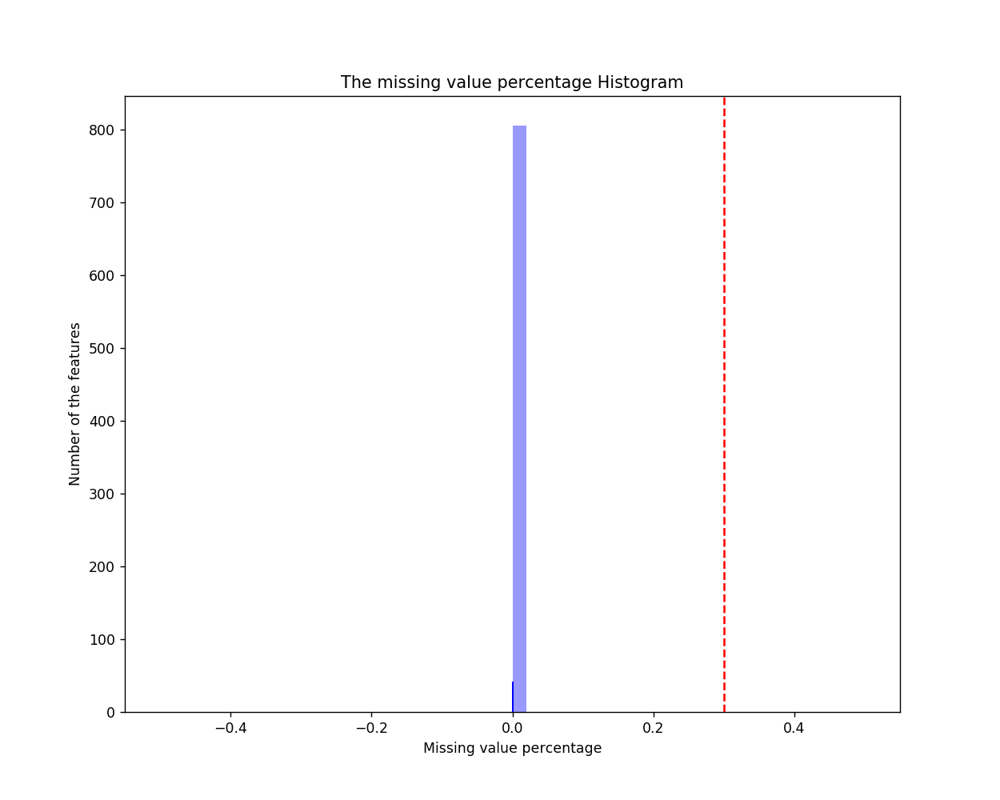

0


In [27]:
print('missing_selector: returns all columns having missing proportion above a given threshold')

train_set_subset_small_medium_missing = train_set_subset_small_medium.drop(*unique_selector_to_be_dropped_cols_small_medium).cache()

missing_selector_to_be_dropped_cols_small_medium = missing_selector(train_set_subset_small_medium_missing, missing_thold=0.5, display=True, tracking=True)
print(len(missing_selector_to_be_dropped_cols_small_medium))

In [15]:
train_set_subset_small_medium_missing = train_set_subset_small_medium.drop(*unique_selector_to_be_dropped_cols_small_medium).cache()
missing_selector_to_be_dropped_cols_small_medium = []

In [30]:
missing_selector_to_be_dropped_cols_small_medium

[]

#### Micro

In [ ]:
print('missing_selector: returns all columns having missing proportion above a given threshold')

train_set_subset_micro_missing = train_set_subset_micro.drop(*unique_selector_to_be_dropped_cols_micro).cache()

missing_selector_to_be_dropped_cols_micro = missing_selector(train_set_subset_micro_missing, missing_thold=0.5, display=True, tracking=True)
print(len(missing_selector_to_be_dropped_cols_micro))

In [16]:
train_set_subset_micro_missing = train_set_subset_micro.drop(*unique_selector_to_be_dropped_cols_micro).cache()
missing_selector_to_be_dropped_cols_micro = []

In [32]:
missing_selector_to_be_dropped_cols_micro

[]

### Importance Selector

#### Small and Medium

importance_selector: returns the columns to be dropped based on GBT feature impotance and a given threshold
Preparing GBT model ...
Training GBT model...
Stage 0 ...
Stage 1 ...
Stage 2 ...
Stage 3 ...
Stage 4 ...
All importance selector took = 1609.4325981140137 s


<IPython.core.display.Javascript object>


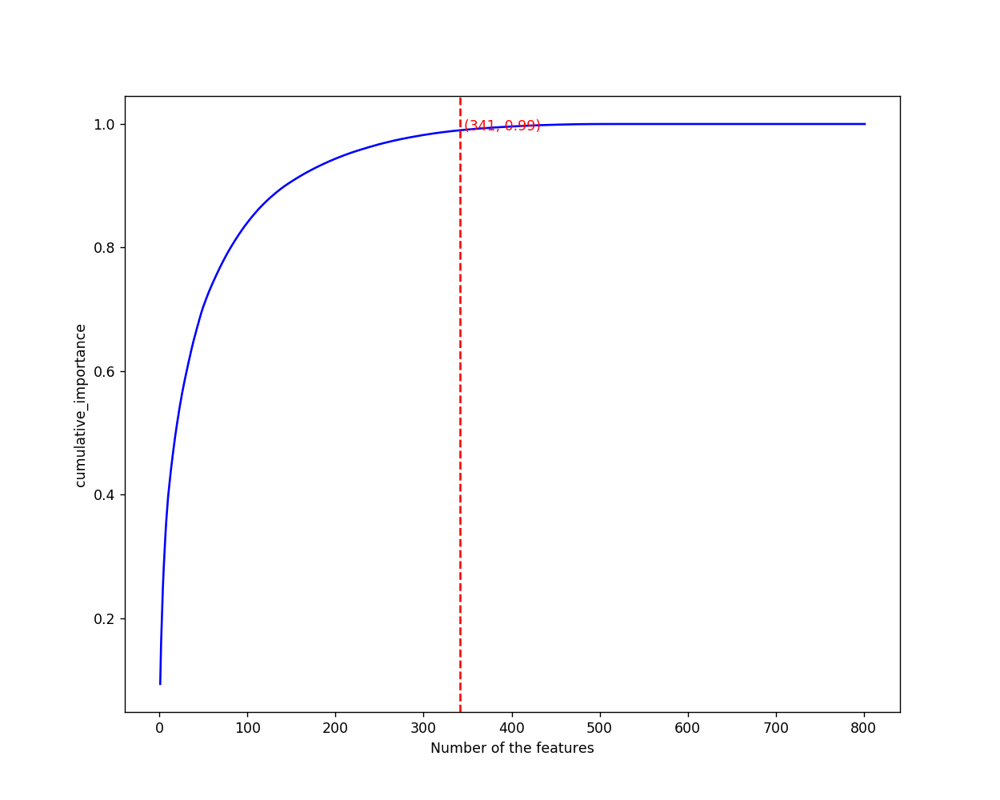

<IPython.core.display.Javascript object>


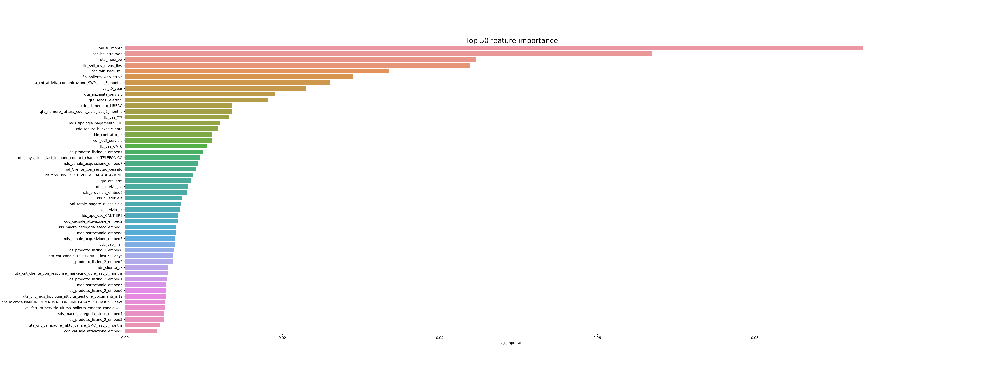

459


In [73]:
# importance threshold is determined by importance_thold or cumulative_thold. If importance_thold is missing then
# the importance_thold will be calculated based on cumulative_thold
print('importance_selector: returns the columns to be dropped based on GBT feature impotance and a given threshold')

train_set_subset_small_medium_importance = train_set_subset_small_medium_missing.drop(*missing_selector_to_be_dropped_cols_small_medium)

importance_selector_to_be_dropped_cols_small_medium, feature_importances_small_medium = importance_selector(train_set_subset_small_medium_importance, 
                                                                                                            index_col=indexCols, label_col=labelCol, 
                                                                                                            task = 'classification', 
                                                                                                            importance_thold=None, 
                                                                                                            cumulative_thold=0.99, 
                                                                                                            n_train=5, 
                                                                                                            top_n=50, 
                                                                                                            dropLast=False, 
                                                                                                            display=True, 
                                                                                                            tracking=True
                                                                                                           )
print(len(importance_selector_to_be_dropped_cols_small_medium))

In [74]:
feature_importances_small_medium

,feature,avg_importance,cumulative_importance
0,val_t0_month,0.093763,0.093763
1,cdc_bolletta_web,0.066940,0.160703
2,qta_mesi_bw,0.044572,0.205275
3,fln_cell_m0_mono_flag,0.043806,0.249081
4,cdc_win_back_m3,0.033529,0.282610
...,...,...,...
796,qta_days_servizio_riallacciato,0.000000,1.000000
797,fln_servizio_distaccato_e_riallacciato,0.000000,1.000000
798,fln_venditore_mercato_libero_gas_comune_BURGO_GROUP,0.000000,1.000000
799,qta_cnt_riallaccio_last_2_months,0.000000,1.000000


In [75]:
feature_importances_spark_df_small_medium = session.createDataFrame(feature_importances_small_medium)

In [76]:
feature_importances_spark_df_small_medium.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/feature_importances_subset_small_medium_GBT")
#feature_importances_spark_df_small_medium = session.read.parquet("/bda/anx_adv_achurn/durand/feature_importances_subset_small_medium_GBT")

In [17]:
train_set_subset_small_medium_importance = train_set_subset_small_medium_missing.drop(*missing_selector_to_be_dropped_cols_small_medium)
importance_selector_to_be_dropped_cols_small_medium = [
 'cdc_residente',
 'val_fascia_contattosita',
 'val_paga_ritardo_min_ciclo_last_6_months',
 'val_paga_ritardo_max_ciclo_last_3_months',
 'val_paga_ritardo_mean_ciclo_last_3_months',
 'val_paga_ritardo_min_ciclo_last_3_months',
 'val_paga_ritardo_sum_ciclo_last_3_months',
 'qta_paga_ritardo_ciclo_last_3_months',
 'val_paga_ritardo_mean_ciclo_last_1_months',
 'val_paga_ritardo_min_ciclo_last_1_months',
 'val_paga_ritardo_sum_ciclo_last_1_months',
 'qta_paga_ritardo_ciclo_last_1_months',
 'fln_player_forte_win_back',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m12',
 'fln_rischio_Baby_Churn',
 'val_perc_Abitazioni_Vuote',
 'val_perc_Altri_Tipi_Alloggio',
 'val_perc_Abitazioni_Non_Residenti',
 'val_perc_Famiglie_Alloggio_Affitto',
 'val_perc_Famiglie_Alloggio_Proprieta',
 'val_perc_Famiglie_2_Componente',
 'val_perc_Famiglie_4_Componente',
 'val_pop_res_totale_15_anni_e_piu_casalinghe',
 'val_consumi_famiglie',
 'val_studenti',
 'cdc_cd_censimento',
 'cdc_Zona_altimetrica',
 'cdc_Comune_Montano',
 'qta_Grado_di_urbanizzazione',
 'qta_numero_fattura_count_ciclo_last_1_months',
 'qta_cnt_mds_specifica_adesione_m1',
 'qta_cnt_mds_specifica_adesione_m3',
 'qta_cnt_mds_specifica_disdetta_m1',
 'qta_cnt_mds_specifica_disdetta_m3',
 'qta_cnt_mds_specifica_disdetta_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m12',
 'qta_cnt_mds_tipologia_attivita_other_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m6',
 'fln_primo_contatto_inbound',
 'fln_criticita_infra_last_90_days',
 'fln_criticita_cross_last_90_days',
 'qta_days_since_last_inbound_contact_channel_APP',
 'qta_days_since_last_inbound_contact_channel_CHAT',
 'qta_days_since_last_inbound_contact_channel_WEB',
 'qta_days_since_last_inbound_contact_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA',
 'qta_days_since_last_inbound_contact_microcausale_PRIMA_ATTIVAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_RIMBORSO_COMPENSAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_CREDITO',
 'qta_days_since_last_inbound_contact_microcausale_DISTACCHI_RIALLACCI',
 'qta_days_since_last_inbound_contact_microcausale_AUTOLETTURA',
 'qta_days_since_last_inbound_contact_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO',
 'qta_days_since_last_inbound_contact_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_RECLAMI_SCRITTI',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_CONSUMI_PAGAMENTI',
 'qta_days_since_last_inbound_contact_microcausale_SWITCH_ATTIVO',
 'qta_days_since_last_inbound_contact_microcausale_MODALITA_DI_PAGAMENTO',
 'qta_days_since_last_inbound_contact_microcausale_ALLACCIO_E_ATTIVAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_NON_DI_COMPETENZA',
 'qta_days_since_last_inbound_contact_microcausale_RVC',
 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_PRIVACY',
 'qta_days_since_last_inbound_contact_macrocausale_Chiarimenti_su_fatture',
 'qta_days_since_last_inbound_contact_macrocausale_Reclami_vendita_Privacy',
 'fln_cliente_response_positiva_last_3_months',
 'qta_cnt_cliente_response_positiva_last_3_months',
 'fln_cliente_response_negativa_last_3_months',
 'qta_cnt_cliente_response_negativa_last_3_months',
 'fln_cliente_con_response_marketing_utile_last_3_months',
 'fln_cliente_response_competitor_last_3_months',
 'qta_cnt_flag_response_competitor_last_3_months',
 'fln_cliente_accetta_proposta_last_3_months',
 'qta_cnt_cliente_accetta_proposta_last_3_months',
 'qta_cnt_campagne_mktg_canale_DEM_last_3_months',
 'qta_cnt_campagne_mktg_tipologia_azione_LOYALTY_last_3_months',
 'val_Residenti',
 'val_Turisti_totali',
 'val_Sh_ENEL_POWER',
 'val_Idx_Commercio',
 'val_Negozi_Compr_Mean',
 'val_Negozi_Loc_Mean',
 'val_POT_TOTALE',
 'val_POT_TOTALE_NETTO',
 'val_consumi_x_mean_ciclo_ele_last_6_months',
 'val_consumi_x_sum_ciclo_ele_last_6_months',
 'val_importo_addebito_x_max_ciclo_ele_last_6_months',
 'val_totale_pagare_x_sum_ciclo_ele_last_6_months',
 'val_totale_pagare_x_mean_ciclo_ele_last_6_months',
 'val_totale_pagare_x_min_ciclo_ele_last_6_months',
 'val_totale_pagare_x_max_ciclo_ele_last_6_months',
 'val_consumi_x_max_over_mean_ciclo_ele_last_6_months',
 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_6_months',
 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_6_months',
 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_6_months',
 'val_consumi_x_max_ciclo_ele_last_3_months',
 'val_totale_pagare_x_sum_ciclo_ele_last_3_months',
 'val_totale_pagare_x_mean_ciclo_ele_last_3_months',
 'val_totale_pagare_x_min_ciclo_ele_last_3_months',
 'val_totale_pagare_x_max_ciclo_ele_last_3_months',
 'val_consumi_x_max_over_mean_ciclo_ele_last_3_months',
 'val_consumi_x_min_over_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_3_months',
 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_3_months',
 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_3_months',
 'val_consumi_x_max_ciclo_ele_last_1_months',
 'val_consumi_x_min_ciclo_ele_last_1_months',
 'val_consumi_x_mean_ciclo_ele_last_1_months',
 'val_consumi_x_sum_ciclo_ele_last_1_months',
 'val_importo_addebito_x_mean_ciclo_ele_last_1_months',
 'val_importo_addebito_x_min_ciclo_ele_last_1_months',
 'val_importo_addebito_x_max_ciclo_ele_last_1_months',
 'val_totale_pagare_x_sum_ciclo_ele_last_1_months',
 'val_totale_pagare_x_mean_ciclo_ele_last_1_months',
 'val_totale_pagare_x_min_ciclo_ele_last_1_months',
 'val_totale_pagare_x_max_ciclo_ele_last_1_months',
 'val_consumi_x_max_over_mean_ciclo_ele_last_1_months',
 'val_consumi_x_min_over_mean_ciclo_ele_last_1_months',
 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_1_months',
 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_1_months',
 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_1_months',
 'val_consumi_x_min_ciclo_gas_last_6_months',
 'val_consumi_x_mean_ciclo_gas_last_6_months',
 'val_consumi_x_sum_ciclo_gas_last_6_months',
 'val_importo_addebito_x_mean_ciclo_gas_last_6_months',
 'val_importo_addebito_x_min_ciclo_gas_last_6_months',
 'val_totale_pagare_x_sum_ciclo_gas_last_6_months',
 'val_totale_pagare_x_mean_ciclo_gas_last_6_months',
 'val_totale_pagare_x_min_ciclo_gas_last_6_months',
 'val_totale_pagare_x_max_ciclo_gas_last_6_months',
 'val_consumi_x_min_over_mean_ciclo_gas_last_6_months',
 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_6_months',
 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_6_months',
 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_6_months',
 'val_consumi_x_max_ciclo_gas_last_3_months',
 'val_consumi_x_min_ciclo_gas_last_3_months',
 'val_consumi_x_mean_ciclo_gas_last_3_months',
 'val_consumi_x_sum_ciclo_gas_last_3_months',
 'val_importo_addebito_x_sum_ciclo_gas_last_3_months',
 'val_importo_addebito_x_mean_ciclo_gas_last_3_months',
 'val_importo_addebito_x_min_ciclo_gas_last_3_months',
 'val_importo_addebito_x_max_ciclo_gas_last_3_months',
 'val_totale_pagare_x_sum_ciclo_gas_last_3_months',
 'val_totale_pagare_x_mean_ciclo_gas_last_3_months',
 'val_totale_pagare_x_min_ciclo_gas_last_3_months',
 'val_totale_pagare_x_max_ciclo_gas_last_3_months',
 'val_consumi_x_max_over_mean_ciclo_gas_last_3_months',
 'val_consumi_x_min_over_mean_ciclo_gas_last_3_months',
 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_3_months',
 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_3_months',
 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_3_months',
 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_3_months',
 'val_consumi_x_max_ciclo_gas_last_1_months',
 'val_consumi_x_min_ciclo_gas_last_1_months',
 'val_consumi_x_mean_ciclo_gas_last_1_months',
 'val_consumi_x_sum_ciclo_gas_last_1_months',
 'val_importo_addebito_x_sum_ciclo_gas_last_1_months',
 'val_importo_addebito_x_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_min_ciclo_gas_last_1_months',
 'val_importo_addebito_x_max_ciclo_gas_last_1_months',
 'val_totale_pagare_x_sum_ciclo_gas_last_1_months',
 'val_totale_pagare_x_mean_ciclo_gas_last_1_months',
 'val_totale_pagare_x_min_ciclo_gas_last_1_months',
 'val_totale_pagare_x_max_ciclo_gas_last_1_months',
 'val_consumi_x_max_over_mean_ciclo_gas_last_1_months',
 'val_consumi_x_min_over_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_1_months',
 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_1_months',
 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_last_ciclo',
 'val_totale_pagare_x_last',
 'val_totale_pagare_x_last_over_mean',
 'qta_cnt_contatti_inbound_all_channel_m1',
 'qta_cnt_contatti_inbound_all_channel_m3',
 'qta_cnt_contatti_inbound_all_channel_m6',
 'qta_cnt_contatti_inbound_all_channel_m9',
 'qta_cnt_contatti_inbound_all_channel_m12',
 'qta_cnt_canale_APP_last_90_days',
 'qta_cnt_canale_CHAT_last_90_days',
 'qta_cnt_canale_DOCUMENTALE_COMPLESSO_last_90_days',
 'qta_cnt_canale_FACE_last_90_days',
 'qta_cnt_canale_WEB_last_90_days',
 'qta_cnt_microcausale_AUTOLETTURA_last_90_days',
 'qta_cnt_microcausale_DISTACCHI_RIALLACCI_last_90_days',
 'qta_cnt_microcausale_GESTIONE_PRIVACY_last_90_days',
 'qta_cnt_microcausale_GESTIONE_VAS_last_90_days',
 'qta_cnt_microcausale_INFORMATIVA_last_90_days',
 'qta_cnt_microcausale_INFORMATIVA_CREDITO_last_90_days',
 'qta_cnt_microcausale_INFORMATIVA_NON_DI_COMPETENZA_last_90_days',
 'qta_cnt_microcausale_LAVORI_E_MODIFICHE_TECNICHE_POTENZA_TENSIONE_last_90_days',
 'qta_cnt_microcausale_MODALITA_DI_PAGAMENTO_last_90_days',
 'qta_cnt_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE_last_90_days',
 'qta_cnt_microcausale_PIANO_DI_RIENTRO_last_90_days',
 'qta_cnt_microcausale_RECLAMI_SCRITTI_last_90_days',
 'qta_cnt_microcausale_REPEATED_LIST_last_90_days',
 'qta_cnt_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE_last_90_days',
 'qta_cnt_microcausale_RIMBORSO_COMPENSAZIONE_last_90_days',
 'qta_cnt_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO_last_90_days',
 'qta_cnt_microcausale_RVC_last_90_days',
 'qta_cnt_microcausale_SWITCH_ATTIVO_last_90_days',
 'qta_cnt_microcausale_VERIFICHE_TECNICHE_last_90_days',
 'qta_cnt_macrocausale_Credito_last_90_days',
 'qta_cnt_macrocausale_Esecuzione_lavori_last_90_days',
 'qta_cnt_macrocausale_Problemi_in_fase_di_attivazione_last_90_days',
 'qta_cnt_macrocausale_Reclami_vendita_Privacy_last_90_days',
 'qta_cnt_macrocausale_Ritardata_esecuzione_subentri_volture_cessazioni_etc_last_90_days',
 'qta_frequenza_contatto',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m9',
 'val_rimborsi_mean_ciclo_last_3_months',
 'qta_cnt_reclami_last_month',
 'qta_cnt_attivita_analisi_fatturato_situazione_contabile_last_3_months',
 'qta_cnt_attivita_autoletture_last_3_months',
 'qta_cnt_attivita_blacklist_last_3_months',
 'qta_cnt_attivita_bye_bye_letter_last_3_months',
 'qta_cnt_attivita_dl_piano_casa_last_3_months',
 'qta_cnt_attivita_invio_WL_pesante_last_3_months',
 'qta_cnt_attivita_modifiche_variazioni_last_3_months',
 'qta_cnt_attivita_morosita_last_3_months',
 'qta_cnt_attivita_pagamenti_metodi_pagamento_last_3_months',
 'qta_cnt_attivita_recesso_suggello_voltura_mancata_ritardata_last_3_months',
 'qta_cnt_attivita_ripensamento_last_3_months',
 'qta_cnt_attivita_secondo_livello_last_3_months',
 'qta_cnt_attivita_sollecito_last_3_months',
 'qta_cnt_attivita_vocal_last_3_months',
 'fln_scarti_trasporto_last_1_months',
 'fln_scarti_sap_sd_last_1_months',
 'fln_scarti_sempre_sap_last_1_months',
 'fln_scarti_sdd_rid_last_1_months',
 'qta_days_diff_diffida_fattura_cli',
 'val_totale_pagare_last_diffida_cli',
 'val_totale_pagare_last_sollecito_cli',
 'qta_cnt_solleciti_livello_01_cli',
 'qta_cnt_sms_cli',
 'qta_cnt_mail_di_sollecito_cli',
 'qta_cnt_diffida_procedura_M1_cli',
 'qta_cnt_sollecito_cartaceo_cli',
 'qta_cnt_diffida_procedura_M3_cli',
 'fln_sollecito_last_2_months_cli',
 'qta_cnt_sollecito_procedura_M2_cli',
 'qta_cnt_sollecito_procedura_M1_cli',
 'qta_cnt_diffida_procedura_M4_cli',
 'qta_cnt_sollecito_procedura_M0_cli',
 'qta_cnt_diffida_procedura_M2_cli',
 'fln_diffida_last_2_months_cli',
 'qta_cnt_diffida_cartacea_cli',
 'qta_cnt_diffide_livello_02_cli',
 'qta_cnt_diffida_cartacea_serv',
 'fln_diffida_last_2_months_serv',
 'fln_sollecito_last_2_months_serv',
 'fln_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL',
 'fln_fattura_non_pagata_servizio_last_6_months_canale_ALL',
 'val_mean_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL',
 'fln_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL',
 'fln_fattura_pagata_totalmente_nei_tempi_servizio_last_6_months_canale_ALL',
 'qta_cnt_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL',
 'val_max_val_fattura_non_pagato_servizio_last_6_months_canale_ALL',
 'val_mean_val_fattura_non_pagato_servizio_last_6_months_canale_ALL',
 'val_max_val_fattura_non_pagato_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL',
 'val_mean_val_fattura_non_pagato_servizio_last_3_months_canale_ALL',
 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL',
 'qta_cnt_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL',
 'fln_venditore_mercato_libero_gas_comune_METANO_NORD_SPA',
 'fln_stesso_venditore_distributore_gas',
 'fln_venditore_mercato_libero_gas_comune_EVOLVE_SRL',
 'fln_venditore_mercato_libero_gas_comune_BURGO_GROUP',
 'fln_venditore_mercato_libero_gas_comune_Gruppo_Canarbino',
 'fln_venditore_mercato_libero_gas_comune_Dolomiti_Energia',
 'fln_distributore_gas_comune_Italgas',
 'fln_distributore_gas_comune_2i_Rete_Gas_SpA',
 'fln_venditore_mercato_libero_gas_comune_AIMAG',
 'fln_venditore_mercato_libero_ele_comune_Gas_Rimini',
 'fln_venditore_mercato_libero_gas_comune_Unogas',
 'fln_distributore_energia_big',
 'fln_distributore_energia_comune_A2A',
 'fln_distributore_energia_comune_ASTEA_SPA',
 'fln_distributore_energia_comune_Acea',
 'fln_distributore_energia_comune_Alperia',
 'fln_distributore_energia_comune_Dolomiti_Energia',
 'fln_distributore_energia_comune_ENEL',
 'fln_distributore_energia_comune_HERA',
 'fln_distributore_energia_comune_IREN',
 'fln_distributore_energia_comune_municipalizzata',
 'fln_distributore_energia_enel',
 'fln_distributore_gas_big',
 'fln_distributore_gas_comune_A2A',
 'fln_distributore_gas_comune_Alperia',
 'fln_distributore_gas_comune_Dolomiti_Energia',
 'fln_distributore_gas_comune_EDISON',
 'fln_distributore_gas_comune_HERA',
 'fln_distributore_gas_comune_IREN',
 'fln_distributore_gas_comune_municipalizzata',
 'fln_multi_distributore_energia_comune',
 'fln_multi_distributore_gas_comune',
 'fln_multi_venditori_mercato_libero_ele_comune',
 'fln_multi_venditori_mercato_libero_gas_comune',
 'fln_stesso_distributore_gas_ele',
 'fln_stesso_venditore_distributore_ele',
 'fln_stesso_venditore_distributore_ele_no_enel',
 'fln_venditore_mercato_libero_ele_big',
 'fln_venditore_mercato_libero_ele_comune_Acea',
 'fln_venditore_mercato_libero_ele_comune_Alperia',
 'fln_venditore_mercato_libero_ele_comune_Axpo_Group',
 'fln_venditore_mercato_libero_ele_comune_Dolomiti_Energia',
 'fln_venditore_mercato_libero_ele_comune_EDISON',
 'fln_venditore_mercato_libero_ele_comune_ENEL',
 'fln_venditore_mercato_libero_ele_comune_ENGIE',
 'fln_venditore_mercato_libero_ele_comune_ENI',
 'fln_venditore_mercato_libero_ele_comune_EOn',
 'fln_venditore_mercato_libero_ele_comune_Gruppo_Canarbino',
 'fln_venditore_mercato_libero_ele_comune_HERA',
 'fln_venditore_mercato_libero_ele_comune_sorgenia',
 'fln_venditore_mercato_libero_ele_enel',
 'fln_venditore_mercato_libero_ele_only_small',
 'fln_venditore_mercato_libero_gas_big',
 'fln_venditore_mercato_libero_gas_comune_A2A',
 'fln_venditore_mercato_libero_gas_comune_Alperia',
 'fln_venditore_mercato_libero_gas_comune_Axpo_Group',
 'fln_venditore_mercato_libero_gas_comune_EDISON',
 'fln_venditore_mercato_libero_gas_comune_ENEGAN',
 'fln_venditore_mercato_libero_gas_comune_ENEL',
 'fln_venditore_mercato_libero_gas_comune_ENGIE',
 'fln_venditore_mercato_libero_gas_comune_EOn',
 'fln_venditore_mercato_libero_gas_comune_Green_Network',
 'fln_venditore_mercato_libero_gas_comune_IREN',
 'fln_venditore_mercato_libero_gas_enel',
 'fln_venditore_mercato_libero_gas_only_small',
 'qta_cnt_comuni_serviti_distributore_energia',
 'qta_cnt_distributori_energia_comune',
 'qta_cnt_distributori_gas_comune',
 'val_Cliente_con_servizio_cessato_last_3_months',
 'val_Cliente_con_comunicazione_swp_storico_last_1_months',
 'val_Cliente_con_comunicazione_swp_storico_last_3_months',
 'val_Cliente_con_comunicazione_swp_storico_last_6_months',
 'qta_cnt_fln_contatti_inbound_guasti_m1',
 'qta_cnt_fln_contatti_inbound_autolet_m1',
 'qta_cnt_fln_contatti_inbound_m1',
 'qta_cnt_fln_chiamate_inbound_m1',
 'qta_cnt_fln_contatti_inbound_guasti_m3',
 'qta_cnt_fln_contatti_inbound_autolet_m3',
 'qta_cnt_fln_chiamate_inbound_m3',
 'qta_cnt_fln_contatti_inbound_guasti_m6',
 'qta_cnt_fln_contatti_inbound_autolet_m6',
 'qta_cnt_fln_chiamate_inbound_m6',
 'qta_cnt_fln_contatti_inbound_reclamo_m9',
 'qta_cnt_fln_contatti_inbound_guasti_m9',
 'qta_cnt_fln_contatti_inbound_autolet_m9',
 'qta_cnt_fln_chiamate_inbound_m9',
 'qta_cnt_fln_contatti_inbound_guasti_m12',
 'qta_cnt_fln_contatti_inbound_autolet_m12',
 'qta_cnt_fln_chiamate_inbound_m12',
 'fln_distacco_last_2_months',
 'qta_cnt_distacchi_last_2_months',
 'fln_riallaccio_last_2_months',
 'qta_cnt_riallaccio_last_2_months',
 'fln_servizio_attualmente_distaccato',
 'fln_servizio_distaccato_e_riallacciato',
 'qta_days_servizio_riallacciato',
 'fln_comunicazione_rinnovo_last_1_months',
 'fln_comunicazione_rinnovo_last_1_months_sottocanale_CARTACEO',
 'fln_comunicazione_rinnovo_last_1_months_sottocanale_FATTURA',
 'fln_comunicazione_rinnovo_last_1_months_sottocanale_PEC',
 'fln_rinnovo_last_1_months',
 'fln_rinnovo_last_1_months_tipologia_ADEGUAMENTO',
 'fln_rinnovo_last_1_months_tipologia_RVC',
 'val_delta_prezzo_ele_last_1_months',
 'val_delta_prezzo_gas_last_1_months',
 'val_delta_prezzo_percentuale_ele_last_1_months',
 'val_delta_prezzo_percentuale_gas_last_1_months',
 'fln_fattura_non_pagata_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_fattura_pagata_non_totalmente_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_fattura_pagata_totalmente_in_ritardo_servizio_ultima_bolletta_emessa_canale_ALL',
 'val_fattura_non_pagato_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_dual',
 'lds_tipo_uso_***',
 'lds_tipo_uso_USO_DOMESTICO',
 'lds_tipo_uso_STRAORDINARIA',
 'mds_tipologia_pagamento_MULTIPLO',
 'mds_tipologia_pagamento_WEB',
 'mds_tipologia_pagamento_BONIFICO',
 'cdc_id_mercato_***',
 'cdc_id_mercato_SALVAGUARDIA',
 'cdc_id_mercato_VINCOLATO',
 'sds_mat_fatturazione_NORD_OVEST',
 'sds_mat_fatturazione_***',
 'sds_mat_fatturazione_NORD_EST',
 'sds_mat_fatturazione_CENTRO',
 'sds_mat_NORD_OVEST',
 'sds_mat_SUD',
 'sds_mat_NORD_EST',
 'sds_mat_CENTRO',
 'lds_societa_vendita_SORGENIA_SPA',
 'lds_societa_vendita_ENI_GAS_&_POWER_SPA',
 'flc_vas_CAT2',
 'flc_vas_CAT1',
 'mds_land_type_***',
 'mds_land_type_RURAL',
 'mds_land_type_URBAN',
 'mds_land_type_METRO',
 'cdc_cluster_fattura_last_ADJ_STORNO',
 'cdc_cluster_fattura_last_OTHER',
 'xds_tipo_azione_campagna_last_response_marketing_cli_INFORMATIVA',
 'xds_tipo_azione_campagna_last_response_marketing_cli_PROMOZIONE',
 'lds_RETE_GAS_***',
 'lds_RETE_GAS_IR',
 'lds_RETE_GAS_IR/FR',
 'lds_RETE_GAS_FR',
 'sds_macro_categoria_ateco_embed6',
 'sds_provincia_fatturazione_embed1',
 'sds_provincia_fatturazione_embed7',
 'sds_regione_fatturazione_embed4',
 'sds_regione_fatturazione_embed7',
 'sds_regione_fatturazione_embed8',
 'sds_provincia_embed4',
 'lds_comune_fornitura_embed1',
 'mds_nome_campagna_last_response_marketing_cli_embed4',
 'mds_nome_campagna_last_response_marketing_cli_embed8',
 'xds_canale_last_response_marketing_cli_embed2',
 'xds_canale_last_response_marketing_cli_embed3',
 'xds_canale_last_response_marketing_cli_embed4',
 'xds_canale_last_response_marketing_cli_embed6',
 'xds_canale_last_response_marketing_cli_embed7',
 'xds_canale_last_response_marketing_cli_embed8',
 'xds_tipologia_azione_last_response_marketing_cli_embed1',
 'xds_tipologia_azione_last_response_marketing_cli_embed2',
 'xds_tipologia_azione_last_response_marketing_cli_embed3',
 'xds_tipologia_azione_last_response_marketing_cli_embed4',
 'xds_tipologia_azione_last_response_marketing_cli_embed5',
 'xds_tipologia_azione_last_response_marketing_cli_embed6',
 'lds_Cluster_Polis_11_gruppi_embed1',
 'lds_Cluster_Polis_11_gruppi_embed2',
 'lds_Cluster_Polis_11_gruppi_embed3',
 'lds_Cluster_Polis_11_gruppi_embed4',
 'lds_Cluster_Polis_11_gruppi_embed5',
 'lds_Cluster_Polis_11_gruppi_embed6',
 'lds_Cluster_Polis_11_gruppi_embed7',
 'lds_Cluster_Polis_11_gruppi_embed8'
]

In [34]:
importance_selector_to_be_dropped_cols_small_medium

['cdc_residente',
 'val_fascia_contattosita',
 'val_paga_ritardo_min_ciclo_last_6_months',
 'val_paga_ritardo_max_ciclo_last_3_months',
 'val_paga_ritardo_mean_ciclo_last_3_months',
 'val_paga_ritardo_min_ciclo_last_3_months',
 'val_paga_ritardo_sum_ciclo_last_3_months',
 'qta_paga_ritardo_ciclo_last_3_months',
 'val_paga_ritardo_mean_ciclo_last_1_months',
 'val_paga_ritardo_min_ciclo_last_1_months',
 'val_paga_ritardo_sum_ciclo_last_1_months',
 'qta_paga_ritardo_ciclo_last_1_months',
 'fln_player_forte_win_back',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m12',
 'fln_rischio_Baby_Churn',
 'val_perc_Abitazioni_Vuote',
 'val_perc_Altri_Tipi_Alloggio',
 'val_perc_Abitazioni_Non_Residenti',
 'val_perc_Famiglie_Alloggio_Affitto',
 'val_perc_Famiglie_Alloggi

#### Micro

importance_selector: returns the columns to be dropped based on GBT feature impotance and a given threshold
Preparing GBT model ...
Training GBT model...
Stage 0 ...
Stage 1 ...
Stage 2 ...
Stage 3 ...
Stage 4 ...
All importance selector took = 1744.608111858368 s


<IPython.core.display.Javascript object>


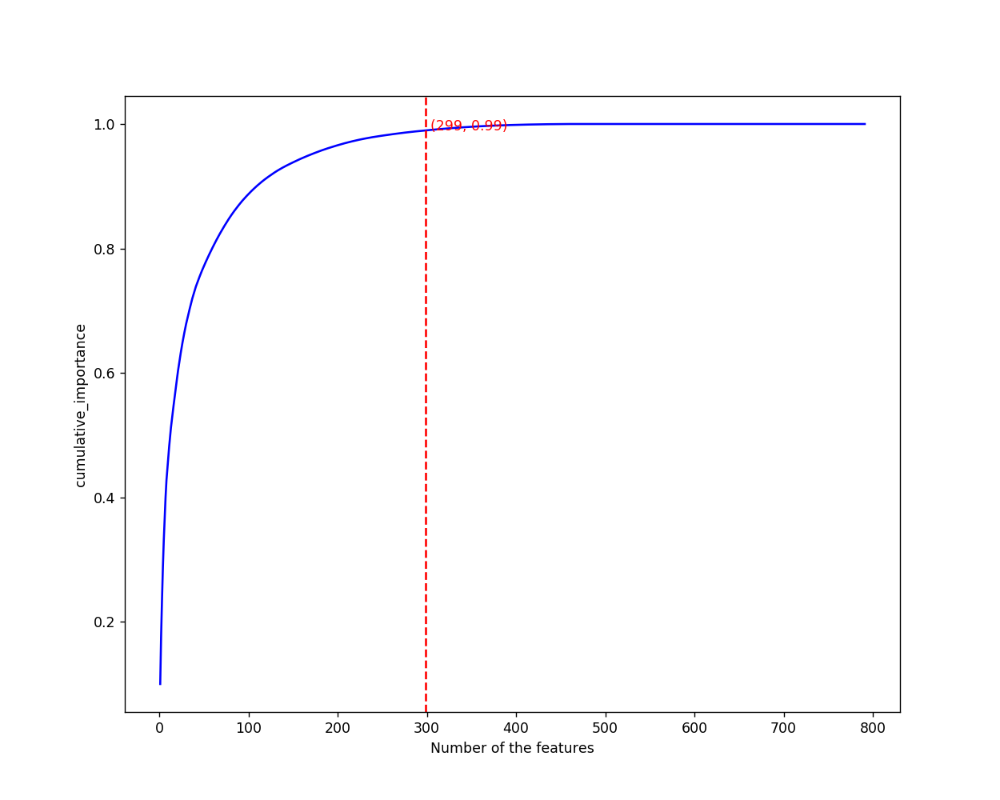

<IPython.core.display.Javascript object>


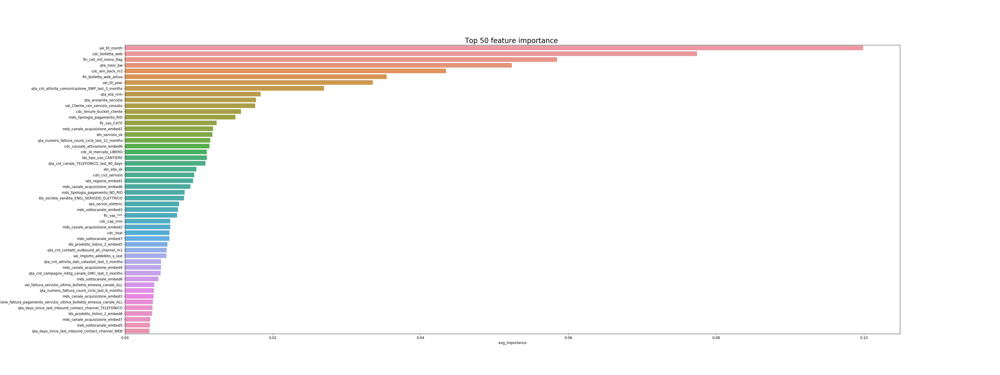

491


In [81]:
# importance threshold is determined by importance_thold or cumulative_thold. If importance_thold is missing then
# the importance_thold will be calculated based on cumulative_thold
print('importance_selector: returns the columns to be dropped based on GBT feature impotance and a given threshold')

train_set_subset_micro_importance = train_set_subset_micro_missing.drop(*missing_selector_to_be_dropped_cols_micro)

importance_selector_to_be_dropped_cols_micro, feature_importances_micro = importance_selector(train_set_subset_micro_importance, 
                                                                                                index_col=indexCols, label_col=labelCol, 
                                                                                                task = 'classification', 
                                                                                                importance_thold=None, 
                                                                                                cumulative_thold=0.99, 
                                                                                                n_train=5, 
                                                                                                top_n=50, 
                                                                                                dropLast=False, 
                                                                                                display=True, 
                                                                                                tracking=True
                                                                                               )
print(len(importance_selector_to_be_dropped_cols_micro))

In [82]:
feature_importances_micro

,feature,avg_importance,cumulative_importance
0,val_t0_month,0.099879,0.099879
1,cdc_bolletta_web,0.077404,0.177283
2,fln_cell_m0_mono_flag,0.058459,0.235742
3,qta_mesi_bw,0.052337,0.288079
4,cdc_win_back_m3,0.043445,0.331524
...,...,...,...
786,fln_distributore_energia_comune_ENEL,0.000000,1.000000
787,fln_distributore_energia_comune_Dolomiti_Energia,0.000000,1.000000
788,fln_distributore_energia_comune_Alperia,0.000000,1.000000
789,fln_distributore_energia_comune_Acea,0.000000,1.000000


In [86]:
feature_importances_spark_df_micro = session.createDataFrame(feature_importances_micro)

In [87]:
feature_importances_spark_df_micro.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/feature_importances_subset_micro_GBT")
#feature_importances_spark_df_micro = session.read.parquet("/bda/anx_adv_achurn/durand/feature_importances_subset_micro_GBT")

In [18]:
train_set_subset_micro_importance = train_set_subset_micro_missing.drop(*missing_selector_to_be_dropped_cols_micro)
importance_selector_to_be_dropped_cols_micro = ['cdc_residente',
 'val_fascia_contattosita',
 'val_paga_ritardo_max_ciclo_last_6_months',
 'val_paga_ritardo_mean_ciclo_last_6_months',
 'val_paga_ritardo_min_ciclo_last_6_months',
 'val_paga_ritardo_sum_ciclo_last_6_months',
 'qta_paga_ritardo_ciclo_last_6_months',
 'val_paga_ritardo_max_ciclo_last_3_months',
 'val_paga_ritardo_mean_ciclo_last_3_months',
 'val_paga_ritardo_min_ciclo_last_3_months',
 'val_paga_ritardo_sum_ciclo_last_3_months',
 'qta_paga_ritardo_ciclo_last_3_months',
 'val_paga_ritardo_max_ciclo_last_1_months',
 'val_paga_ritardo_mean_ciclo_last_1_months',
 'val_paga_ritardo_min_ciclo_last_1_months',
 'val_paga_ritardo_sum_ciclo_last_1_months',
 'qta_paga_ritardo_ciclo_last_1_months',
 'fln_player_forte_win_back',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m12',
 'fln_rischio_Baby_Churn',
 'val_perc_Abitazioni_Residenti',
 'val_perc_Abitazioni_Vuote',
 'val_perc_Altri_Tipi_Alloggio',
 'val_perc_Abitazioni_Non_Residenti',
 'val_perc_Famiglie_Alloggio_Proprieta',
 'val_perc_Famiglie_5_Componente',
 'val_pop_res_totale',
 'val_pop_res_totale_che_si_sposta_giornalmente_nel_comune_dimora_abituale',
 'cdc_cd_censimento',
 'sds_cluster_ele',
 'qta_giorni_ultimo_contatto_inbound',
 'qta_giorni_ultimo_reclamo',
 'qta_numero_fattura_count_ciclo_last_1_months',
 'qta_cnt_mds_specifica_adesione_m1',
 'qta_cnt_mds_specifica_adesione_m3',
 'qta_cnt_mds_specifica_adesione_m6',
 'qta_cnt_mds_specifica_adesione_m12',
 'qta_cnt_mds_specifica_disdetta_m1',
 'qta_cnt_mds_specifica_disdetta_m3',
 'qta_cnt_mds_specifica_disdetta_m6',
 'qta_cnt_mds_specifica_disdetta_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m12',
 'fln_primo_contatto_inbound',
 'fln_criticita_infra_last_90_days',
 'fln_criticita_cross_last_90_days',
 'qta_days_since_last_inbound_contact_channel_APP',
 'qta_days_since_last_inbound_contact_channel_CHAT',
 'qta_days_since_last_inbound_contact_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA',
 'qta_days_since_last_inbound_contact_microcausale_PRIMA_ATTIVAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_RIMBORSO_COMPENSAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_LAVORI_E_MODIFICHE_TECNICHE_POTENZA_TENSIONE',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_CREDITO',
 'qta_days_since_last_inbound_contact_microcausale_DISTACCHI_RIALLACCI',
 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_VAS',
 'qta_days_since_last_inbound_contact_microcausale_AUTOLETTURA',
 'qta_days_since_last_inbound_contact_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO',
 'qta_days_since_last_inbound_contact_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_RECLAMI_SCRITTI',
 'qta_days_since_last_inbound_contact_microcausale_REPEATED_LIST',
 'qta_days_since_last_inbound_contact_microcausale_SWITCH_ATTIVO',
 'qta_days_since_last_inbound_contact_microcausale_MODALITA_DI_PAGAMENTO',
 'qta_days_since_last_inbound_contact_microcausale_ALLACCIO_E_ATTIVAZIONE',
 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_NON_DI_COMPETENZA',
 'qta_days_since_last_inbound_contact_microcausale_RVC',
 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_PRIVACY',
 'qta_days_since_last_inbound_contact_microcausale_PIANO_DI_RIENTRO',
 'qta_days_since_last_inbound_contact_microcausale_SUBENTRO',
 'qta_days_since_last_inbound_contact_macrocausale_Esecuzione_lavori',
 'qta_days_since_last_inbound_contact_macrocausale_Informativa',
 'qta_days_since_last_inbound_contact_macrocausale_Problemi_in_fase_di_attivazione',
 'qta_days_since_last_inbound_contact_macrocausale_Reclami_vendita_Privacy',
 'qta_cnt_cliente_response_positiva_last_3_months',
 'fln_cliente_response_negativa_last_3_months',
 'qta_cnt_cliente_response_negativa_last_3_months',
 'fln_cliente_con_response_marketing_utile_last_3_months',
 'fln_cliente_response_competitor_last_3_months',
 'qta_cnt_flag_response_competitor_last_3_months',
 'fln_cliente_accetta_proposta_last_3_months',
 'qta_cnt_cliente_accetta_proposta_last_3_months',
 'qta_cnt_campagne_mktg_tipo_azione_campagna_PROMOZIONE_last_3_months',
 'qta_cnt_campagne_mktg_tipologia_azione_LOYALTY_last_3_months',
 'val_Residenti',
 'val_Lavoratori',
 'val_Turisti_totali',
 'val_QUOTA_TUTELATO',
 'val_POT_GAS_NETTO',
 'val_QUOTA_LIBERO',
 'val_Negozi_Loc_Mean',
 'val_POT_POWER_NETTO',
 'val_POT_TOTALE',
 'val_consumi_x_mean_ciclo_ele_last_6_months',
 'val_consumi_x_sum_ciclo_ele_last_6_months',
 'val_importo_addebito_x_mean_ciclo_ele_last_6_months',
 'val_importo_addebito_x_min_ciclo_ele_last_6_months',
 'val_totale_pagare_x_sum_ciclo_ele_last_6_months',
 'val_totale_pagare_x_mean_ciclo_ele_last_6_months',
 'val_totale_pagare_x_min_ciclo_ele_last_6_months',
 'val_totale_pagare_x_max_ciclo_ele_last_6_months',
 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_6_months',
 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_6_months',
 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_6_months',
 'val_consumi_x_max_ciclo_ele_last_3_months',
 'val_consumi_x_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_min_ciclo_ele_last_3_months',
 'val_importo_addebito_x_max_ciclo_ele_last_3_months',
 'val_totale_pagare_x_sum_ciclo_ele_last_3_months',
 'val_totale_pagare_x_mean_ciclo_ele_last_3_months',
 'val_totale_pagare_x_min_ciclo_ele_last_3_months',
 'val_totale_pagare_x_max_ciclo_ele_last_3_months',
 'val_consumi_x_max_over_mean_ciclo_ele_last_3_months',
 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_3_months',
 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_3_months',
 'val_consumi_x_max_ciclo_ele_last_1_months',
 'val_consumi_x_min_ciclo_ele_last_1_months',
 'val_consumi_x_mean_ciclo_ele_last_1_months',
 'val_consumi_x_sum_ciclo_ele_last_1_months',
 'val_importo_addebito_x_sum_ciclo_ele_last_1_months',
 'val_importo_addebito_x_mean_ciclo_ele_last_1_months',
 'val_importo_addebito_x_min_ciclo_ele_last_1_months',
 'val_importo_addebito_x_max_ciclo_ele_last_1_months',
 'val_totale_pagare_x_sum_ciclo_ele_last_1_months',
 'val_totale_pagare_x_mean_ciclo_ele_last_1_months',
 'val_totale_pagare_x_min_ciclo_ele_last_1_months',
 'val_totale_pagare_x_max_ciclo_ele_last_1_months',
 'val_consumi_x_max_over_mean_ciclo_ele_last_1_months',
 'val_consumi_x_min_over_mean_ciclo_ele_last_1_months',
 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_1_months',
 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_1_months',
 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_1_months',
 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_1_months',
 'val_consumi_x_max_ciclo_gas_last_6_months',
 'val_consumi_x_min_ciclo_gas_last_6_months',
 'val_consumi_x_mean_ciclo_gas_last_6_months',
 'val_consumi_x_sum_ciclo_gas_last_6_months',
 'val_importo_addebito_x_mean_ciclo_gas_last_6_months',
 'val_importo_addebito_x_min_ciclo_gas_last_6_months',
 'val_totale_pagare_x_sum_ciclo_gas_last_6_months',
 'val_totale_pagare_x_mean_ciclo_gas_last_6_months',
 'val_totale_pagare_x_min_ciclo_gas_last_6_months',
 'val_totale_pagare_x_max_ciclo_gas_last_6_months',
 'val_consumi_x_max_over_mean_ciclo_gas_last_6_months',
 'val_consumi_x_min_over_mean_ciclo_gas_last_6_months',
 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_6_months',
 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_6_months',
 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_6_months',
 'val_consumi_x_max_ciclo_gas_last_3_months',
 'val_consumi_x_min_ciclo_gas_last_3_months',
 'val_consumi_x_mean_ciclo_gas_last_3_months',
 'val_consumi_x_sum_ciclo_gas_last_3_months',
 'val_importo_addebito_x_sum_ciclo_gas_last_3_months',
 'val_importo_addebito_x_mean_ciclo_gas_last_3_months',
 'val_importo_addebito_x_min_ciclo_gas_last_3_months',
 'val_importo_addebito_x_max_ciclo_gas_last_3_months',
 'val_totale_pagare_x_sum_ciclo_gas_last_3_months',
 'val_totale_pagare_x_mean_ciclo_gas_last_3_months',
 'val_totale_pagare_x_min_ciclo_gas_last_3_months',
 'val_totale_pagare_x_max_ciclo_gas_last_3_months',
 'val_consumi_x_max_over_mean_ciclo_gas_last_3_months',
 'val_consumi_x_min_over_mean_ciclo_gas_last_3_months',
 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_3_months',
 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_3_months',
 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_3_months',
 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_3_months',
 'val_consumi_x_max_ciclo_gas_last_1_months',
 'val_consumi_x_min_ciclo_gas_last_1_months',
 'val_consumi_x_mean_ciclo_gas_last_1_months',
 'val_consumi_x_sum_ciclo_gas_last_1_months',
 'val_importo_addebito_x_sum_ciclo_gas_last_1_months',
 'val_importo_addebito_x_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_min_ciclo_gas_last_1_months',
 'val_importo_addebito_x_max_ciclo_gas_last_1_months',
 'val_totale_pagare_x_sum_ciclo_gas_last_1_months',
 'val_totale_pagare_x_mean_ciclo_gas_last_1_months',
 'val_totale_pagare_x_min_ciclo_gas_last_1_months',
 'val_totale_pagare_x_max_ciclo_gas_last_1_months',
 'val_consumi_x_max_over_mean_ciclo_gas_last_1_months',
 'val_consumi_x_min_over_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_1_months',
 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_1_months',
 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_1_months',
 'val_importo_addebito_x_last_ciclo',
 'val_totale_pagare_x_last',
 'qta_cnt_contatti_inbound_all_channel_m1',
 'qta_cnt_contatti_inbound_all_channel_m3',
 'qta_cnt_contatti_inbound_all_channel_m6',
 'qta_cnt_contatti_inbound_all_channel_m9',
 'qta_cnt_contatti_inbound_all_channel_m12',
 'qta_cnt_canale_CHAT_last_90_days',
 'qta_cnt_canale_DOCUMENTALE_last_90_days',
 'qta_cnt_canale_DOCUMENTALE_COMPLESSO_last_90_days',
 'qta_cnt_canale_WEB_last_90_days',
 'qta_cnt_microcausale_AUTOLETTURA_last_90_days',
 'qta_cnt_microcausale_DISDETTE_E_CESSAZIONI_last_90_days',
 'qta_cnt_microcausale_DISTACCHI_RIALLACCI_last_90_days',
 'qta_cnt_microcausale_GESTIONE_FORNITURA_last_90_days',
 'qta_cnt_microcausale_GESTIONE_PRIVACY_last_90_days',
 'qta_cnt_microcausale_GESTIONE_VAS_last_90_days',
 'qta_cnt_microcausale_INFORMATIVA_last_90_days',
 'qta_cnt_microcausale_INFORMATIVA_NON_DI_COMPETENZA_last_90_days',
 'qta_cnt_microcausale_LAVORI_E_MODIFICHE_TECNICHE_POTENZA_TENSIONE_last_90_days',
 'qta_cnt_microcausale_MODALITA_DI_PAGAMENTO_last_90_days',
 'qta_cnt_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE_last_90_days',
 'qta_cnt_microcausale_PRIMA_ATTIVAZIONE_last_90_days',
 'qta_cnt_microcausale_RECLAMI_SCRITTI_last_90_days',
 'qta_cnt_microcausale_REPEATED_LIST_last_90_days',
 'qta_cnt_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE_last_90_days',
 'qta_cnt_microcausale_RIMBORSO_COMPENSAZIONE_last_90_days',
 'qta_cnt_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO_last_90_days',
 'qta_cnt_microcausale_RVC_last_90_days',
 'qta_cnt_microcausale_SWITCH_ATTIVO_last_90_days',
 'qta_cnt_microcausale_VERIFICHE_TECNICHE_last_90_days',
 'qta_cnt_macrocausale_Chiarimenti_su_fatture_last_90_days',
 'qta_cnt_macrocausale_Esecuzione_lavori_last_90_days',
 'qta_cnt_macrocausale_Informativa_last_90_days',
 'qta_cnt_macrocausale_Problemi_in_fase_di_attivazione_last_90_days',
 'qta_cnt_macrocausale_Reclami_vendita_Privacy_last_90_days',
 'qta_frequenza_contatto',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_credito_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m12',
 'val_rimborsi_mean_ciclo_last_3_months',
 'qta_cnt_reclami_last_month',
 'qta_cnt_attivita_analisi_fatturato_situazione_contabile_last_3_months',
 'qta_cnt_attivita_autoletture_last_3_months',
 'qta_cnt_attivita_blacklist_last_3_months',
 'qta_cnt_attivita_bye_bye_letter_last_3_months',
 'qta_cnt_attivita_dl_piano_casa_last_3_months',
 'qta_cnt_attivita_delibera_147_last_3_months',
 'qta_cnt_attivita_fattura_mancata_ritardata_last_3_months',
 'qta_cnt_attivita_indennizzo_last_3_months',
 'qta_cnt_attivita_invio_WL_pesante_last_3_months',
 'qta_cnt_attivita_morosita_last_3_months',
 'qta_cnt_attivita_recesso_suggello_voltura_mancata_ritardata_last_3_months',
 'qta_cnt_attivita_ripensamento_last_3_months',
 'qta_cnt_attivita_secondo_livello_last_3_months',
 'qta_cnt_attivita_sito_web_chat_last_3_months',
 'qta_cnt_attivita_sollecito_last_3_months',
 'qta_cnt_attivita_telefonate_gestione_credito_last_3_months',
 'qta_cnt_attivita_vas_last_3_months',
 'qta_cnt_attivita_vocal_last_3_months',
 'fln_scarti_trasporto_last_1_months',
 'fln_scarti_sap_sd_last_1_months',
 'fln_scarti_sempre_sap_last_1_months',
 'fln_scarti_sdd_rid_last_1_months',
 'qta_cnt_solleciti_livello_01_cli',
 'qta_cnt_sms_cli',
 'qta_cnt_diffida_procedura_M1_cli',
 'qta_cnt_sollecito_cartaceo_cli',
 'qta_cnt_diffida_procedura_M3_cli',
 'fln_sollecito_last_2_months_cli',
 'qta_cnt_sollecito_procedura_M2_cli',
 'qta_cnt_diffida_procedura_M4_cli',
 'qta_cnt_sollecito_procedura_M0_cli',
 'qta_cnt_diffida_procedura_M2_cli',
 'qta_cnt_diffida_cartacea_cli',
 'qta_cnt_diffida_cartacea_serv',
 'fln_diffida_last_2_months_serv',
 'val_mean_days_scadenza_fattura_pagamento_servizio_last_6_months_canale_ALL',
 'val_mean_fattura_non_pagata_servizio_last_6_months_canale_ALL',
 'fln_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL',
 'fln_fattura_non_pagata_servizio_last_6_months_canale_ALL',
 'val_mean_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL',
 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL',
 'fln_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL',
 'fln_fattura_pagata_totalmente_nei_tempi_servizio_last_6_months_canale_ALL',
 'qta_cnt_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL',
 'val_max_val_fattura_non_pagato_servizio_last_6_months_canale_ALL',
 'val_mean_val_fattura_non_pagato_servizio_last_6_months_canale_ALL',
 'val_max_val_fattura_non_pagato_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_pagata_totalmente_in_ritardo_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL',
 'val_mean_val_fattura_non_pagato_servizio_last_3_months_canale_ALL',
 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL',
 'qta_cnt_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL',
 'fln_venditore_mercato_libero_gas_comune_METANO_NORD_SPA',
 'fln_venditore_mercato_libero_gas_comune_EVOLVE_SRL',
 'fln_venditore_mercato_libero_gas_comune_BURGO_GROUP',
 'fln_venditore_mercato_libero_gas_comune_Gruppo_Canarbino',
 'fln_venditore_mercato_libero_gas_comune_Dolomiti_Energia',
 'fln_distributore_gas_comune_Italgas',
 'fln_distributore_gas_comune_2i_Rete_Gas_SpA',
 'fln_venditore_mercato_libero_gas_comune_AIMAG',
 'fln_venditore_mercato_libero_ele_comune_Gas_Rimini',
 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_ele',
 'fln_distributore_energia_big',
 'fln_distributore_energia_comune_A2A',
 'fln_distributore_energia_comune_ASTEA_SPA',
 'fln_distributore_energia_comune_Acea',
 'fln_distributore_energia_comune_Alperia',
 'fln_distributore_energia_comune_Dolomiti_Energia',
 'fln_distributore_energia_comune_ENEL',
 'fln_distributore_energia_comune_HERA',
 'fln_distributore_energia_comune_IREN',
 'fln_distributore_energia_comune_municipalizzata',
 'fln_distributore_energia_enel',
 'fln_distributore_gas_big',
 'fln_distributore_gas_comune_A2A',
 'fln_distributore_gas_comune_Alperia',
 'fln_distributore_gas_comune_Dolomiti_Energia',
 'fln_distributore_gas_comune_EDISON',
 'fln_distributore_gas_comune_HERA',
 'fln_distributore_gas_comune_IREN',
 'fln_distributore_gas_comune_municipalizzata',
 'fln_multi_distributore_energia_comune',
 'fln_multi_venditori_mercato_libero_gas_comune',
 'fln_stesso_distributore_gas_ele',
 'fln_stesso_venditore_distributore_ele',
 'fln_stesso_venditore_distributore_ele_no_enel',
 'fln_venditore_mercato_libero_ele_big',
 'fln_venditore_mercato_libero_ele_comune_A2A',
 'fln_venditore_mercato_libero_ele_comune_Acea',
 'fln_venditore_mercato_libero_ele_comune_Axpo_Group',
 'fln_venditore_mercato_libero_ele_comune_Dolomiti_Energia',
 'fln_venditore_mercato_libero_ele_comune_EDISON',
 'fln_venditore_mercato_libero_ele_comune_ENEGAN',
 'fln_venditore_mercato_libero_ele_comune_ENEL',
 'fln_venditore_mercato_libero_ele_comune_ENGIE',
 'fln_venditore_mercato_libero_ele_comune_ENI',
 'fln_venditore_mercato_libero_ele_comune_EOn',
 'fln_venditore_mercato_libero_ele_comune_Gruppo_Canarbino',
 'fln_venditore_mercato_libero_ele_comune_IREN',
 'fln_venditore_mercato_libero_ele_comune_Unogas',
 'fln_venditore_mercato_libero_ele_comune_sorgenia',
 'fln_venditore_mercato_libero_ele_enel',
 'fln_venditore_mercato_libero_ele_only_small',
 'fln_venditore_mercato_libero_gas_big',
 'fln_venditore_mercato_libero_gas_comune_A2A',
 'fln_venditore_mercato_libero_gas_comune_Acea',
 'fln_venditore_mercato_libero_gas_comune_Alperia',
 'fln_venditore_mercato_libero_gas_comune_Axpo_Group',
 'fln_venditore_mercato_libero_gas_comune_EDISON',
 'fln_venditore_mercato_libero_gas_comune_ENEL',
 'fln_venditore_mercato_libero_gas_comune_ENGIE',
 'fln_venditore_mercato_libero_gas_comune_ENI',
 'fln_venditore_mercato_libero_gas_comune_EOn',
 'fln_venditore_mercato_libero_gas_comune_Green_Network',
 'fln_venditore_mercato_libero_gas_comune_IREN',
 'fln_venditore_mercato_libero_gas_enel',
 'fln_venditore_mercato_libero_gas_only_small',
 'qta_cnt_comuni_serviti_distributore_energia',
 'qta_cnt_distributori_energia_comune',
 'qta_cnt_distributori_gas_comune',
 'val_Cliente_con_servizio_cessato_last_3_months',
 'val_Cliente_con_servizio_cessato_last_6_months',
 'val_Cliente_con_comunicazione_swp_storico_last_1_months',
 'val_Cliente_con_comunicazione_swp_storico_last_3_months',
 'qta_cnt_fln_contatti_inbound_reclamo_m1',
 'qta_cnt_fln_contatti_inbound_guasti_m1',
 'qta_cnt_fln_contatti_inbound_autolet_m1',
 'qta_cnt_fln_contatti_inbound_m1',
 'qta_cnt_fln_chiamate_inbound_m1',
 'qta_cnt_fln_contatti_inbound_guasti_m3',
 'qta_cnt_fln_contatti_inbound_autolet_m3',
 'qta_cnt_fln_contatti_inbound_m3',
 'qta_cnt_fln_chiamate_inbound_m3',
 'qta_cnt_fln_contatti_inbound_guasti_m6',
 'qta_cnt_fln_contatti_inbound_autolet_m6',
 'qta_cnt_fln_chiamate_inbound_m6',
 'qta_cnt_fln_contatti_inbound_reclamo_m9',
 'qta_cnt_fln_contatti_inbound_guasti_m9',
 'qta_cnt_fln_contatti_inbound_autolet_m9',
 'qta_cnt_fln_contatti_inbound_m9',
 'qta_cnt_fln_chiamate_inbound_m9',
 'qta_cnt_fln_contatti_inbound_guasti_m12',
 'qta_cnt_fln_contatti_inbound_autolet_m12',
 'qta_cnt_fln_contatti_inbound_m12',
 'qta_cnt_fln_chiamate_inbound_m12',
 'cdc_tenure_bucket',
 'fln_distacco_last_2_months',
 'qta_cnt_distacchi_last_2_months',
 'fln_riallaccio_last_2_months',
 'qta_cnt_riallaccio_last_2_months',
 'fln_servizio_attualmente_distaccato',
 'fln_servizio_distaccato_e_riallacciato',
 'qta_days_servizio_riallacciato',
 'fln_comunicazione_rinnovo_last_1_months',
 'fln_comunicazione_rinnovo_last_1_months_sottocanale_CARTACEO',
 'fln_comunicazione_rinnovo_last_1_months_sottocanale_FATTURA',
 'fln_comunicazione_rinnovo_last_1_months_sottocanale_PEC',
 'fln_rinnovo_last_1_months',
 'fln_rinnovo_last_1_months_tipologia_ADEGUAMENTO',
 'fln_rinnovo_last_1_months_tipologia_RVC',
 'val_delta_prezzo_ele_last_1_months',
 'val_delta_prezzo_gas_last_1_months',
 'val_delta_prezzo_percentuale_ele_last_1_months',
 'fln_fattura_non_pagata_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_fattura_pagata_non_totalmente_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_fattura_pagata_totalmente_in_ritardo_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_fattura_pagata_totalmente_nei_tempi_servizio_ultima_bolletta_emessa_canale_ALL',
 'val_fattura_non_pagato_servizio_ultima_bolletta_emessa_canale_ALL',
 'fln_dual',
 'lds_tipo_uso_***',
 'lds_tipo_uso_USO_NON_ABITATIVO',
 'lds_tipo_uso_USO_DOMESTICO',
 'lds_tipo_uso_STRAORDINARIA',
 'lds_tipo_uso_ETAB1I00C1',
 'lds_tipo_uso_INDUSTRIALE',
 'lds_tipo_uso_ILLUMINAZIONE_PUBBLICA',
 'lds_tipo_uso_CIVILE',
 'lds_tipo_uso_ARTIGIANALE',
 'lds_tipo_uso_USO_SERVIZIO_ABITATIVO',
 'mds_tipologia_pagamento_NON_DEFINTO',
 'mds_tipologia_pagamento_WEB',
 'mds_tipologia_pagamento_BONIFICO',
 'cdc_id_mercato_***',
 'cdc_id_mercato_SALVAGUARDIA',
 'sds_mat_fatturazione_NORD_OVEST',
 'sds_mat_fatturazione_***',
 'sds_mat_fatturazione_SUD',
 'sds_mat_fatturazione_NORD_EST',
 'sds_mat_fatturazione_CENTRO',
 'sds_mat_NORD_OVEST',
 'sds_mat_SUD',
 'sds_mat_NORD_EST',
 'sds_mat_CENTRO',
 'lds_societa_vendita_SORGENIA_SPA',
 'lds_societa_vendita_ENI_GAS_&_POWER_SPA',
 'lds_societa_vendita_Altro',
 'flc_vas_CAT2',
 'flc_vas_CAT1',
 'mds_land_type_***',
 'mds_land_type_RURAL',
 'mds_land_type_URBAN',
 'mds_land_type_METRO',
 'cdc_cluster_fattura_last_CICLO',
 'cdc_cluster_fattura_last_ADJ_STORNO',
 'cdc_cluster_fattura_last_OTHER',
 'xds_tipo_azione_campagna_last_response_marketing_cli_INFORMATIVA',
 'xds_tipo_azione_campagna_last_response_marketing_cli_DISPOSITIVA',
 'xds_tipo_azione_campagna_last_response_marketing_cli_PROMOZIONE',
 'lds_RETE_GAS_***',
 'lds_RETE_GAS_IR',
 'lds_RETE_GAS_IR/FR',
 'sds_regione_fatturazione_embed2',
 'sds_regione_fatturazione_embed4',
 'sds_regione_fatturazione_embed7',
 'sds_provincia_embed7',
 'sds_regione_embed7',
 'cdc_causale_attivazione_embed7',
 'mds_nome_campagna_last_response_marketing_cli_embed2',
 'mds_nome_campagna_last_response_marketing_cli_embed3',
 'xds_canale_last_response_marketing_cli_embed3',
 'xds_canale_last_response_marketing_cli_embed4',
 'xds_canale_last_response_marketing_cli_embed5',
 'xds_canale_last_response_marketing_cli_embed6',
 'xds_canale_last_response_marketing_cli_embed7',
 'xds_canale_last_response_marketing_cli_embed8',
 'xds_tipologia_azione_last_response_marketing_cli_embed1',
 'xds_tipologia_azione_last_response_marketing_cli_embed2',
 'xds_tipologia_azione_last_response_marketing_cli_embed3',
 'xds_tipologia_azione_last_response_marketing_cli_embed4',
 'xds_tipologia_azione_last_response_marketing_cli_embed5',
 'xds_tipologia_azione_last_response_marketing_cli_embed6',
 'xds_tipologia_azione_last_response_marketing_cli_embed7',
 'xds_tipologia_azione_last_response_marketing_cli_embed8',
 'lds_Cluster_Polis_11_gruppi_embed1',
 'lds_Cluster_Polis_11_gruppi_embed2',
 'lds_Cluster_Polis_11_gruppi_embed3',
 'lds_Cluster_Polis_11_gruppi_embed4',
 'lds_Cluster_Polis_11_gruppi_embed5',
 'lds_Cluster_Polis_11_gruppi_embed6',
 'lds_Cluster_Polis_11_gruppi_embed7',
 'lds_Cluster_Polis_11_gruppi_embed8']

In [36]:
importance_selector_to_be_dropped_cols_micro

['cdc_residente',
 'val_fascia_contattosita',
 'val_paga_ritardo_max_ciclo_last_6_months',
 'val_paga_ritardo_mean_ciclo_last_6_months',
 'val_paga_ritardo_min_ciclo_last_6_months',
 'val_paga_ritardo_sum_ciclo_last_6_months',
 'qta_paga_ritardo_ciclo_last_6_months',
 'val_paga_ritardo_max_ciclo_last_3_months',
 'val_paga_ritardo_mean_ciclo_last_3_months',
 'val_paga_ritardo_min_ciclo_last_3_months',
 'val_paga_ritardo_sum_ciclo_last_3_months',
 'qta_paga_ritardo_ciclo_last_3_months',
 'val_paga_ritardo_max_ciclo_last_1_months',
 'val_paga_ritardo_mean_ciclo_last_1_months',
 'val_paga_ritardo_min_ciclo_last_1_months',
 'val_paga_ritardo_sum_ciclo_last_1_months',
 'qta_paga_ritardo_ciclo_last_1_months',
 'fln_player_forte_win_back',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m9',
 'qta_cnt_mds_tipologia_attivi

### Correlation Selector 

#### Small Medium

In [90]:
print('corr_selector: identify collinear features given a threshold')

train_set_subset_small_medium_corr = train_set_subset_small_medium_importance.drop(*importance_selector_to_be_dropped_cols_small_medium)

corr_selector_to_be_dropped_cols_small_medium, correlation_matrix_small_medium = corr_selector(train_set_subset_small_medium_corr, 
                                                                                               index_col=indexCols, 
                                                                                               label_col=labelCol, 
                                                                                               corr_thold=0.9, 
                                                                                               method="pearson",
                                                                                               rotation=True, 
                                                                                               display=True, 
                                                                                               tracking=True, 
                                                                                               cat_num=1
                                                                                              )
print(len(corr_selector_to_be_dropped_cols_small_medium))

corr_selector: identify collinear features given a threshold
Converting the rdd data frame to dense matrix ...
Computing the correlation matrix ...
Correlation selector took = 11.60657525062561 s


<IPython.core.display.Javascript object>

81


In [91]:
correlation_matrix_small_medium.head(3)

,idn_servizio_sk,idn_cliente_sk,fk_cliente_unico,idn_sito_sk,sds_segmento_new,idn_contratto_sk,cdc_cap_nrm,qta_eta_nrm,qta_indice_contattosita_ult_30gg,val_fascia_stress,...,mds_nome_campagna_last_response_marketing_cli_embed1,mds_nome_campagna_last_response_marketing_cli_embed2,mds_nome_campagna_last_response_marketing_cli_embed3,mds_nome_campagna_last_response_marketing_cli_embed5,mds_nome_campagna_last_response_marketing_cli_embed6,mds_nome_campagna_last_response_marketing_cli_embed7,xds_canale_last_response_marketing_cli_embed1,xds_canale_last_response_marketing_cli_embed5,xds_tipologia_azione_last_response_marketing_cli_embed7,xds_tipologia_azione_last_response_marketing_cli_embed8
idn_servizio_sk,1.000000,0.019209,0.015157,0.026784,-0.007722,0.025016,0.046748,-0.002081,-0.001260,-0.001827,...,-0.003871,-0.011508,0.007993,-0.012636,0.010948,0.003591,-0.001533,-0.010109,0.001489,-0.000715
idn_cliente_sk,0.019209,1.000000,0.238562,0.188083,0.015479,0.181229,0.000134,-0.172816,-0.100344,-0.128047,...,-0.067909,0.044012,0.046514,0.035162,-0.025092,0.046017,-0.059417,-0.103168,0.042637,0.003765
fk_cliente_unico,0.015157,0.238562,1.000000,0.185505,-0.020810,0.222295,-0.000034,0.004508,-0.078884,-0.096699,...,-0.085734,-0.120773,0.115270,-0.116342,0.124926,0.074726,-0.076382,-0.170475,0.076358,-0.039608


In [92]:
correlation_matrix_spark_df_small_medium = session.createDataFrame(correlation_matrix_small_medium)
correlation_matrix_spark_df_small_medium.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/correlation_matrix_small_medium")
#correlation_matrix_spark_df_small_medium = session.read.parquet("/bda/anx_adv_achurn/durand/correlation_matrix_small_medium")

In [19]:
train_set_subset_small_medium_corr = train_set_subset_small_medium_importance.drop(*importance_selector_to_be_dropped_cols_small_medium)
corr_selector_to_be_dropped_cols_small_medium = ['val_paga_ritardo_sum_ciclo_last_6_months',
 'qta_numero_fattura_count_ciclo_last_9_months',
 'qta_numero_fattura_count_ciclo_last_12_months',
 'qta_cnt_mds_specifica_adesione_m12',
 'qta_cnt_mds_specifica_other_m9',
 'qta_cnt_mds_specifica_other_m12',
 'qta_cnt_mds_tipologia_attivita_other_m1',
 'qta_cnt_mds_tipologia_attivita_other_m3',
 'qta_cnt_mds_tipologia_attivita_other_m9',
 'qta_cnt_mds_tipologia_attivita_other_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m12',
 'qta_days_since_last_inbound_contact_macrocausale_Esecuzione_lavori',
 'qta_cnt_campagne_mktg_orientamento_OUTBOUND_last_3_months',
 'val_QUOTA_LIBERO',
 'val_importo_addebito_x_mean_ciclo_ele_last_6_months',
 'val_consumi_x_min_ciclo_ele_last_3_months',
 'val_consumi_x_mean_ciclo_ele_last_3_months',
 'val_consumi_x_sum_ciclo_ele_last_3_months',
 'val_importo_addebito_x_sum_ciclo_ele_last_3_months',
 'val_importo_addebito_x_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_min_ciclo_ele_last_3_months',
 'val_importo_addebito_x_max_ciclo_ele_last_3_months',
 'val_importo_addebito_x_max_ciclo_gas_last_6_months',
 'val_importo_addebito_x_last',
 'qta_cnt_contatti_outbound_all_channel_m6',
 'qta_cnt_contatti_outbound_all_channel_m9',
 'qta_cnt_contatti_outbound_all_channel_m12',
 'qta_cnt_attivita_ricezione_invio_documentazione_last_3_months',
 'val_mean_fattura_non_pagata_servizio_last_6_months_canale_ALL',
 'val_mean_days_emissione_fattura_pagamento_servizio_last_6_months_canale_ALL',
 'qta_max_days_scadenza_fattura_pagamento_servizio_last_6_months_canale_ALL',
 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL',
 'val_mean_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'val_mean_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_non_pagata_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_pagata_totalmente_in_ritardo_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL',
 'qta_max_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'qta_max_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'qta_cnt_fattura_non_pagata_servizio_last_3_months_canale_ALL',
 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_ele',
 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_gas',
 'qta_cnt_venditori_mercato_libero_ele_comune',
 'qta_cnt_fln_contatti_inbound_m3',
 'qta_cnt_fln_contatti_inbound_m6',
 'qta_cnt_fln_contatti_inbound_m9',
 'qta_cnt_fln_contatti_inbound_reclamo_m12',
 'qta_cnt_fln_contatti_inbound_m12',
 'cdc_tenure_bucket_cliente',
 'fln_fattura_pagata_totalmente_nei_tempi_servizio_ultima_bolletta_emessa_canale_ALL',
 'val_incasso_servizio_ultima_bolletta_emessa_canale_ALL',
 'lds_societa_vendita_Altro',
 'flc_vas_CAT0',
 'lds_prodotto_listino_2_embed4',
 'lds_prodotto_listino_2_embed6',
 'mds_canale_acquisizione_embed4',
 'mds_canale_acquisizione_embed5',
 'mds_canale_acquisizione_embed6',
 'sds_macro_categoria_ateco_embed8',
 'sds_categoria_ateco_intermedia_embed3',
 'sds_categoria_ateco_intermedia_embed4',
 'sds_categoria_ateco_intermedia_embed8',
 'sds_provincia_embed2',
 'sds_provincia_embed3',
 'sds_provincia_embed5',
 'sds_provincia_embed6',
 'sds_provincia_embed8',
 'sds_regione_embed1',
 'sds_regione_embed2',
 'sds_regione_embed3',
 'sds_regione_embed5',
 'sds_regione_embed6',
 'cdc_causale_attivazione_embed5',
 'cdc_causale_attivazione_embed6',
 'lds_comune_fornitura_embed2',
 'lds_comune_fornitura_embed3',
 'lds_comune_fornitura_embed4',
 'lds_comune_fornitura_embed5',
 'lds_comune_fornitura_embed6',
 'lds_comune_fornitura_embed8',
 'mds_nome_campagna_last_response_marketing_cli_embed6']

In [38]:
corr_selector_to_be_dropped_cols_small_medium

['val_paga_ritardo_sum_ciclo_last_6_months',
 'qta_numero_fattura_count_ciclo_last_9_months',
 'qta_numero_fattura_count_ciclo_last_12_months',
 'qta_cnt_mds_specifica_adesione_m12',
 'qta_cnt_mds_specifica_other_m9',
 'qta_cnt_mds_specifica_other_m12',
 'qta_cnt_mds_tipologia_attivita_other_m1',
 'qta_cnt_mds_tipologia_attivita_other_m3',
 'qta_cnt_mds_tipologia_attivita_other_m9',
 'qta_cnt_mds_tipologia_attivita_other_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m12',
 'qta_days_since_last_inbound_contact_macrocausale_Esecuzione_lavori',
 'qta_cnt_campagne_mktg_orientamento_OUTBOUND_last_3_months',
 'val_QUOTA_LIBERO',
 'val_importo_addebito_x_mean_ciclo_ele_last_6_months',
 'val_consumi_x_min_ciclo_ele_last_3_months',
 'val_consumi_x_mean_ciclo_ele_last_3_months',
 'val_consumi_x_sum_ciclo_ele_last_3_months',
 'val_importo_addebito_x_sum_ciclo_ele_last_3_months',
 'val_importo_addebito_x_mean_ciclo_ele_last_3_months',
 'val_importo_addebito_x_min_ciclo_ele_last_3_month

#### Micro

In [94]:
print('corr_selector: identify collinear features given a threshold')

train_set_subset_micro_corr = train_set_subset_micro_importance.drop(*importance_selector_to_be_dropped_cols_micro)

corr_selector_to_be_dropped_cols_micro, correlation_matrix_micro = corr_selector(train_set_subset_micro_corr, 
                                                                                   index_col=indexCols, 
                                                                                   label_col=labelCol, 
                                                                                   corr_thold=0.9, 
                                                                                   method="pearson",
                                                                                   rotation=True, 
                                                                                   display=True, 
                                                                                   tracking=True, 
                                                                                   cat_num=1
                                                                                  )
print(len(corr_selector_to_be_dropped_cols_micro))

corr_selector: identify collinear features given a threshold
Converting the rdd data frame to dense matrix ...
Computing the correlation matrix ...
Correlation selector took = 13.754509687423706 s


<IPython.core.display.Javascript object>

63


In [95]:
correlation_matrix_micro.head(3)

,idn_servizio_sk,idn_cliente_sk,fk_cliente_unico,idn_sito_sk,idn_contratto_sk,cdc_cap_nrm,qta_eta_nrm,qta_indice_contattosita_ult_30gg,val_fascia_stress,fln_player_forte,...,lds_comune_fornitura_embed7,lds_comune_fornitura_embed8,mds_nome_campagna_last_response_marketing_cli_embed1,mds_nome_campagna_last_response_marketing_cli_embed4,mds_nome_campagna_last_response_marketing_cli_embed5,mds_nome_campagna_last_response_marketing_cli_embed6,mds_nome_campagna_last_response_marketing_cli_embed7,mds_nome_campagna_last_response_marketing_cli_embed8,xds_canale_last_response_marketing_cli_embed1,xds_canale_last_response_marketing_cli_embed2
idn_servizio_sk,1.000000,0.01256,0.014942,0.017099,0.018439,0.049941,0.001421,-0.006067,-0.005005,0.008899,...,-0.006499,0.022966,-0.008938,0.006836,0.006367,0.003182,-0.006877,0.006389,-0.007307,-0.006817
idn_cliente_sk,0.012560,1.00000,0.182670,0.128791,0.143959,-0.025425,-0.420793,-0.233377,-0.308991,-0.090439,...,0.039334,0.030573,0.231368,-0.238589,-0.155691,-0.039727,0.317396,-0.237484,-0.006785,0.005277
fk_cliente_unico,0.014942,0.18267,1.000000,0.221921,0.244065,0.016237,-0.015474,-0.091217,-0.095295,0.048966,...,0.007412,0.006364,-0.129575,0.085986,0.097075,0.054618,-0.083705,0.082025,-0.097842,-0.091645


In [96]:
correlation_matrix_spark_df_micro = session.createDataFrame(correlation_matrix_micro)
correlation_matrix_spark_df_micro.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/correlation_matrix_micro")
#correlation_matrix_spark_df_micro = session.read.parquet("/bda/anx_adv_achurn/durand/correlation_matrix_micro")

In [20]:
train_set_subset_micro_corr = train_set_subset_micro_importance.drop(*importance_selector_to_be_dropped_cols_micro)
corr_selector_to_be_dropped_cols_micro = ['qta_numero_fattura_count_ciclo_last_12_months',
 'qta_cnt_mds_specifica_other_m9',
 'qta_cnt_mds_specifica_other_m12',
 'qta_cnt_mds_tipologia_attivita_other_m1',
 'qta_cnt_mds_tipologia_attivita_other_m3',
 'qta_cnt_mds_tipologia_attivita_other_m6',
 'qta_cnt_mds_tipologia_attivita_other_m9',
 'qta_cnt_mds_tipologia_attivita_other_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m9',
 'qta_cnt_campagne_mktg_orientamento_OUTBOUND_last_3_months',
 'val_importo_addebito_x_max_ciclo_ele_last_6_months',
 'val_consumi_x_min_over_mean_ciclo_ele_last_6_months',
 'val_importo_addebito_x_sum_ciclo_ele_last_3_months',
 'val_importo_addebito_x_last',
 'qta_cnt_contatti_outbound_all_channel_m6',
 'qta_cnt_contatti_outbound_all_channel_m9',
 'qta_cnt_contatti_outbound_all_channel_m12',
 'qta_cnt_attivita_ricezione_invio_documentazione_last_3_months',
 'val_mean_days_emissione_fattura_pagamento_servizio_last_6_months_canale_ALL',
 'qta_max_days_scadenza_fattura_pagamento_servizio_last_6_months_canale_ALL',
 'qta_cnt_fattura_pagata_totalmente_nei_tempi_servizio_last_6_months_canale_ALL',
 'val_mean_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'val_mean_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'val_mean_fattura_non_pagata_servizio_last_3_months_canale_ALL',
 'qta_max_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'qta_max_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL',
 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_gas',
 'qta_cnt_venditori_mercato_libero_ele_comune',
 'qta_cnt_fln_contatti_inbound_m6',
 'qta_cnt_fln_contatti_inbound_reclamo_m12',
 'cdc_id_mercato_LIBERO',
 'flc_vas_CAT0',
 'lds_prodotto_listino_2_embed3',
 'lds_prodotto_listino_2_embed7',
 'mds_canale_acquisizione_embed3',
 'mds_canale_acquisizione_embed4',
 'mds_canale_acquisizione_embed7',
 'mds_canale_acquisizione_embed8',
 'sds_provincia_embed1',
 'sds_provincia_embed2',
 'sds_provincia_embed3',
 'sds_provincia_embed4',
 'sds_provincia_embed5',
 'sds_provincia_embed6',
 'sds_regione_embed1',
 'sds_regione_embed3',
 'sds_regione_embed5',
 'sds_regione_embed6',
 'sds_regione_embed8',
 'cdc_causale_attivazione_embed3',
 'cdc_causale_attivazione_embed4',
 'lds_comune_fornitura_embed1',
 'lds_comune_fornitura_embed2',
 'lds_comune_fornitura_embed3',
 'lds_comune_fornitura_embed4',
 'lds_comune_fornitura_embed5',
 'lds_comune_fornitura_embed6',
 'lds_comune_fornitura_embed7',
 'mds_nome_campagna_last_response_marketing_cli_embed7',
 'mds_nome_campagna_last_response_marketing_cli_embed8',
 'xds_canale_last_response_marketing_cli_embed2']

In [40]:
corr_selector_to_be_dropped_cols_micro

['qta_numero_fattura_count_ciclo_last_12_months',
 'qta_cnt_mds_specifica_other_m9',
 'qta_cnt_mds_specifica_other_m12',
 'qta_cnt_mds_tipologia_attivita_other_m1',
 'qta_cnt_mds_tipologia_attivita_other_m3',
 'qta_cnt_mds_tipologia_attivita_other_m6',
 'qta_cnt_mds_tipologia_attivita_other_m9',
 'qta_cnt_mds_tipologia_attivita_other_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m9',
 'qta_cnt_campagne_mktg_orientamento_OUTBOUND_last_3_months',
 'val_importo_addebito_x_max_ciclo_ele_last_6_months',
 'val_consumi_x_min_over_mean_ciclo_ele_last_6_months',
 'val_importo_addebito_x_sum_ciclo_ele_last_3_months',
 'val_importo_addebito_x_last',
 'qta_cnt_contatti_outbound_all_channel_m6',
 'qta_cnt_contatti_outbound_all_channel_m9',
 'qta_cnt_contatti_outbound_all_channel_m12',
 'qta_cnt_attivita_ricezione_invio_documentazione_last_3_months',
 'val_mean_days_emis

### Wrapper feature selection method: RFE

In [21]:
indexCols = ['fk_cliente_unico', 'idn_cliente_sk', 'idc_id_key_cliente', 'idn_servizio_sk', 'idc_id_key_servizio', 'idn_contratto_sk', 'idc_id_key_contratto', 'cdc_pdr']
labelCol = 'val_churn_2_months'

In [27]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFE

In [23]:
rfc = RandomForestClassifier(random_state=101)

#### Small and Medium

In [24]:
train_set_subset_small_medium_rfe = train_set_subset_small_medium_corr.drop(*corr_selector_to_be_dropped_cols_small_medium).cache()

In [25]:
train_set_subset_small_medium_rfe_pd = train_set_subset_small_medium_rfe.toPandas()

In [61]:
subset = train_set_subset_small_medium_rfe_pd.head(10000)

Check the subset distribution

In [76]:
subset['val_t0_month'].value_counts()

2     1365
3     1274
1     1264
11     746
10     717
5      698
4      685
6      676
12     674
9      673
7      641
8      587
Name: val_t0_month, dtype: int64

In [77]:
subset['val_t0_year'].value_counts()

2019    8015
2020    1985
Name: val_t0_year, dtype: int64

In [79]:
subset[labelCol].value_counts()

0.0    5008
1.0    4992
Name: val_churn_2_months, dtype: int64

Well distributed so we can run RFECV

In [63]:
X = subset.drop(indexCols+[labelCol], axis=1)
target = subset[labelCol]

In [64]:
rfecv_small_medium = RFECV(estimator=rfc, step=1, cv=StratifiedKFold(2), scoring='f1', verbose = 1)
rfecv_small_medium.fit(X, target)

Fitting estimator with 257 features.
Fitting estimator with 256 features.
Fitting estimator with 255 features.
Fitting estimator with 254 features.
Fitting estimator with 253 features.
Fitting estimator with 252 features.
Fitting estimator with 251 features.
Fitting estimator with 250 features.
Fitting estimator with 249 features.
Fitting estimator with 248 features.
Fitting estimator with 247 features.
Fitting estimator with 246 features.
Fitting estimator with 245 features.
Fitting estimator with 244 features.
Fitting estimator with 243 features.
Fitting estimator with 242 features.
Fitting estimator with 241 features.
Fitting estimator with 240 features.
Fitting estimator with 239 features.
Fitting estimator with 238 features.
Fitting estimator with 237 features.
Fitting estimator with 236 features.
Fitting estimator with 235 features.
Fitting estimator with 234 features.
Fitting estimator with 233 features.
Fitting estimator with 232 features.
Fitting estimator with 231 features.
F

Fitting estimator with 33 features.
Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 featur

Fitting estimator with 65 features.
Fitting estimator with 64 features.
Fitting estimator with 63 features.
Fitting estimator with 62 features.
Fitting estimator with 61 features.
Fitting estimator with 60 features.
Fitting estimator with 59 features.
Fitting estimator with 58 features.
Fitting estimator with 57 features.
Fitting estimator with 56 features.
Fitting estimator with 55 features.
Fitting estimator with 54 features.
Fitting estimator with 53 features.
Fitting estimator with 52 features.
Fitting estimator with 51 features.
Fitting estimator with 50 features.
Fitting estimator with 49 features.
Fitting estimator with 48 features.
Fitting estimator with 47 features.
Fitting estimator with 46 features.
Fitting estimator with 45 features.
Fitting estimator with 44 features.
Fitting estimator with 43 features.
Fitting estimator with 42 features.
Fitting estimator with 41 features.
Fitting estimator with 40 features.
Fitting estimator with 39 features.
Fitting estimator with 38 fe

Fitting estimator with 97 features.
Fitting estimator with 96 features.
Fitting estimator with 95 features.
Fitting estimator with 94 features.
Fitting estimator with 93 features.
Fitting estimator with 92 features.
Fitting estimator with 91 features.
Fitting estimator with 90 features.
Fitting estimator with 89 features.
Fitting estimator with 88 features.
Fitting estimator with 87 features.
Fitting estimator with 86 features.
Fitting estimator with 85 features.
Fitting estimator with 84 features.
Fitting estimator with 83 features.
Fitting estimator with 82 features.
Fitting estimator with 81 features.
Fitting estimator with 80 features.
Fitting estimator with 79 features.
Fitting estimator with 78 features.
Fitting estimator with 77 features.
Fitting estimator with 76 features.
Fitting estimator with 75 features.
Fitting estimator with 74 features.
Fitting estimator with 73 features.
Fitting estimator with 72 features.
Fitting estimator with 71 features.
Fitting estimator with 70 fe

RFECV(cv=StratifiedKFold(n_splits=2, random_state=None, shuffle=False),
      estimator=RandomForestClassifier(random_state=101), scoring='f1',
      verbose=1)

In [65]:
with open(os.getcwd()+"/models/rfecv_small_medium.pickle", 'wb') as file:
    pickle.dump(rfecv_small_medium, file, protocol=pickle.HIGHEST_PROTOCOL)
#with open(os.getcwd()+"/models/rfecv_small_medium.pickle", 'rb') as file:
#    rfecv_small_medium = pickle.load(file)

In [85]:
print('Optimal number of features: {}'.format(rfecv_small_medium.n_features_))

Optimal number of features: 55


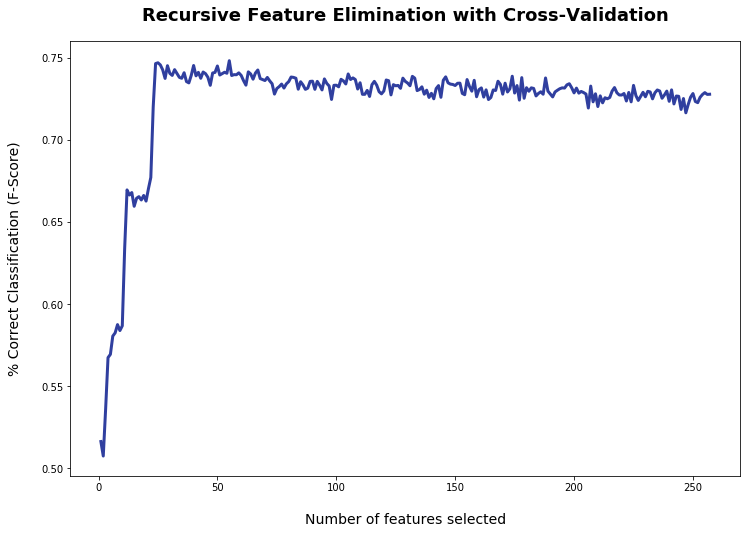

In [86]:
# Plot number of features VS. cross-validation scores
plt.figure(figsize=(12, 8))
plt.title('Recursive Feature Elimination with Cross-Validation', fontsize=18, fontweight='bold', pad=20)
plt.xlabel('Number of features selected', fontsize=14, labelpad=20)
plt.ylabel('% Correct Classification (F-Score)', fontsize=14, labelpad=20)
plt.plot(range(1, len(rfecv_small_medium.grid_scores_) + 1), rfecv_small_medium.grid_scores_, color='#303F9F', linewidth=3)

plt.show()

In [87]:
rfe_selector_to_be_dropped_cols_small_medium = list(X.columns[np.where(rfecv_small_medium.support_ == False)[0]])
print(len(rfe_selector_to_be_dropped_cols_small_medium))

202


In [69]:
#rfe_selector_to_be_dropped_cols_small_medium = []

In [70]:
rfe_selector_to_be_dropped_cols_small_medium

['sds_segmento_new',
 'qta_eta_nrm',
 'qta_indice_contattosita_ult_30gg',
 'val_fascia_stress',
 'val_paga_ritardo_max_ciclo_last_6_months',
 'val_paga_ritardo_mean_ciclo_last_6_months',
 'qta_paga_ritardo_ciclo_last_6_months',
 'val_paga_ritardo_max_ciclo_last_1_months',
 'fln_player_forte',
 'fln_prima_meta',
 'fln_rischio_Pre_Rinnovo',
 'fln_Comune_litoraneo',
 'sds_cluster_ele',
 'sds_cluster_gas',
 'qta_giorni_ultimo_contatto_inbound',
 'qta_giorni_ultimo_contatto_outbound',
 'qta_giorni_ultimo_reclamo',
 'qta_numero_fattura_count_ciclo_last_3_months',
 'qta_numero_fattura_count_ciclo_last_6_months',
 'qta_cnt_mds_specifica_adesione_m6',
 'qta_cnt_mds_specifica_adesione_m9',
 'qta_cnt_mds_specifica_disdetta_m9',
 'qta_cnt_mds_specifica_disdetta_m12',
 'qta_cnt_mds_specifica_other_m1',
 'qta_cnt_mds_specifica_other_m3',
 'qta_cnt_mds_specifica_other_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m6',
 'qta_cnt_mds_tipol

In [80]:
with open(os.getcwd()+"/models/rfe_selector_to_be_dropped_cols_small_medium.pickle", 'wb') as file:
    pickle.dump(rfe_selector_to_be_dropped_cols_small_medium, file, protocol=pickle.HIGHEST_PROTOCOL)
#with open(os.getcwd()+"/models/rfe_selector_to_be_dropped_cols_small_medium.pickle", 'rb') as file:
#    rfe_selector_to_be_dropped_cols_small_medium = pickle.load(file)

In [82]:
[c for c in X.columns if c not in rfe_selector_to_be_dropped_cols_small_medium]

['idn_sito_sk',
 'cdc_cap_nrm',
 'cdc_win_back_m3',
 'qta_anzianita_servizio',
 'val_perc_Abitazioni_Residenti',
 'val_perc_Famiglie_Alloggio_Altro',
 'val_perc_Famiglie_1_Componente',
 'val_perc_Famiglie_3_Componente',
 'val_perc_Famiglie_5_Componente',
 'val_perc_Famiglie_6+_Componente',
 'val_pop_res_totale',
 'val_reddito_disponibile',
 'val_pop_res_totale_15_anni_e_piu_non_appartenente_alle_forze_di_lavoro_nfl',
 'val_pop_res_totale_che_si_sposta_giornalmente_nel_comune_dimora_abituale',
 'val_pop_res_totale_che_si_sposta_giornalmente_fuori_dal_comune_dimora_abituale',
 'val_totale_istruzione_pesata',
 'cdc_istat',
 'val_Altitudine_del_centro',
 'val_Superficie_territoriale',
 'cdc_bolletta_web',
 'qta_days_since_last_inbound_contact',
 'qta_days_last_response_marketing_cli',
 'val_consumi_x_max_ciclo_ele_last_6_months',
 'val_consumi_x_min_ciclo_ele_last_6_months',
 'val_importo_addebito_x_sum_ciclo_ele_last_6_months',
 'val_consumi_x_min_over_mean_ciclo_ele_last_6_months',
 'val

#### Micro

In [88]:
train_set_subset_micro_rfe = train_set_subset_micro_corr.drop(*corr_selector_to_be_dropped_cols_micro).cache()

In [89]:
train_set_subset_micro_rfe_pd = train_set_subset_micro_rfe.toPandas()

In [90]:
subset_micro = train_set_subset_micro_rfe_pd.head(10000)

In [91]:
subset_micro['val_t0_month'].value_counts()

2     1363
1     1269
3     1249
11     749
10     748
12     691
7      678
6      678
9      678
4      648
5      643
8      606
Name: val_t0_month, dtype: int64

In [92]:
subset_micro['val_t0_year'].value_counts()

2019    7937
2020    2063
Name: val_t0_year, dtype: int64

In [93]:
subset_micro[labelCol].value_counts()

0.0    5131
1.0    4869
Name: val_churn_2_months, dtype: int64

In [94]:
X = subset_micro.drop(indexCols+[labelCol], axis=1)
target = subset_micro[labelCol]

In [95]:
rfecv_micro = RFECV(estimator=rfc, step=1, cv=StratifiedKFold(2), scoring='f1', verbose = 1)
rfecv_micro.fit(X, target)

Fitting estimator with 233 features.
Fitting estimator with 232 features.
Fitting estimator with 231 features.
Fitting estimator with 230 features.
Fitting estimator with 229 features.
Fitting estimator with 228 features.
Fitting estimator with 227 features.
Fitting estimator with 226 features.
Fitting estimator with 225 features.
Fitting estimator with 224 features.
Fitting estimator with 223 features.
Fitting estimator with 222 features.
Fitting estimator with 221 features.
Fitting estimator with 220 features.
Fitting estimator with 219 features.
Fitting estimator with 218 features.
Fitting estimator with 217 features.
Fitting estimator with 216 features.
Fitting estimator with 215 features.
Fitting estimator with 214 features.
Fitting estimator with 213 features.
Fitting estimator with 212 features.
Fitting estimator with 211 features.
Fitting estimator with 210 features.
Fitting estimator with 209 features.
Fitting estimator with 208 features.
Fitting estimator with 207 features.
F

Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 features.
Fitting estimator with 4 features.
Fitting estimator with 3 features.
Fitting estimator with 2 features.
Fitting estimator with 233 features.
Fitting estimator with 232 features.
Fitting estimator with 231 features.
Fitting estimator with 230 features.
Fitting estimator with 229 features.
Fitting estimator with 228 features.
Fitting estimator with 227 features.
Fitting estimator with 226 features.
Fitting estimator with 225 features.
Fitting estimator with 224 features.
Fitting estimator with 223 features.
Fitting estimator with 222 features.
Fitting estimator with 221 features.
Fitting estimator with 220 features.
Fitting estimator with 219 features.
Fitting estimator with 218 features.
Fitting estimator with 217 features.
Fitting estimator with 216 features.
Fitting estimator with 215 features.
Fitting estimator

Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 features.
Fitting estimator with 4 features.
Fitting estimator with 3 features.
Fitting estimator with 2 features.
Fitting estimator with 233 features.
Fitting estimator with 232 features.
Fitting estimator with 231 features.
Fitting estimator with 230 features.
Fitting estimator with 229 features.
Fitting estimator with 228 features.
Fitting estimator with 227 features.
Fitting estimator with 226 features.
Fitting estimator with 225 features.
Fitting estimator with 224 features.
Fitting estimator with 223 features.
Fitting estimator with 222 features.
Fitting estimator with 2

RFECV(cv=StratifiedKFold(n_splits=2, random_state=None, shuffle=False),
      estimator=RandomForestClassifier(random_state=101), scoring='f1',
      verbose=1)

In [96]:
with open(os.getcwd()+"/models/rfecv_micro.pickle", 'wb') as file:
    pickle.dump(rfecv_micro, file, protocol=pickle.HIGHEST_PROTOCOL)
#with open(os.getcwd()+"/models/rfecv_micro.pickle", 'rb') as file:
#    rfecv_micro = pickle.load(file)

In [97]:
print('Optimal number of features: {}'.format(rfecv_micro.n_features_))

Optimal number of features: 49


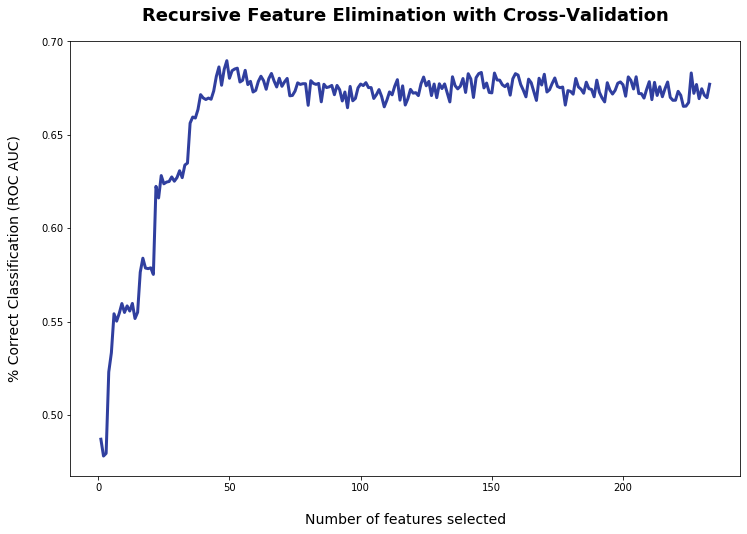

In [98]:
# Plot number of features VS. cross-validation scores
plt.figure(figsize=(12, 8))
plt.title('Recursive Feature Elimination with Cross-Validation', fontsize=18, fontweight='bold', pad=20)
plt.xlabel('Number of features selected', fontsize=14, labelpad=20)
plt.ylabel('% Correct Classification (ROC AUC)', fontsize=14, labelpad=20)
plt.plot(range(1, len(rfecv_micro.grid_scores_) + 1), rfecv_micro.grid_scores_, color='#303F9F', linewidth=3)

plt.show()

In [99]:
rfe_selector_to_be_dropped_cols_micro = list(X.columns[np.where(rfecv_micro.support_ == False)[0]])
print(len(rfe_selector_to_be_dropped_cols_micro))

184


In [ ]:
#rfe_selector_to_be_dropped_cols_micro = []

In [100]:
rfe_selector_to_be_dropped_cols_micro

['qta_indice_contattosita_ult_30gg',
 'val_fascia_stress',
 'fln_player_forte',
 'fln_prima_meta',
 'fln_rischio_Pre_Rinnovo',
 'val_perc_Famiglie_6+_Componente',
 'val_studenti',
 'cdc_Zona_altimetrica',
 'fln_Comune_litoraneo',
 'cdc_Comune_Montano',
 'qta_Grado_di_urbanizzazione',
 'sds_cluster_gas',
 'qta_giorni_ultimo_contatto_outbound',
 'qta_numero_fattura_count_ciclo_last_3_months',
 'qta_numero_fattura_count_ciclo_last_6_months',
 'qta_numero_fattura_count_ciclo_last_9_months',
 'qta_cnt_mds_specifica_adesione_m9',
 'qta_cnt_mds_specifica_disdetta_m12',
 'qta_cnt_mds_specifica_other_m1',
 'qta_cnt_mds_specifica_other_m3',
 'qta_cnt_mds_specifica_other_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m1',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m3',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m6',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m9',
 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m12',
 'qta_cnt_mds_tipologia_attivita_gestione_document

In [101]:
with open(os.getcwd()+"/models/rfe_selector_to_be_dropped_cols_micro.pickle", 'wb') as file:
    pickle.dump(rfe_selector_to_be_dropped_cols_micro, file, protocol=pickle.HIGHEST_PROTOCOL)
#with open(os.getcwd()+"/models/rfe_selector_to_be_dropped_cols_micro.pickle", 'rb') as file:
#    rfe_selector_to_be_dropped_cols_micro = pickle.load(file)

In [102]:
[c for c in X.columns if c not in rfe_selector_to_be_dropped_cols_micro]

['idn_sito_sk',
 'cdc_cap_nrm',
 'qta_eta_nrm',
 'cdc_win_back_m3',
 'qta_anzianita_servizio',
 'val_perc_Famiglie_Alloggio_Affitto',
 'val_perc_Famiglie_Alloggio_Altro',
 'val_perc_Famiglie_1_Componente',
 'val_perc_Famiglie_2_Componente',
 'val_perc_Famiglie_3_Componente',
 'val_perc_Famiglie_4_Componente',
 'val_pop_res_totale_15_anni_e_piu_casalinghe',
 'val_reddito_disponibile',
 'val_consumi_famiglie',
 'val_pop_res_totale_15_anni_e_piu_non_appartenente_alle_forze_di_lavoro_nfl',
 'val_pop_res_totale_che_si_sposta_giornalmente_fuori_dal_comune_dimora_abituale',
 'val_totale_istruzione_pesata',
 'cdc_istat',
 'val_Altitudine_del_centro',
 'val_Superficie_territoriale',
 'cdc_bolletta_web',
 'qta_days_last_response_marketing_cli',
 'val_consumi_x_min_ciclo_ele_last_6_months',
 'val_consumi_x_max_over_mean_ciclo_ele_last_6_months',
 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_6_months',
 'val_consumi_x_sum_ciclo_ele_last_3_months',
 'val_totale_pagare_x_last_ciclo',
 'val_tota

### Gather all the columns to be dropped

In [44]:
#to_be_dropped_cols_small_medium = ['val_consumi_x_max_over_mean_ciclo_gas_last_1_months', 'xds_tipo_azione_campagna_last_response_marketing_cli_PROMOZIONE', 'qta_max_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL', 'qta_cnt_diffida_procedura_M2_cli', 'qta_cnt_fln_contatti_inbound_m12', 'fln_dual', 'sds_regione_fatturazione_embed7', 'qta_days_since_last_inbound_contact_microcausale_PRIMA_ATTIVAZIONE', 'val_totale_pagare_x_last_over_mean', 'fln_distributore_gas_comune_Alperia', 'fln_venditore_mercato_libero_gas_comune_AIMAG', 'qta_cnt_canale_FACE_last_90_days', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_CONSUMI_PAGAMENTI', 'qta_cnt_microcausale_RVC_last_90_days', 'val_consumi_x_mean_ciclo_ele_last_3_months', 'val_importo_addebito_x_min_ciclo_ele_last_1_months', 'qta_cnt_contatti_inbound_all_channel_m9', 'mds_nome_campagna_last_response_marketing_cli_embed8', 'fln_multi_venditori_mercato_libero_ele_comune', 'lds_prodotto_listino_2_embed6', 'fln_servizio_distaccato_e_riallacciato', 'val_importo_addebito_x_mean_ciclo_gas_last_3_months', 'qta_cnt_solleciti_livello_01_cli', 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_3_months', 'val_delta_prezzo_percentuale_gas_last_1_months', 'lds_tipo_uso_USO_DOMESTICO', 'qta_cnt_canale_CHAT_last_90_days', 'fln_cliente_accetta_proposta_last_3_months', 'qta_cnt_attivita_blacklist_last_3_months', 'val_consumi_x_min_ciclo_gas_last_1_months', 'fln_distributore_energia_comune_ENEL', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m6', 'val_totale_pagare_x_last', 'xds_tipologia_azione_last_response_marketing_cli_embed5', 'qta_cnt_microcausale_RECLAMI_SCRITTI_last_90_days', 'val_importo_addebito_x_mean_ciclo_gas_last_6_months', 'qta_cnt_microcausale_PIANO_DI_RIENTRO_last_90_days', 'qta_cnt_fln_contatti_inbound_m6', 'qta_cnt_microcausale_LAVORI_E_MODIFICHE_TECNICHE_POTENZA_TENSIONE_last_90_days', 'val_totale_pagare_x_mean_ciclo_gas_last_1_months', 'qta_cnt_campagne_mktg_orientamento_OUTBOUND_last_3_months', 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_6_months', 'val_totale_pagare_x_sum_ciclo_ele_last_6_months', 'mds_canale_acquisizione_embed6', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m9', 'qta_cnt_attivita_secondo_livello_last_3_months', 'fln_venditore_mercato_libero_gas_comune_Unogas', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m12', 'qta_cnt_attivita_analisi_fatturato_situazione_contabile_last_3_months', 'fln_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL', 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_6_months', 'sds_regione_embed2', 'qta_cnt_sms_cli', 'val_totale_pagare_x_sum_ciclo_gas_last_6_months', 'mds_land_type_***', 'val_consumi_x_sum_ciclo_ele_last_6_months', 'qta_cnt_venditori_mercato_libero_ele_comune', 'qta_cnt_attivita_morosita_last_3_months', 'qta_cnt_attivita_autoletture_last_3_months', 'flc_vas_CAT2', 'qta_cnt_contatti_inbound_all_channel_m3', 'mds_tipologia_pagamento_MULTIPLO', 'val_mean_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL', 'val_consumi_x_mean_ciclo_gas_last_1_months', 'sds_regione_embed6', 'fln_fattura_pagata_totalmente_in_ritardo_servizio_ultima_bolletta_emessa_canale_ALL', 'qta_cnt_contatti_inbound_all_channel_m1', 'mds_canale_acquisizione_embed5', 'val_rimborsi_mean_ciclo_last_3_months', 'val_consumi_x_max_over_mean_ciclo_ele_last_1_months', 'fln_venditore_mercato_libero_ele_comune_EOn', 'sds_categoria_ateco_intermedia_embed3', 'qta_days_since_last_inbound_contact_microcausale_MODALITA_DI_PAGAMENTO', 'fln_rischio_Baby_Churn', 'val_mean_val_fattura_non_pagato_servizio_last_6_months_canale_ALL', 'fln_stesso_venditore_distributore_ele', 'qta_cnt_attivita_invio_WL_pesante_last_3_months', 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_ele', 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_6_months', 'val_importo_addebito_x_min_ciclo_gas_last_1_months', 'val_totale_pagare_x_min_ciclo_gas_last_3_months', 'fln_venditore_mercato_libero_ele_comune_EDISON', 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_1_months', 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_1_months', 'qta_days_diff_diffida_fattura_cli', 'val_totale_pagare_x_max_ciclo_gas_last_1_months', 'fln_primo_contatto_inbound', 'val_consumi_x_min_ciclo_gas_last_3_months', 'val_importo_addebito_x_mean_ciclo_gas_last_1_months', 'cdc_cluster_fattura_last_OTHER', 'val_fascia_contattosita', 'fln_venditore_mercato_libero_gas_comune_Axpo_Group', 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_1_months', 'qta_days_since_last_inbound_contact_macrocausale_Chiarimenti_su_fatture', 'val_importo_addebito_x_min_ciclo_ele_last_3_months', 'fln_venditore_mercato_libero_gas_only_small', 'val_importo_addebito_x_min_ciclo_gas_last_6_months', 'val_consumi_x_min_ciclo_gas_last_6_months', 'cdc_tenure_bucket_cliente', 'fln_distributore_energia_comune_municipalizzata', 'fln_venditore_mercato_libero_gas_comune_METANO_NORD_SPA', 'val_importo_addebito_x_max_ciclo_ele_last_3_months', 'val_consumi_x_max_over_mean_ciclo_ele_last_3_months', 'fln_distributore_gas_comune_Dolomiti_Energia', 'val_importo_addebito_x_max_ciclo_ele_last_1_months', 'qta_cnt_fln_contatti_inbound_m9', 'val_paga_ritardo_mean_ciclo_last_1_months', 'fln_venditore_mercato_libero_ele_comune_sorgenia', 'val_importo_addebito_x_mean_ciclo_ele_last_6_months', 'qta_days_since_last_inbound_contact_microcausale_RVC', 'qta_cnt_diffida_procedura_M3_cli', 'qta_days_since_last_inbound_contact_microcausale_RECLAMI_SCRITTI', 'qta_cnt_campagne_mktg_tipologia_azione_LOYALTY_last_3_months', 'val_pop_res_totale_15_anni_e_piu_casalinghe', 'fln_distacco_last_2_months', 'lds_comune_fornitura_embed3', 'xds_canale_last_response_marketing_cli_embed2', 'val_importo_addebito_x_sum_ciclo_gas_last_3_months', 'val_importo_addebito_x_max_ciclo_gas_last_6_months', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m1', 'qta_cnt_diffide_livello_02_cli', 'sds_provincia_fatturazione_embed7', 'qta_cnt_mds_specifica_other_m9', 'val_totale_pagare_x_mean_ciclo_ele_last_3_months', 'xds_tipologia_azione_last_response_marketing_cli_embed2', 'val_perc_Famiglie_Alloggio_Affitto', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m1', 'qta_cnt_attivita_ripensamento_last_3_months', 'qta_cnt_contatti_outbound_all_channel_m9', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m6', 'xds_canale_last_response_marketing_cli_embed4', 'qta_cnt_mail_di_sollecito_cli', 'val_totale_pagare_x_mean_ciclo_ele_last_1_months', 'qta_cnt_attivita_recesso_suggello_voltura_mancata_ritardata_last_3_months', 'xds_canale_last_response_marketing_cli_embed8', 'qta_cnt_riallaccio_last_2_months', 'lds_societa_vendita_SORGENIA_SPA', 'qta_cnt_fln_contatti_inbound_m3', 'val_Cliente_con_servizio_cessato_last_3_months', 'fln_venditore_mercato_libero_ele_only_small', 'val_paga_ritardo_min_ciclo_last_1_months', 'xds_tipologia_azione_last_response_marketing_cli_embed4', 'val_consumi_x_min_over_mean_ciclo_gas_last_6_months', 'fln_venditore_mercato_libero_gas_enel', 'val_paga_ritardo_sum_ciclo_last_3_months', 'qta_cnt_cliente_response_negativa_last_3_months', 'mds_canale_acquisizione_embed4', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m6', 'fln_distributore_gas_comune_HERA', 'lds_RETE_GAS_IR/FR', 'qta_days_since_last_inbound_contact_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO', 'val_importo_addebito_x_mean_ciclo_ele_last_3_months', 'fln_venditore_mercato_libero_ele_comune_Gas_Rimini', 'lds_Cluster_Polis_11_gruppi_embed8', 'val_consumi_x_min_over_mean_ciclo_ele_last_3_months', 'qta_cnt_contatti_inbound_all_channel_m6', 'val_Residenti', 'lds_societa_vendita_Altro', 'sds_regione_fatturazione_embed4', 'qta_cnt_distributori_gas_comune', 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_PRIVACY', 'lds_comune_fornitura_embed8', 'xds_tipologia_azione_last_response_marketing_cli_embed1', 'fln_multi_distributore_gas_comune', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m6', 'sds_regione_embed5', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m3', 'mds_land_type_METRO', 'qta_cnt_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE_last_90_days', 'qta_cnt_microcausale_MODALITA_DI_PAGAMENTO_last_90_days', 'qta_cnt_mds_tipologia_attivita_other_m12', 'val_totale_pagare_x_sum_ciclo_ele_last_3_months', 'val_fattura_non_pagato_servizio_ultima_bolletta_emessa_canale_ALL', 'fln_cliente_response_negativa_last_3_months', 'qta_cnt_attivita_ricezione_invio_documentazione_last_3_months', 'fln_venditore_mercato_libero_ele_comune_Acea', 'val_mean_fattura_pagata_totalmente_in_ritardo_servizio_last_3_months_canale_ALL', 'val_mean_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL', 'xds_canale_last_response_marketing_cli_embed6', 'sds_mat_NORD_EST', 'val_consumi_x_max_ciclo_gas_last_3_months', 'val_Sh_ENEL_POWER', 'val_max_val_fattura_non_pagato_servizio_last_6_months_canale_ALL', 'fln_distributore_gas_comune_Italgas', 'fln_diffida_last_2_months_serv', 'fln_distributore_gas_comune_municipalizzata', 'fln_distributore_energia_comune_Alperia', 'qta_cnt_fln_chiamate_inbound_m1', 'qta_cnt_fln_chiamate_inbound_m6', 'qta_days_since_last_inbound_contact_microcausale_RIMBORSO_COMPENSAZIONE', 'qta_cnt_distributori_energia_comune', 'val_paga_ritardo_sum_ciclo_last_1_months', 'val_totale_pagare_x_mean_ciclo_gas_last_3_months', 'fln_fattura_pagata_non_totalmente_servizio_ultima_bolletta_emessa_canale_ALL', 'qta_cnt_diffida_cartacea_serv', 'val_totale_pagare_x_sum_ciclo_gas_last_1_months', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m9', 'qta_cnt_mds_specifica_disdetta_m3', 'sds_provincia_embed6', 'xds_tipo_azione_campagna_last_response_marketing_cli_INFORMATIVA', 'qta_cnt_fln_chiamate_inbound_m12', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m3', 'val_Negozi_Compr_Mean', 'qta_cnt_campagne_mktg_canale_DEM_last_3_months', 'fln_venditore_mercato_libero_gas_comune_ENEL', 'sds_macro_categoria_ateco_embed6', 'fln_multi_distributore_energia_comune', 'fln_venditore_mercato_libero_ele_comune_Dolomiti_Energia', 'qta_cnt_contatti_outbound_all_channel_m6', 'fln_distributore_energia_big', 'qta_cnt_mds_specifica_other_m12', 'qta_days_since_last_inbound_contact_channel_CHAT', 'lds_Cluster_Polis_11_gruppi_embed5', 'fln_venditore_mercato_libero_gas_big', 'val_totale_pagare_x_max_ciclo_ele_last_6_months', 'val_mean_days_emissione_fattura_pagamento_servizio_last_6_months_canale_ALL', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m1', 'val_mean_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL', 'val_consumi_x_mean_ciclo_ele_last_6_months', 'qta_cnt_microcausale_GESTIONE_PRIVACY_last_90_days', 'fln_venditore_mercato_libero_gas_comune_EOn', 'fln_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL', 'val_mean_fattura_non_pagata_servizio_last_3_months_canale_ALL', 'fln_comunicazione_rinnovo_last_1_months_sottocanale_CARTACEO', 'qta_cnt_fln_contatti_inbound_autolet_m6', 'fln_riallaccio_last_2_months', 'sds_mat_fatturazione_CENTRO', 'qta_cnt_sollecito_procedura_M2_cli', 'val_consumi_x_sum_ciclo_ele_last_1_months', 'sds_mat_SUD', 'qta_cnt_microcausale_AUTOLETTURA_last_90_days', 'lds_prodotto_listino_2_embed4', 'fln_venditore_mercato_libero_gas_comune_EVOLVE_SRL', 'qta_days_since_last_inbound_contact_channel_APP', 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_3_months', 'fln_distributore_gas_comune_A2A', 'qta_days_since_last_inbound_contact_microcausale_SWITCH_ATTIVO', 'qta_numero_fattura_count_ciclo_last_1_months', 'val_delta_prezzo_ele_last_1_months', 'qta_cnt_attivita_bye_bye_letter_last_3_months', 'xds_tipologia_azione_last_response_marketing_cli_embed3', 'fln_venditore_mercato_libero_ele_comune_ENI', 'qta_cnt_mds_tipologia_attivita_other_m3', 'val_consumi_x_mean_ciclo_ele_last_1_months', 'fln_criticita_infra_last_90_days', 'fln_venditore_mercato_libero_ele_enel', 'qta_cnt_cliente_response_positiva_last_3_months', 'lds_RETE_GAS_***', 'qta_cnt_canale_WEB_last_90_days', 'val_consumi_x_max_over_mean_ciclo_gas_last_3_months', 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_3_months', 'fln_venditore_mercato_libero_ele_comune_ENEL', 'val_importo_addebito_x_sum_ciclo_ele_last_3_months', 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_1_months', 'qta_cnt_sollecito_cartaceo_cli', 'val_consumi_x_max_over_mean_ciclo_ele_last_6_months', 'fln_venditore_mercato_libero_ele_big', 'qta_cnt_mds_specifica_disdetta_m1', 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_3_months', 'sds_provincia_embed5', 'val_perc_Altri_Tipi_Alloggio', 'fln_distributore_energia_enel', 'fln_stesso_venditore_distributore_ele_no_enel', 'sds_provincia_embed2', 'val_importo_addebito_x_mean_ciclo_ele_last_1_months', 'qta_cnt_microcausale_SWITCH_ATTIVO_last_90_days', 'fln_cliente_con_response_marketing_utile_last_3_months', 'val_consumi_x_min_ciclo_ele_last_1_months', 'sds_regione_embed1', 'qta_cnt_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL', 'val_totale_pagare_last_sollecito_cli', 'val_totale_pagare_x_max_ciclo_ele_last_3_months', 'qta_cnt_reclami_last_month', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m9', 'qta_cnt_fln_contatti_inbound_guasti_m12', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m12', 'cdc_residente', 'qta_cnt_attivita_vocal_last_3_months', 'fln_fattura_non_pagata_servizio_ultima_bolletta_emessa_canale_ALL', 'qta_Grado_di_urbanizzazione', 'qta_days_since_last_inbound_contact_microcausale_ALLACCIO_E_ATTIVAZIONE', 'qta_cnt_fln_contatti_inbound_reclamo_m12', 'mds_tipologia_pagamento_BONIFICO', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m3', 'val_delta_prezzo_percentuale_ele_last_1_months', 'val_consumi_x_max_ciclo_gas_last_1_months', 'fln_sollecito_last_2_months_cli', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_NON_DI_COMPETENZA', 'lds_RETE_GAS_FR', 'flc_vas_CAT0', 'fln_fattura_pagata_totalmente_nei_tempi_servizio_last_6_months_canale_ALL', 'val_totale_pagare_x_mean_ciclo_gas_last_6_months', 'fln_distributore_energia_comune_Dolomiti_Energia', 'qta_cnt_contatti_inbound_all_channel_m12', 'val_importo_addebito_x_last_ciclo', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m3', 'mds_land_type_RURAL', 'qta_cnt_microcausale_VERIFICHE_TECNICHE_last_90_days', 'fln_venditore_mercato_libero_ele_comune_ENGIE', 'qta_cnt_macrocausale_Esecuzione_lavori_last_90_days', 'val_importo_addebito_x_last', 'fln_venditore_mercato_libero_gas_comune_IREN', 'fln_scarti_sap_sd_last_1_months', 'fln_fattura_non_pagata_servizio_last_6_months_canale_ALL', 'val_paga_ritardo_mean_ciclo_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m3', 'val_studenti', 'fln_rinnovo_last_1_months_tipologia_ADEGUAMENTO', 'qta_cnt_microcausale_REPEATED_LIST_last_90_days', 'qta_cnt_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE_last_90_days', 'val_totale_pagare_x_min_ciclo_gas_last_6_months', 'fln_distributore_energia_comune_HERA', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_CREDITO', 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_1_months', 'qta_cnt_fattura_non_pagata_servizio_last_3_months_canale_ALL', 'fln_venditore_mercato_libero_gas_comune_BURGO_GROUP', 'qta_paga_ritardo_ciclo_last_3_months', 'lds_Cluster_Polis_11_gruppi_embed2', 'cdc_cd_censimento', 'val_consumi_x_min_over_mean_ciclo_gas_last_3_months', 'sds_provincia_fatturazione_embed1', 'mds_nome_campagna_last_response_marketing_cli_embed4', 'qta_cnt_mds_specifica_adesione_m12', 'fln_stesso_distributore_gas_ele', 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_6_months', 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL', 'qta_cnt_microcausale_DISTACCHI_RIALLACCI_last_90_days', 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_3_months', 'fln_venditore_mercato_libero_ele_comune_HERA', 'qta_days_since_last_inbound_contact_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE', 'qta_cnt_microcausale_INFORMATIVA_NON_DI_COMPETENZA_last_90_days', 'val_QUOTA_LIBERO', 'val_importo_addebito_x_min_ciclo_gas_last_3_months', 'fln_venditore_mercato_libero_gas_comune_Dolomiti_Energia', 'lds_comune_fornitura_embed2', 'qta_cnt_contatti_outbound_all_channel_m12', 'qta_cnt_macrocausale_Ritardata_esecuzione_subentri_volture_cessazioni_etc_last_90_days', 'qta_cnt_sollecito_procedura_M1_cli', 'fln_venditore_mercato_libero_gas_comune_ENGIE', 'val_totale_pagare_x_sum_ciclo_ele_last_1_months', 'fln_diffida_last_2_months_cli', 'val_perc_Abitazioni_Vuote', 'val_mean_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL', 'lds_Cluster_Polis_11_gruppi_embed4', 'qta_cnt_attivita_sollecito_last_3_months', 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_3_months', 'val_totale_pagare_x_min_ciclo_gas_last_1_months', 'cdc_cluster_fattura_last_ADJ_STORNO', 'qta_days_since_last_inbound_contact_macrocausale_Reclami_vendita_Privacy', 'val_perc_Famiglie_Alloggio_Proprieta', 'sds_macro_categoria_ateco_embed8', 'lds_Cluster_Polis_11_gruppi_embed7', 'val_totale_pagare_x_min_ciclo_ele_last_1_months', 'qta_cnt_mds_specifica_adesione_m1', 'fln_venditore_mercato_libero_ele_comune_Alperia', 'cdc_id_mercato_***', 'val_totale_pagare_x_max_ciclo_ele_last_1_months', 'qta_max_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL', 'val_perc_Abitazioni_Non_Residenti', 'qta_cnt_mds_specifica_adesione_m3', 'qta_cnt_microcausale_INFORMATIVA_CREDITO_last_90_days', 'val_consumi_x_sum_ciclo_ele_last_3_months', 'qta_cnt_fln_contatti_inbound_m1', 'fln_fattura_pagata_totalmente_nei_tempi_servizio_ultima_bolletta_emessa_canale_ALL', 'cdc_causale_attivazione_embed6', 'val_consumi_x_mean_ciclo_gas_last_3_months', 'val_Idx_Commercio', 'qta_cnt_fln_contatti_inbound_autolet_m1', 'qta_cnt_mds_tipologia_attivita_other_m1', 'fln_cliente_response_competitor_last_3_months', 'qta_cnt_fln_contatti_inbound_autolet_m3', 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m12', 'qta_cnt_macrocausale_Problemi_in_fase_di_attivazione_last_90_days', 'fln_scarti_trasporto_last_1_months', 'xds_canale_last_response_marketing_cli_embed3', 'fln_criticita_cross_last_90_days', 'qta_frequenza_contatto', 'qta_cnt_diffida_procedura_M4_cli', 'fln_rinnovo_last_1_months', 'qta_cnt_macrocausale_Credito_last_90_days', 'sds_mat_fatturazione_NORD_OVEST', 'sds_regione_fatturazione_embed8', 'qta_days_since_last_inbound_contact_microcausale_AUTOLETTURA', 'cdc_Comune_Montano', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_1_months', 'fln_multi_venditori_mercato_libero_gas_comune', 'val_Cliente_con_comunicazione_swp_storico_last_1_months', 'val_Cliente_con_comunicazione_swp_storico_last_3_months', 'sds_mat_fatturazione_NORD_EST', 'lds_RETE_GAS_IR', 'qta_cnt_fln_contatti_inbound_autolet_m9', 'fln_venditore_mercato_libero_gas_comune_ENEGAN', 'cdc_Zona_altimetrica', 'fln_distributore_gas_big', 'lds_societa_vendita_ENI_GAS_&_POWER_SPA', 'fln_distributore_gas_comune_IREN', 'qta_cnt_fln_chiamate_inbound_m9', 'sds_mat_NORD_OVEST', 'val_Negozi_Loc_Mean', 'sds_provincia_embed3', 'qta_cnt_canale_APP_last_90_days', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m6', 'sds_mat_fatturazione_***', 'qta_cnt_microcausale_INFORMATIVA_last_90_days', 'qta_cnt_fln_contatti_inbound_reclamo_m9', 'val_consumi_x_min_over_mean_ciclo_ele_last_1_months', 'qta_numero_fattura_count_ciclo_last_9_months', 'qta_cnt_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO_last_90_days', 'fln_distributore_energia_comune_IREN', 'val_importo_addebito_x_max_ciclo_ele_last_6_months', 'qta_cnt_comuni_serviti_distributore_energia', 'qta_cnt_mds_tipologia_attivita_other_m9', 'fln_venditore_mercato_libero_gas_comune_Green_Network', 'fln_scarti_sdd_rid_last_1_months', 'sds_categoria_ateco_intermedia_embed8', 'sds_regione_embed3', 'sds_provincia_embed4', 'fln_comunicazione_rinnovo_last_1_months_sottocanale_FATTURA', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m1', 'val_POT_TOTALE_NETTO', 'val_totale_pagare_x_min_ciclo_ele_last_6_months', 'cdc_causale_attivazione_embed5', 'qta_cnt_mds_tipologia_attivita_gestione_clienti_m1', 'val_consumi_x_mean_ciclo_gas_last_6_months', 'val_consumi_x_sum_ciclo_gas_last_1_months', 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL', 'qta_days_since_last_inbound_contact_channel_WEB', 'val_consumi_x_min_over_mean_ciclo_gas_last_1_months', 'val_paga_ritardo_max_ciclo_last_3_months', 'fln_distributore_energia_comune_ASTEA_SPA', 'val_consumi_x_max_ciclo_ele_last_1_months', 'sds_mat_CENTRO', 'lds_tipo_uso_STRAORDINARIA', 'qta_cnt_fln_contatti_inbound_autolet_m12', 'val_importo_addebito_x_sum_ciclo_gas_last_1_months', 'val_Cliente_con_comunicazione_swp_storico_last_6_months', 'fln_venditore_mercato_libero_ele_comune_Axpo_Group', 'qta_cnt_canale_DOCUMENTALE_COMPLESSO_last_90_days', 'qta_cnt_fln_chiamate_inbound_m3', 'lds_comune_fornitura_embed6', 'qta_cnt_fln_contatti_inbound_guasti_m1', 'val_consumi_x_max_ciclo_ele_last_3_months', 'val_max_val_fattura_non_pagato_servizio_last_3_months_canale_ALL', 'lds_comune_fornitura_embed4', 'qta_cnt_fln_contatti_inbound_guasti_m3', 'val_consumi_x_min_ciclo_ele_last_3_months', 'qta_cnt_diffida_procedura_M1_cli', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_3_months', 'val_totale_pagare_x_sum_ciclo_gas_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m1', 'val_consumi_x_sum_ciclo_gas_last_6_months', 'cdc_id_mercato_SALVAGUARDIA', 'cdc_id_mercato_VINCOLATO', 'val_consumi_famiglie', 'qta_max_days_scadenza_fattura_pagamento_servizio_last_6_months_canale_ALL', 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_gas', 'val_paga_ritardo_sum_ciclo_last_6_months', 'fln_scarti_sempre_sap_last_1_months', 'mds_nome_campagna_last_response_marketing_cli_embed6', 'lds_tipo_uso_***', 'val_incasso_servizio_ultima_bolletta_emessa_canale_ALL', 'fln_stesso_venditore_distributore_gas', 'qta_cnt_attivita_modifiche_variazioni_last_3_months', 'lds_Cluster_Polis_11_gruppi_embed3', 'fln_player_forte_win_back', 'xds_canale_last_response_marketing_cli_embed7', 'lds_Cluster_Polis_11_gruppi_embed6', 'val_totale_pagare_x_max_ciclo_gas_last_6_months', 'fln_venditore_mercato_libero_gas_comune_Gruppo_Canarbino', 'qta_days_servizio_riallacciato', 'val_totale_pagare_x_max_ciclo_gas_last_3_months', 'fln_cliente_response_positiva_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m12', 'val_totale_pagare_x_min_ciclo_ele_last_3_months', 'val_importo_addebito_x_max_ciclo_gas_last_1_months', 'lds_comune_fornitura_embed5', 'qta_days_since_last_inbound_contact_microcausale_DISTACCHI_RIALLACCI', 'val_Turisti_totali', 'fln_distributore_gas_comune_2i_Rete_Gas_SpA', 'val_perc_Famiglie_4_Componente', 'qta_days_since_last_inbound_contact_macrocausale_Esecuzione_lavori', 'qta_cnt_cliente_accetta_proposta_last_3_months', 'qta_numero_fattura_count_ciclo_last_12_months', 'val_mean_val_fattura_non_pagato_servizio_last_3_months_canale_ALL', 'fln_distributore_energia_comune_A2A', 'fln_distributore_gas_comune_EDISON', 'val_mean_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL', 'sds_categoria_ateco_intermedia_embed4', 'mds_tipologia_pagamento_WEB', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m6', 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_1_months', 'qta_cnt_mds_tipologia_attivita_other_m6', 'fln_servizio_attualmente_distaccato', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_6_months', 'val_consumi_x_sum_ciclo_gas_last_3_months', 'val_paga_ritardo_min_ciclo_last_6_months', 'val_importo_addebito_x_max_ciclo_gas_last_3_months', 'qta_cnt_microcausale_RIMBORSO_COMPENSAZIONE_last_90_days', 'qta_cnt_macrocausale_Reclami_vendita_Privacy_last_90_days', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m9', 'fln_comunicazione_rinnovo_last_1_months', 'val_perc_Famiglie_2_Componente', 'qta_days_since_last_inbound_contact_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE', 'fln_venditore_mercato_libero_ele_comune_Gruppo_Canarbino', 'mds_land_type_URBAN', 'val_mean_fattura_non_pagata_servizio_last_6_months_canale_ALL', 'val_delta_prezzo_gas_last_1_months', 'qta_cnt_mds_specifica_disdetta_m6', 'qta_cnt_microcausale_GESTIONE_VAS_last_90_days', 'qta_cnt_flag_response_competitor_last_3_months', 'fln_distributore_energia_comune_Acea', 'val_paga_ritardo_min_ciclo_last_3_months', 'qta_cnt_attivita_dl_piano_casa_last_3_months', 'val_totale_pagare_last_diffida_cli', 'qta_cnt_fln_contatti_inbound_guasti_m6', 'xds_tipologia_azione_last_response_marketing_cli_embed6', 'fln_sollecito_last_2_months_serv', 'sds_provincia_embed8', 'qta_cnt_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL', 'fln_venditore_mercato_libero_gas_comune_EDISON', 'val_totale_pagare_x_mean_ciclo_ele_last_6_months', 'qta_cnt_attivita_pagamenti_metodi_pagamento_last_3_months', 'qta_cnt_diffida_cartacea_cli', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m3', 'qta_cnt_fln_contatti_inbound_guasti_m9', 'qta_cnt_distacchi_last_2_months', 'fln_comunicazione_rinnovo_last_1_months_sottocanale_PEC', 'qta_paga_ritardo_ciclo_last_1_months', 'lds_Cluster_Polis_11_gruppi_embed1', 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_6_months', 'val_POT_TOTALE', 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m12', 'fln_rinnovo_last_1_months_tipologia_RVC', 'fln_venditore_mercato_libero_gas_comune_A2A', 'lds_comune_fornitura_embed1', 'fln_venditore_mercato_libero_gas_comune_Alperia', 'qta_cnt_sollecito_procedura_M0_cli', 'flc_vas_CAT1']

#to_be_dropped_cols_micro = ['val_consumi_x_max_over_mean_ciclo_gas_last_1_months', 'xds_tipo_azione_campagna_last_response_marketing_cli_PROMOZIONE', 'qta_max_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL', 'qta_cnt_diffida_procedura_M2_cli', 'qta_cnt_fln_contatti_inbound_m12', 'fln_dual', 'sds_regione_fatturazione_embed7', 'qta_cnt_attivita_fattura_mancata_ritardata_last_3_months', 'qta_days_since_last_inbound_contact_microcausale_PRIMA_ATTIVAZIONE', 'fln_distributore_gas_comune_Alperia', 'fln_venditore_mercato_libero_gas_comune_AIMAG', 'qta_cnt_microcausale_RVC_last_90_days', 'val_consumi_x_mean_ciclo_ele_last_3_months', 'val_importo_addebito_x_min_ciclo_ele_last_1_months', 'qta_cnt_contatti_inbound_all_channel_m9', 'mds_nome_campagna_last_response_marketing_cli_embed8', 'val_mean_days_scadenza_fattura_pagamento_servizio_last_6_months_canale_ALL', 'fln_servizio_distaccato_e_riallacciato', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m9', 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_6_months', 'val_importo_addebito_x_mean_ciclo_gas_last_3_months', 'qta_cnt_solleciti_livello_01_cli', 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_3_months', 'lds_tipo_uso_USO_DOMESTICO', 'qta_cnt_canale_CHAT_last_90_days', 'fln_cliente_accetta_proposta_last_3_months', 'qta_cnt_attivita_blacklist_last_3_months', 'val_consumi_x_min_ciclo_gas_last_1_months', 'fln_distributore_energia_comune_ENEL', 'cdc_tenure_bucket', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m6', 'qta_cnt_fln_contatti_inbound_reclamo_m1', 'val_totale_pagare_x_last', 'xds_tipologia_azione_last_response_marketing_cli_embed5', 'qta_cnt_microcausale_RECLAMI_SCRITTI_last_90_days', 'val_importo_addebito_x_mean_ciclo_gas_last_6_months', 'qta_cnt_fln_contatti_inbound_m6', 'qta_cnt_microcausale_LAVORI_E_MODIFICHE_TECNICHE_POTENZA_TENSIONE_last_90_days', 'val_totale_pagare_x_mean_ciclo_gas_last_1_months', 'qta_cnt_campagne_mktg_orientamento_OUTBOUND_last_3_months', 'val_totale_pagare_x_sum_ciclo_ele_last_6_months', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m9', 'qta_cnt_attivita_secondo_livello_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m12', 'qta_cnt_attivita_analisi_fatturato_situazione_contabile_last_3_months', 'fln_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL', 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_6_months', 'qta_cnt_sms_cli', 'lds_prodotto_listino_2_embed7', 'val_totale_pagare_x_sum_ciclo_gas_last_6_months', 'mds_land_type_***', 'cdc_cluster_fattura_last_CICLO', 'val_consumi_x_sum_ciclo_ele_last_6_months', 'qta_cnt_venditori_mercato_libero_ele_comune', 'qta_cnt_attivita_morosita_last_3_months', 'qta_cnt_attivita_autoletture_last_3_months', 'flc_vas_CAT2', 'qta_cnt_microcausale_PRIMA_ATTIVAZIONE_last_90_days', 'qta_cnt_contatti_inbound_all_channel_m3', 'val_mean_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL', 'lds_prodotto_listino_2_embed3', 'val_consumi_x_mean_ciclo_gas_last_1_months', 'sds_mat_fatturazione_SUD', 'qta_cnt_mds_specifica_disdetta_m9', 'fln_fattura_pagata_totalmente_in_ritardo_servizio_ultima_bolletta_emessa_canale_ALL', 'xds_tipologia_azione_last_response_marketing_cli_embed8', 'sds_regione_embed6', 'qta_cnt_contatti_inbound_all_channel_m1', 'val_rimborsi_mean_ciclo_last_3_months', 'qta_cnt_canale_DOCUMENTALE_last_90_days', 'val_importo_addebito_x_sum_ciclo_ele_last_1_months', 'val_consumi_x_max_over_mean_ciclo_ele_last_1_months', 'val_POT_POWER_NETTO', 'fln_venditore_mercato_libero_ele_comune_EOn', 'qta_days_since_last_inbound_contact_microcausale_MODALITA_DI_PAGAMENTO', 'fln_rischio_Baby_Churn', 'val_mean_val_fattura_non_pagato_servizio_last_6_months_canale_ALL', 'fln_stesso_venditore_distributore_ele', 'qta_cnt_attivita_invio_WL_pesante_last_3_months', 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_ele', 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_6_months', 'val_importo_addebito_x_min_ciclo_gas_last_1_months', 'val_totale_pagare_x_min_ciclo_gas_last_3_months', 'fln_venditore_mercato_libero_ele_comune_EDISON', 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_1_months', 'qta_cnt_attivita_delibera_147_last_3_months', 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_1_months', 'val_totale_pagare_x_max_ciclo_gas_last_1_months', 'fln_primo_contatto_inbound', 'val_consumi_x_min_ciclo_gas_last_3_months', 'val_importo_addebito_x_mean_ciclo_gas_last_1_months', 'lds_tipo_uso_ILLUMINAZIONE_PUBBLICA', 'cdc_cluster_fattura_last_OTHER', 'val_fascia_contattosita', 'fln_venditore_mercato_libero_gas_comune_Axpo_Group', 'val_importo_addebito_x_min_ciclo_ele_last_3_months', 'val_totale_pagare_x_min_over_mean_ciclo_ele_last_1_months', 'fln_venditore_mercato_libero_gas_only_small', 'val_importo_addebito_x_min_ciclo_gas_last_6_months', 'val_consumi_x_min_ciclo_gas_last_6_months', 'fln_distributore_energia_comune_municipalizzata', 'qta_cnt_macrocausale_Chiarimenti_su_fatture_last_90_days', 'fln_venditore_mercato_libero_gas_comune_METANO_NORD_SPA', 'val_importo_addebito_x_max_ciclo_ele_last_3_months', 'val_consumi_x_max_ciclo_gas_last_6_months', 'val_consumi_x_max_over_mean_ciclo_ele_last_3_months', 'fln_distributore_gas_comune_Dolomiti_Energia', 'val_importo_addebito_x_max_ciclo_ele_last_1_months', 'qta_cnt_fln_contatti_inbound_m9', 'val_paga_ritardo_mean_ciclo_last_1_months', 'fln_venditore_mercato_libero_ele_comune_sorgenia', 'val_importo_addebito_x_mean_ciclo_ele_last_6_months', 'qta_days_since_last_inbound_contact_microcausale_LAVORI_E_MODIFICHE_TECNICHE_POTENZA_TENSIONE', 'qta_days_since_last_inbound_contact_microcausale_RVC', 'qta_cnt_diffida_procedura_M3_cli', 'qta_days_since_last_inbound_contact_microcausale_RECLAMI_SCRITTI', 'qta_cnt_campagne_mktg_tipologia_azione_LOYALTY_last_3_months', 'fln_distacco_last_2_months', 'lds_comune_fornitura_embed3', 'xds_tipologia_azione_last_response_marketing_cli_embed7', 'xds_canale_last_response_marketing_cli_embed2', 'val_importo_addebito_x_sum_ciclo_gas_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m1', 'qta_cnt_mds_specifica_other_m9', 'val_totale_pagare_x_mean_ciclo_ele_last_3_months', 'xds_tipologia_azione_last_response_marketing_cli_embed2', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m1', 'qta_cnt_attivita_ripensamento_last_3_months', 'qta_cnt_contatti_outbound_all_channel_m9', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m6', 'xds_canale_last_response_marketing_cli_embed4', 'val_totale_pagare_x_mean_ciclo_ele_last_1_months', 'qta_cnt_attivita_recesso_suggello_voltura_mancata_ritardata_last_3_months', 'xds_canale_last_response_marketing_cli_embed8', 'qta_cnt_riallaccio_last_2_months', 'lds_societa_vendita_SORGENIA_SPA', 'qta_cnt_fln_contatti_inbound_m3', 'val_QUOTA_TUTELATO', 'val_Cliente_con_servizio_cessato_last_3_months', 'fln_venditore_mercato_libero_ele_only_small', 'val_paga_ritardo_min_ciclo_last_1_months', 'xds_tipologia_azione_last_response_marketing_cli_embed4', 'val_consumi_x_min_over_mean_ciclo_gas_last_6_months', 'fln_venditore_mercato_libero_gas_enel', 'val_paga_ritardo_sum_ciclo_last_3_months', 'qta_cnt_cliente_response_negativa_last_3_months', 'mds_canale_acquisizione_embed4', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m6', 'fln_distributore_gas_comune_HERA', 'lds_RETE_GAS_IR/FR', 'qta_days_since_last_inbound_contact_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO', 'val_importo_addebito_x_mean_ciclo_ele_last_3_months', 'fln_venditore_mercato_libero_ele_comune_Gas_Rimini', 'lds_Cluster_Polis_11_gruppi_embed8', 'qta_cnt_contatti_inbound_all_channel_m6', 'val_Residenti', 'lds_societa_vendita_Altro', 'sds_regione_fatturazione_embed4', 'qta_cnt_distributori_gas_comune', 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_PRIVACY', 'xds_tipologia_azione_last_response_marketing_cli_embed1', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m6', 'sds_regione_embed5', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m3', 'xds_canale_last_response_marketing_cli_embed5', 'mds_land_type_METRO', 'qta_cnt_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE_last_90_days', 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_VAS', 'qta_cnt_microcausale_MODALITA_DI_PAGAMENTO_last_90_days', 'val_totale_pagare_x_sum_ciclo_ele_last_3_months', 'val_fattura_non_pagato_servizio_ultima_bolletta_emessa_canale_ALL', 'qta_cnt_mds_tipologia_attivita_other_m12', 'mds_nome_campagna_last_response_marketing_cli_embed7', 'fln_cliente_response_negativa_last_3_months', 'qta_cnt_attivita_ricezione_invio_documentazione_last_3_months', 'fln_venditore_mercato_libero_ele_comune_Acea', 'val_mean_fattura_pagata_totalmente_in_ritardo_servizio_last_3_months_canale_ALL', 'xds_canale_last_response_marketing_cli_embed6', 'cdc_causale_attivazione_embed4', 'sds_mat_NORD_EST', 'val_paga_ritardo_max_ciclo_last_1_months', 'val_consumi_x_max_ciclo_gas_last_3_months', 'val_max_val_fattura_non_pagato_servizio_last_6_months_canale_ALL', 'fln_distributore_gas_comune_Italgas', 'fln_diffida_last_2_months_serv', 'fln_distributore_gas_comune_municipalizzata', 'fln_distributore_energia_comune_Alperia', 'qta_cnt_fln_chiamate_inbound_m1', 'qta_cnt_fln_chiamate_inbound_m6', 'qta_days_since_last_inbound_contact_microcausale_RIMBORSO_COMPENSAZIONE', 'qta_cnt_distributori_energia_comune', 'val_paga_ritardo_mean_ciclo_last_6_months', 'val_paga_ritardo_sum_ciclo_last_1_months', 'qta_days_since_last_inbound_contact_macrocausale_Problemi_in_fase_di_attivazione', 'val_totale_pagare_x_mean_ciclo_gas_last_3_months', 'fln_fattura_pagata_non_totalmente_servizio_ultima_bolletta_emessa_canale_ALL', 'qta_cnt_diffida_cartacea_serv', 'val_totale_pagare_x_sum_ciclo_gas_last_1_months', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m9', 'qta_cnt_mds_specifica_disdetta_m3', 'val_mean_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL', 'sds_provincia_embed6', 'xds_tipo_azione_campagna_last_response_marketing_cli_INFORMATIVA', 'qta_cnt_fln_chiamate_inbound_m12', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m3', 'sds_regione_fatturazione_embed2', 'qta_cnt_attivita_sito_web_chat_last_3_months', 'fln_venditore_mercato_libero_gas_comune_ENEL', 'qta_cnt_fattura_pagata_totalmente_nei_tempi_servizio_last_6_months_canale_ALL', 'val_importo_addebito_x_max_over_mean_ciclo_ele_last_1_months', 'mds_canale_acquisizione_embed7', 'fln_multi_distributore_energia_comune', 'fln_venditore_mercato_libero_ele_comune_Dolomiti_Energia', 'qta_cnt_contatti_outbound_all_channel_m6', 'qta_paga_ritardo_ciclo_last_6_months', 'fln_distributore_energia_big', 'qta_cnt_mds_specifica_other_m12', 'qta_days_since_last_inbound_contact_channel_CHAT', 'sds_provincia_embed7', 'fln_venditore_mercato_libero_gas_big', 'lds_Cluster_Polis_11_gruppi_embed5', 'val_totale_pagare_x_max_ciclo_ele_last_6_months', 'val_mean_days_emissione_fattura_pagamento_servizio_last_6_months_canale_ALL', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m1', 'val_mean_days_scadenza_fattura_pagamento_servizio_last_3_months_canale_ALL', 'val_consumi_x_mean_ciclo_ele_last_6_months', 'qta_cnt_attivita_telefonate_gestione_credito_last_3_months', 'qta_cnt_microcausale_GESTIONE_PRIVACY_last_90_days', 'sds_regione_embed8', 'fln_venditore_mercato_libero_gas_comune_EOn', 'fln_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL', 'val_mean_fattura_non_pagata_servizio_last_3_months_canale_ALL', 'fln_comunicazione_rinnovo_last_1_months_sottocanale_CARTACEO', 'qta_cnt_fln_contatti_inbound_autolet_m6', 'fln_riallaccio_last_2_months', 'sds_mat_fatturazione_CENTRO', 'qta_cnt_sollecito_procedura_M2_cli', 'val_consumi_x_sum_ciclo_ele_last_1_months', 'sds_mat_SUD', 'qta_cnt_microcausale_AUTOLETTURA_last_90_days', 'fln_venditore_mercato_libero_gas_comune_EVOLVE_SRL', 'qta_days_since_last_inbound_contact_channel_APP', 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_3_months', 'fln_distributore_gas_comune_A2A', 'val_POT_GAS_NETTO', 'qta_days_since_last_inbound_contact_microcausale_SWITCH_ATTIVO', 'qta_numero_fattura_count_ciclo_last_1_months', 'val_delta_prezzo_ele_last_1_months', 'qta_cnt_attivita_bye_bye_letter_last_3_months', 'xds_tipologia_azione_last_response_marketing_cli_embed3', 'fln_venditore_mercato_libero_ele_comune_ENI', 'qta_cnt_mds_tipologia_attivita_other_m3', 'val_consumi_x_mean_ciclo_ele_last_1_months', 'fln_criticita_infra_last_90_days', 'fln_venditore_mercato_libero_ele_enel', 'qta_cnt_cliente_response_positiva_last_3_months', 'lds_RETE_GAS_***', 'qta_cnt_canale_WEB_last_90_days', 'val_consumi_x_max_over_mean_ciclo_gas_last_3_months', 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_3_months', 'fln_venditore_mercato_libero_ele_comune_ENEL', 'val_importo_addebito_x_sum_ciclo_ele_last_3_months', 'sds_provincia_embed1', 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_1_months', 'qta_cnt_sollecito_cartaceo_cli', 'fln_venditore_mercato_libero_ele_big', 'qta_cnt_mds_specifica_disdetta_m1', 'mds_canale_acquisizione_embed8', 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_3_months', 'sds_provincia_embed5', 'val_perc_Altri_Tipi_Alloggio', 'fln_distributore_energia_enel', 'fln_stesso_venditore_distributore_ele_no_enel', 'sds_provincia_embed2', 'val_importo_addebito_x_mean_ciclo_ele_last_1_months', 'mds_nome_campagna_last_response_marketing_cli_embed2', 'qta_cnt_microcausale_SWITCH_ATTIVO_last_90_days', 'fln_cliente_con_response_marketing_utile_last_3_months', 'val_consumi_x_min_ciclo_ele_last_1_months', 'sds_regione_embed1', 'qta_cnt_fattura_pagata_totalmente_in_ritardo_servizio_last_6_months_canale_ALL', 'lds_tipo_uso_ETAB1I00C1', 'val_totale_pagare_x_max_ciclo_ele_last_3_months', 'qta_cnt_reclami_last_month', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m9', 'qta_cnt_fln_contatti_inbound_guasti_m12', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m12', 'val_perc_Abitazioni_Residenti', 'cdc_residente', 'qta_cnt_attivita_vocal_last_3_months', 'fln_fattura_non_pagata_servizio_ultima_bolletta_emessa_canale_ALL', 'fln_venditore_mercato_libero_ele_comune_IREN', 'qta_days_since_last_inbound_contact_microcausale_ALLACCIO_E_ATTIVAZIONE', 'lds_tipo_uso_ARTIGIANALE', 'qta_cnt_fln_contatti_inbound_reclamo_m12', 'mds_tipologia_pagamento_BONIFICO', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m3', 'val_delta_prezzo_percentuale_ele_last_1_months', 'val_consumi_x_max_ciclo_gas_last_1_months', 'qta_days_since_last_inbound_contact_microcausale_PIANO_DI_RIENTRO', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_NON_DI_COMPETENZA', 'fln_sollecito_last_2_months_cli', 'flc_vas_CAT0', 'fln_fattura_pagata_totalmente_nei_tempi_servizio_last_6_months_canale_ALL', 'val_totale_pagare_x_mean_ciclo_gas_last_6_months', 'fln_distributore_energia_comune_Dolomiti_Energia', 'qta_cnt_contatti_inbound_all_channel_m12', 'val_importo_addebito_x_last_ciclo', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m3', 'mds_land_type_RURAL', 'qta_cnt_microcausale_VERIFICHE_TECNICHE_last_90_days', 'val_consumi_x_max_over_mean_ciclo_gas_last_6_months', 'fln_venditore_mercato_libero_ele_comune_ENGIE', 'qta_cnt_macrocausale_Esecuzione_lavori_last_90_days', 'val_importo_addebito_x_last', 'fln_venditore_mercato_libero_gas_comune_IREN', 'qta_cnt_attivita_indennizzo_last_3_months', 'fln_scarti_sap_sd_last_1_months', 'val_consumi_x_min_over_mean_ciclo_ele_last_6_months', 'fln_fattura_non_pagata_servizio_last_6_months_canale_ALL', 'val_paga_ritardo_mean_ciclo_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_consumi_m3', 'fln_rinnovo_last_1_months_tipologia_ADEGUAMENTO', 'qta_cnt_microcausale_REPEATED_LIST_last_90_days', 'qta_cnt_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE_last_90_days', 'val_totale_pagare_x_min_ciclo_gas_last_6_months', 'mds_canale_acquisizione_embed3', 'fln_distributore_energia_comune_HERA', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA_CREDITO', 'val_totale_pagare_x_min_over_mean_ciclo_gas_last_1_months', 'fln_venditore_mercato_libero_gas_comune_BURGO_GROUP', 'qta_paga_ritardo_ciclo_last_3_months', 'lds_Cluster_Polis_11_gruppi_embed2', 'cdc_cd_censimento', 'val_consumi_x_min_over_mean_ciclo_gas_last_3_months', 'lds_tipo_uso_USO_SERVIZIO_ABITATIVO', 'qta_cnt_mds_specifica_adesione_m12', 'fln_stesso_distributore_gas_ele', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m9', 'val_importo_addebito_x_min_over_mean_ciclo_gas_last_6_months', 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL', 'val_pop_res_totale_che_si_sposta_giornalmente_nel_comune_dimora_abituale', 'qta_cnt_microcausale_DISTACCHI_RIALLACCI_last_90_days', 'qta_days_since_last_inbound_contact_microcausale_MODIFICA_ANAGRAFICA_O_DATI_FORNITURA_FATTURAZIONE', 'qta_cnt_microcausale_INFORMATIVA_NON_DI_COMPETENZA_last_90_days', 'val_QUOTA_LIBERO', 'val_importo_addebito_x_min_ciclo_gas_last_3_months', 'fln_venditore_mercato_libero_gas_comune_Dolomiti_Energia', 'lds_comune_fornitura_embed2', 'qta_cnt_contatti_outbound_all_channel_m12', 'val_importo_addebito_x_min_ciclo_ele_last_6_months', 'fln_venditore_mercato_libero_gas_comune_ENGIE', 'val_totale_pagare_x_sum_ciclo_ele_last_1_months', 'val_perc_Abitazioni_Vuote', 'val_mean_fattura_pagata_non_totalmente_servizio_last_3_months_canale_ALL', 'lds_Cluster_Polis_11_gruppi_embed4', 'qta_cnt_attivita_sollecito_last_3_months', 'val_importo_addebito_x_max_over_mean_ciclo_gas_last_3_months', 'val_totale_pagare_x_min_ciclo_gas_last_1_months', 'cdc_cluster_fattura_last_ADJ_STORNO', 'qta_days_since_last_inbound_contact_macrocausale_Reclami_vendita_Privacy', 'val_perc_Famiglie_Alloggio_Proprieta', 'lds_Cluster_Polis_11_gruppi_embed7', 'val_totale_pagare_x_min_ciclo_ele_last_1_months', 'qta_cnt_mds_specifica_adesione_m1', 'cdc_id_mercato_***', 'val_totale_pagare_x_max_ciclo_ele_last_1_months', 'qta_max_days_emissione_fattura_pagamento_servizio_last_3_months_canale_ALL', 'val_perc_Abitazioni_Non_Residenti', 'qta_cnt_mds_specifica_adesione_m3', 'qta_cnt_fln_contatti_inbound_m1', 'fln_fattura_pagata_totalmente_nei_tempi_servizio_ultima_bolletta_emessa_canale_ALL', 'val_consumi_x_mean_ciclo_gas_last_3_months', 'sds_regione_embed7', 'qta_cnt_attivita_vas_last_3_months', 'fln_venditore_mercato_libero_ele_comune_Unogas', 'qta_cnt_fln_contatti_inbound_autolet_m1', 'qta_cnt_mds_tipologia_attivita_other_m1', 'fln_cliente_response_competitor_last_3_months', 'qta_cnt_fln_contatti_inbound_autolet_m3', 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m12', 'qta_cnt_macrocausale_Problemi_in_fase_di_attivazione_last_90_days', 'fln_scarti_trasporto_last_1_months', 'xds_canale_last_response_marketing_cli_embed3', 'fln_criticita_cross_last_90_days', 'qta_frequenza_contatto', 'qta_cnt_diffida_procedura_M4_cli', 'fln_rinnovo_last_1_months', 'sds_mat_fatturazione_NORD_OVEST', 'qta_days_since_last_inbound_contact_microcausale_AUTOLETTURA', 'qta_cnt_mds_specifica_adesione_m6', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_1_months', 'fln_multi_venditori_mercato_libero_gas_comune', 'val_Cliente_con_comunicazione_swp_storico_last_1_months', 'val_Cliente_con_comunicazione_swp_storico_last_3_months', 'cdc_causale_attivazione_embed7', 'sds_mat_fatturazione_NORD_EST', 'lds_RETE_GAS_IR', 'qta_cnt_fln_contatti_inbound_autolet_m9', 'fln_distributore_gas_big', 'lds_societa_vendita_ENI_GAS_&_POWER_SPA', 'fln_distributore_gas_comune_IREN', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m12', 'qta_cnt_fln_chiamate_inbound_m9', 'sds_mat_NORD_OVEST', 'val_Negozi_Loc_Mean', 'sds_provincia_embed3', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m6', 'sds_mat_fatturazione_***', 'qta_cnt_macrocausale_Informativa_last_90_days', 'qta_cnt_microcausale_INFORMATIVA_last_90_days', 'qta_cnt_fln_contatti_inbound_reclamo_m9', 'val_consumi_x_min_over_mean_ciclo_ele_last_1_months', 'qta_cnt_microcausale_GESTIONE_FORNITURA_last_90_days', 'qta_cnt_microcausale_RIPENSAMENTO_O_DISCONOSCIMENTO_last_90_days', 'fln_distributore_energia_comune_IREN', 'qta_cnt_comuni_serviti_distributore_energia', 'qta_cnt_mds_tipologia_attivita_other_m9', 'val_importo_addebito_x_max_ciclo_ele_last_6_months', 'fln_venditore_mercato_libero_gas_comune_Green_Network', 'fln_scarti_sdd_rid_last_1_months', 'sds_regione_embed3', 'val_Lavoratori', 'sds_provincia_embed4', 'fln_comunicazione_rinnovo_last_1_months_sottocanale_FATTURA', 'qta_cnt_mds_tipologia_attivita_gestione_pagamenti_m1', 'val_totale_pagare_x_min_ciclo_ele_last_6_months', 'qta_days_since_last_inbound_contact_macrocausale_Informativa', 'val_consumi_x_mean_ciclo_gas_last_6_months', 'val_consumi_x_sum_ciclo_gas_last_1_months', 'qta_cnt_fattura_pagata_non_totalmente_servizio_last_6_months_canale_ALL', 'val_consumi_x_min_over_mean_ciclo_gas_last_1_months', 'val_paga_ritardo_max_ciclo_last_3_months', 'fln_distributore_energia_comune_ASTEA_SPA', 'val_consumi_x_max_ciclo_ele_last_1_months', 'qta_giorni_ultimo_contatto_inbound', 'cdc_causale_attivazione_embed3', 'sds_mat_CENTRO', 'lds_tipo_uso_STRAORDINARIA', 'qta_cnt_fln_contatti_inbound_autolet_m12', 'val_importo_addebito_x_sum_ciclo_gas_last_1_months', 'qta_cnt_fln_chiamate_inbound_m3', 'fln_venditore_mercato_libero_ele_comune_Axpo_Group', 'qta_cnt_canale_DOCUMENTALE_COMPLESSO_last_90_days', 'lds_comune_fornitura_embed6', 'qta_cnt_fln_contatti_inbound_guasti_m1', 'val_consumi_x_max_ciclo_ele_last_3_months', 'val_max_val_fattura_non_pagato_servizio_last_3_months_canale_ALL', 'lds_comune_fornitura_embed4', 'qta_cnt_fln_contatti_inbound_guasti_m3', 'qta_cnt_diffida_procedura_M1_cli', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_3_months', 'val_totale_pagare_x_sum_ciclo_gas_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m1', 'val_consumi_x_sum_ciclo_gas_last_6_months', 'cdc_id_mercato_SALVAGUARDIA', 'mds_tipologia_pagamento_NON_DEFINTO', 'qta_max_days_scadenza_fattura_pagamento_servizio_last_6_months_canale_ALL', 'qta_cnt_competitor_forti_enel_venditore_mercato_libero_gas', 'val_paga_ritardo_sum_ciclo_last_6_months', 'fln_scarti_sempre_sap_last_1_months', 'lds_tipo_uso_USO_NON_ABITATIVO', 'lds_tipo_uso_***', 'lds_Cluster_Polis_11_gruppi_embed3', 'fln_player_forte_win_back', 'xds_canale_last_response_marketing_cli_embed7', 'qta_days_since_last_inbound_contact_microcausale_REPEATED_LIST', 'lds_Cluster_Polis_11_gruppi_embed6', 'val_totale_pagare_x_max_ciclo_gas_last_6_months', 'fln_venditore_mercato_libero_gas_comune_Gruppo_Canarbino', 'qta_days_servizio_riallacciato', 'val_totale_pagare_x_max_ciclo_gas_last_3_months', 'cdc_id_mercato_LIBERO', 'qta_cnt_mds_tipologia_attivita_gestione_bolletta_m12', 'lds_tipo_uso_CIVILE', 'val_totale_pagare_x_min_ciclo_ele_last_3_months', 'val_importo_addebito_x_max_ciclo_gas_last_1_months', 'lds_comune_fornitura_embed5', 'qta_days_since_last_inbound_contact_microcausale_DISTACCHI_RIALLACCI', 'val_Turisti_totali', 'fln_distributore_gas_comune_2i_Rete_Gas_SpA', 'qta_days_since_last_inbound_contact_macrocausale_Esecuzione_lavori', 'qta_cnt_cliente_accetta_proposta_last_3_months', 'qta_numero_fattura_count_ciclo_last_12_months', 'val_mean_val_fattura_non_pagato_servizio_last_3_months_canale_ALL', 'fln_distributore_energia_comune_A2A', 'fln_distributore_gas_comune_EDISON', 'val_mean_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL', 'mds_tipologia_pagamento_WEB', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m6', 'val_paga_ritardo_max_ciclo_last_6_months', 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_1_months', 'qta_cnt_mds_tipologia_attivita_other_m6', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m12', 'fln_servizio_attualmente_distaccato', 'val_perc_Famiglie_5_Componente', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_6_months', 'val_consumi_x_sum_ciclo_gas_last_3_months', 'val_paga_ritardo_min_ciclo_last_6_months', 'val_importo_addebito_x_max_ciclo_gas_last_3_months', 'qta_cnt_microcausale_RIMBORSO_COMPENSAZIONE_last_90_days', 'qta_cnt_macrocausale_Reclami_vendita_Privacy_last_90_days', 'qta_days_since_last_inbound_contact_microcausale_INFORMATIVA', 'qta_cnt_mds_tipologia_attivita_gestione_notifiche_m9', 'fln_comunicazione_rinnovo_last_1_months', 'qta_cnt_mds_tipologia_attivita_gestione_documenti_m9', 'sds_cluster_ele', 'qta_days_since_last_inbound_contact_microcausale_RETTIFICHE_CONSUMI_FATTURAZIONE', 'xds_tipo_azione_campagna_last_response_marketing_cli_DISPOSITIVA', 'val_pop_res_totale', 'qta_cnt_microcausale_DISDETTE_E_CESSAZIONI_last_90_days', 'fln_venditore_mercato_libero_ele_comune_Gruppo_Canarbino', 'mds_land_type_URBAN', 'fln_venditore_mercato_libero_gas_comune_ENI', 'val_mean_fattura_non_pagata_servizio_last_6_months_canale_ALL', 'val_delta_prezzo_gas_last_1_months', 'qta_cnt_mds_specifica_disdetta_m6', 'qta_cnt_microcausale_GESTIONE_VAS_last_90_days', 'qta_cnt_flag_response_competitor_last_3_months', 'fln_distributore_energia_comune_Acea', 'fln_venditore_mercato_libero_gas_comune_Acea', 'val_paga_ritardo_min_ciclo_last_3_months', 'qta_days_since_last_inbound_contact_microcausale_SUBENTRO', 'qta_cnt_attivita_dl_piano_casa_last_3_months', 'qta_cnt_fln_contatti_inbound_guasti_m6', 'xds_tipologia_azione_last_response_marketing_cli_embed6', 'qta_cnt_fattura_pagata_totalmente_nei_tempi_servizio_last_3_months_canale_ALL', 'fln_venditore_mercato_libero_gas_comune_EDISON', 'mds_nome_campagna_last_response_marketing_cli_embed3', 'val_totale_pagare_x_mean_ciclo_ele_last_6_months', 'qta_giorni_ultimo_reclamo', 'qta_cnt_diffida_cartacea_cli', 'qta_cnt_mds_tipologia_attivita_gestione_comunicazioni_m3', 'val_Cliente_con_servizio_cessato_last_6_months', 'qta_cnt_fln_contatti_inbound_guasti_m9', 'lds_comune_fornitura_embed7', 'fln_venditore_mercato_libero_ele_comune_ENEGAN', 'qta_cnt_distacchi_last_2_months', 'fln_comunicazione_rinnovo_last_1_months_sottocanale_PEC', 'qta_paga_ritardo_ciclo_last_1_months', 'fln_venditore_mercato_libero_ele_comune_A2A', 'qta_cnt_campagne_mktg_tipo_azione_campagna_PROMOZIONE_last_3_months', 'lds_tipo_uso_INDUSTRIALE', 'lds_Cluster_Polis_11_gruppi_embed1', 'val_importo_addebito_x_min_over_mean_ciclo_ele_last_6_months', 'val_POT_TOTALE', 'val_totale_pagare_x_max_over_mean_ciclo_gas_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m12', 'fln_rinnovo_last_1_months_tipologia_RVC', 'fln_venditore_mercato_libero_gas_comune_A2A', 'lds_comune_fornitura_embed1', 'fln_venditore_mercato_libero_gas_comune_Alperia', 'qta_cnt_sollecito_procedura_M0_cli', 'flc_vas_CAT1']

In [105]:
to_be_dropped_cols_small_medium = list(set(unique_selector_to_be_dropped_cols_small_medium + missing_selector_to_be_dropped_cols_small_medium + 
                                           importance_selector_to_be_dropped_cols_small_medium + corr_selector_to_be_dropped_cols_small_medium +
                                           rfe_selector_to_be_dropped_cols_small_medium
                                          )
                                      )

print(len(to_be_dropped_cols_small_medium))
print(to_be_dropped_cols_small_medium)

742
['val_totale_pagare_x_max_over_mean_ciclo_ele_last_3_months', 'qta_days_since_last_inbound_contact_macrocausale_Informativa', 'val_t0_year', 'mds_canale_acquisizione_embed2', 'val_Cliente_con_comunicazione_swp_storico', 'qta_cnt_fln_contatti_inbound_m3', 'qta_cnt_contatti_inbound_all_channel_m1', 'qta_cnt_attivita_analisi_fatturato_situazione_contabile_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m6', 'lds_Cluster_Polis_11_gruppi_embed1', 'fln_rinnovo_last_1_months_tipologia_RVC', 'qta_days_since_last_inbound_contact_channel_DOCUMENTALE_COMPLESSO', 'val_importo_addebito_x_sum_ciclo_gas_last_6_months', 'qta_days_diff_sollecito_fattura_cli', 'xds_tipologia_azione_last_response_marketing_cli_embed8', 'qta_cnt_fln_contatti_inbound_guasti_m9', 'fln_stesso_distributore_gas_ele', 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_VAS', 'cdc_causale_attivazione_embed5', 'val_totale_pagare_x_mean_ciclo_gas_last_6_months', 'qta_days_since_last_inbound_contact_micr

In [106]:
to_be_dropped_cols_micro = list(set(unique_selector_to_be_dropped_cols_micro + missing_selector_to_be_dropped_cols_micro + 
                                    importance_selector_to_be_dropped_cols_micro + corr_selector_to_be_dropped_cols_micro +
                                    rfe_selector_to_be_dropped_cols_micro
                                   )
                               )

print(len(to_be_dropped_cols_micro))
print(to_be_dropped_cols_micro)

738
['qta_days_since_last_inbound_contact_macrocausale_Informativa', 'val_totale_pagare_x_max_over_mean_ciclo_ele_last_3_months', 'val_t0_year', 'mds_canale_acquisizione_embed2', 'val_Cliente_con_comunicazione_swp_storico', 'qta_cnt_fln_contatti_inbound_m3', 'qta_cnt_contatti_inbound_all_channel_m1', 'qta_cnt_attivita_analisi_fatturato_situazione_contabile_last_3_months', 'qta_cnt_mds_tipologia_attivita_gestione_credito_m6', 'lds_Cluster_Polis_11_gruppi_embed1', 'fln_rinnovo_last_1_months_tipologia_RVC', 'qta_days_since_last_inbound_contact_channel_DOCUMENTALE_COMPLESSO', 'val_importo_addebito_x_sum_ciclo_gas_last_6_months', 'qta_days_diff_sollecito_fattura_cli', 'xds_tipologia_azione_last_response_marketing_cli_embed8', 'qta_cnt_fln_contatti_inbound_guasti_m9', 'qta_days_since_last_inbound_contact_microcausale_GESTIONE_VAS', 'fln_stesso_distributore_gas_ele', 'cdc_causale_attivazione_embed5', 'val_totale_pagare_x_mean_ciclo_gas_last_6_months', 'qta_days_since_last_inbound_contact_micr

In [107]:
train_set_features_selected_small_medium = train_set_small_medium.drop(*to_be_dropped_cols_small_medium)
test_set_features_selected_small_medium = test_set_small_medium.drop(*to_be_dropped_cols_small_medium)

train_set_features_selected_micro = train_set_micro.drop(*to_be_dropped_cols_micro)
test_set_features_selected_micro = test_set_micro.drop(*to_be_dropped_cols_micro)

In [ ]:
train_set_features_selected_small_medium.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/train_set_features_selected_small_medium")
test_set_features_selected_small_medium.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/test_set_features_selected_small_medium")

train_set_features_selected_micro.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/train_set_features_selected_micro")
test_set_features_selected_micro.write.mode('overwrite').parquet("/bda/anx_adv_achurn/durand/test_set_features_selected_micro")

In [ ]:
session.stop()